<div class="alert alert-block alert-info">


# NETWORK TD-SOM<a class="anchor"><a id='toc'></a></b><br>
* [<font color='#E8800A'>I. TextDescriptives and Visualization</font>](#first-bullet)<br>
- [<font color='#E8800A'>II. Preprocessing</font>](#second-bullet)<br>
    - Tokenization Pipeline
    - WordCloud
- [<font color='#E8800A'>III. Topic Modeling with Latent Dirichlet Allocation and BERTopic</font>](#third-bullet)<br>
    - 3.1 Building the Topic Model
    - 3.2 Compute Model Coherence Score
    - 3.3 Hyperparameter tuning
    - 3.4 Final Model
    - 3.5 Visualize the LDA Results
    - 3.5.1 Dominant Topics Distribution Across Corpus
    - 3.5.2 pyLDAvis
    - 3.5.3 The word clouds, one for each topic. The font sizes of words show their relative weights in the topic.
    - 3.5.5 Analysing Topics by Specialization
- [<font color='#E8800A'>IV. SOM</font>](#fourth-bullet)<br>
    - 4.1 Training SOM Models
    - 4.2 Select the best model trained
    - 4.2.1 Model Training
    - 4.3 Component planes
    - 4.4 U-matrix
    - 4.5 Hit-map
    - 4.6 Clustering with SOMs:
    - 4.6.2 Hierarchical Clustering on top of SOM
- [<font color='#E8800A'>V. Network analysis</font>](#fifth-bullet)<br>
    - 5.1 Preparing the dataframe
    - 5.2 Creating a Graph
    - 5.3 Computing the centralities measures
    - 5.4 Analysing the centralities measures by cluster 
    - 5.5 Network Graph


</div>

### <font color='#E8800A'>Import Libraries</font> <a class="anchor" id="fit-bullet"></a>
[Back to TOC](#toc)

In [9]:
# Import packages
import pandas as pd
import numpy as np
import os
from math import ceil
from pprint import pprint
from tqdm.notebook import tqdm_notebook,tnrange,tqdm
import warnings
warnings.filterwarnings("ignore")#,category=DeprecationWarning)
import spacy

In [10]:
# Import packages
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
from PIL import Image
import funcy as fp
import pyLDAvis
import pyLDAvis.gensim
from plotly.subplots import make_subplots
import plotly.graph_objects as go


In [11]:
# Import TextDescriptives' packages
import textdescriptives as td
import textstat

In [12]:
# Gensim
import gensim, spacy, logging, warnings
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel, Phrases

### <font color='#E8800A'>Import Datasets</font> <a class="anchor" id="ssecond-bullet"></a>
[Back to TOC](#toc)

In [14]:
# Import order product dataset
df = pd.read_csv('master’s theses_nova_ims_dataset.csv',encoding='iso8859_16')

# Creating variable year of the thesis
df["year_thesis"]=pd.DatetimeIndex(df['Date_issued']).year.astype("int64")
df.head(2)

,Column1,thesis_id,collection_id,Nome-apelido,Author_email,Advisor_bom_1,Advisor_bom_2,Advisor_bom_3,Coorientador(es)_bom_3,Date_issued,Rights,Date_embargo,Embargo_info,title,Type_thesis,Language,Thesis_url,Specialization_retificado,Abstract_en,year_thesis
0,0.0,58592,10362/2160,Evandro da Silva Mendonça,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,20/12/2018,openAccess,NaN,NaN,Genetic algorithm for waste collection in smar...,Work project,eng,http://hdl.handle.net/10362/57146,Knowledge Management and Business Intelligence,Smarts cities are becoming an important concep...,2018
1,1.0,13946,10362/2160,Sabrina Vieira Fialho,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,29/07/2014,openAccess,NaN,NaN,"How enterprise 2,0 firms take advantage of eme...",Dissertation,eng,http://hdl.handle.net/10362/13755,Information Systems and Technologies Management,This research aims to provide a better underst...,2014


# <font color='#E8800A'>I. TextDescriptives and Visualization </font> <a class="anchor" id="first-bullet"></a>
[Back to TOC](#toc)

**TextDescriptives:** TextDescriptives can be used to calculate several descriptive statistics, readability metrics, and metrics related to dependency distance


![1_vM2WjCbYbeEhYqD5PjV2Vg ED](./images/1_vM2WjCbYbeEhYqD5PjV2Vg.png)

** **
#### Question 1: How waas the distribution of each type of masters's thesis all over the years?
** **

`According with the graphic below, the type of thesis which account the highest number of thesis through the years is dissertation.  
 All type of thesis were showing an increasing through the years except, 2020 to 2021 where dissertation and work project decrease steadily.`

In [50]:
# Counting numbers of thesis by type and years
Q1=df.groupby(['Type_thesis', 'year_thesis'], as_index=False)['thesis_id'].count()
Q1.rename(columns = {'Type_thesis' : 'Type of theses','year_thesis':'Year', 'thesis_id':'Number of thesis'},\
          inplace = True)


# Plotting the thesis by type and over the years
years = ["2001","2002","2003", "2004","2005", "2006", "2007", "2008", "2009", "2010","2011","2012","2013", "2014", "2015",\
         "2016", "2017", "2018","2019", "2020","2021"]

fig = px.scatter(Q1, x="Year", y='Number of thesis', color='Type of theses', size="Number of thesis", size_max=30)
fig.update_layout (xaxis= dict(tickmode = "array", tickvals =years, ticktext =["2001","2002","2003", "2004", "2005", "2006", "2007",\
                                                                               "2008", "2009", "2010","2011","2012",\
                                                                               "2013", "2014", "2015", "2016", "2017",\
                                                                               "2018","2019", "2020","2021"]))

# legend of the graph
fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))


# yxaxis legend size and color
fig.update_xaxes(tickangle=90, tickfont=dict(size=14,color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(size=14,color="black"))

fig.update_layout(
   
    xaxis_title="Years",
    yaxis_title="Number of theses",
    
    font=dict(
        #family="Courier New, monospace",
        size=14,
        color="black"
    )
)


fig.update_yaxes(range=[0, 175])


fig.update_xaxes(
    showgrid=True,
    ticks="outside",
    tickson="boundaries",
    ticklen=0
)

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

fig.show()

# export the graphic
pio.write_image(fig, 'Type of thesis Vs years.png', format='png', width=850, height=450, scale=20, engine="kaleido")

** **
#### Question 2: How are the thesis's distribution by each specialization through the years?
** **

`According with the graphics below, Some Specialization emerged and others disappeared over the years.`

In [51]:
# Counting numbers of thesis by specialization and years 
Q2=df.groupby(['Specialization_retificado', 'year_thesis'], as_index=False)['thesis_id'].count()
Q2.rename(columns = {'year_thesis':'Years', 'thesis_id':'Number of theses'}, inplace = True)
Q2.sort_values("Years", inplace=True)

In [52]:
Q2["Specialization_retificado"].value_counts()

Geographic Information Systems and Science         18
Geospatial Technologies                            13
Information Analysis and Management                12
Knowledge Management and Business Intelligence     11
Information Systems and Technologies Management    10
Risk Analysis and Management                        9
Statistics and Information Management               9
Marketing Intelligence                              9
Marketing Research and CRM                          9
Data Science and Advanced Analytics                 6
Law and Financial Markets                           5
Clinical Research Management                        2
Name: Specialization_retificado, dtype: int64

In [67]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots


fig = make_subplots(
    rows=2, cols=2, subplot_titles=("Geographic Information Systems and Science",\
                                    "Risk Analysis and Management",\
                                    "Knowledge Management and Business Intelligence",\
                                    "Data Science and Advanced Analytics"\
                                    )
)
# Change the bar mode

# Add traces width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Geographic Information Systems and Science"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Geographic Information Systems and Science"]['Number of theses'],\
              marker=dict( color='silver'))\
              ,row=1, col=1)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Risk Analysis and Management"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Risk Analysis and Management"]['Number of theses'],\
                         marker=dict( color='silver')), row=1, col=2)


fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Knowledge Management and Business Intelligence"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Knowledge Management and Business Intelligence"]['Number of theses'],\
                         marker=dict( color='silver')), row=2, col=1)


fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Data Science and Advanced Analytics"]['Years'].astype("int64"),\
                         y=Q2[Q2["Specialization_retificado"]=="Data Science and Advanced Analytics"]['Number of theses'],\
                         marker=dict(color='silver')), row=2, col=2)

# Update xaxis properties
fig.update_xaxes(title_text="Years", row=1, col=1,tickfont=dict(color="black"))
fig.update_xaxes(title_text="Years", row=1, col=2, tickfont=dict(color="black"))#range=[10, 50], row=1, col=2)
fig.update_xaxes(title_text="Years",  row=2, col=1,tickfont=dict(color="black"),)#showgrid=False,
fig.update_xaxes(title_text="Years", row=2, col=2,tickfont=dict(color="black"))#type="log", 

# Update yaxis properties
fig.update_yaxes(title_text="Number of theses", range=[0, 20], row=1, col=1,tickfont=dict(color="black") )
fig.update_yaxes(title_text="", range=[0, 18], row=1, col=2,tickfont=dict(color="black") )
fig.update_yaxes(title_text="Number of theses",range=[0, 60],  row=2, col=1,tickfont=dict(color="black") )#showgrid=False,
fig.update_yaxes(title_text="", range=[0, 40], row=2, col=2,tickfont=dict(color="black") )


# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# yxaxis legend size and color
fig.update_xaxes(tickangle=90, tickfont=dict(color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(color="black"))

# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=16))#family="Helvetica",



fig.update_xaxes(tickangle=90,
     
     title_font=dict(size=14,  color='black'),#family='Verdana',
     tickfont=dict( color='black', size=14))#family='Calibri',

fig.update_yaxes(
     
     title_font=dict(size=14, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=14))


fig.update_layout(barmode='stack')

# Exporting the graphic
pio.write_image(fig, 'Specialization_Theses_1.png', format='png', width=1000, height=650, scale=20, engine="kaleido")
fig.show()

In [68]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots

                                    
                                    
                                   
fig = make_subplots(
    rows=2, cols=2, subplot_titles=("Information Analysis and Management",\
                                    "Information Systems and Technologies Management",
                                    "Marketing Intelligence",\
                                    "Marketing Research and CRM",
                                    )
)

# Add traces width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Information Analysis and Management"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Information Analysis and Management"]['Number of theses'],\
              marker=dict(color='silver'))\
              ,row=1, col=1)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Information Systems and Technologies Management"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Information Systems and Technologies Management"]['Number of theses'],\
                         marker=dict(color='silver')), row=1, col=2)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Marketing Intelligence"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Marketing Intelligence"]['Number of theses'],\
                         marker=dict(color='silver')), row=2, col=1)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Marketing Research and CRM"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Marketing Research and CRM"]['Number of theses'],\
                         marker=dict(color='silver')), row=2, col=2)

# Update xaxis properties
fig.update_xaxes(title_text="Years", row=1, col=1,tickfont=dict(color="black"))
fig.update_xaxes(title_text="Years", row=1, col=2, tickfont=dict(color="black"))#range=[10, 50], row=1, col=2)
fig.update_xaxes(title_text="Years",  row=2, col=1,tickfont=dict(color="black"),)#showgrid=False,
fig.update_xaxes(title_text="Years", row=2, col=2,tickfont=dict(color="black"))#type="log", 

# Update yaxis properties
fig.update_yaxes(title_text="Number of theses", row=1, col=1,tickfont=dict(color="black") )
fig.update_yaxes(title_text="",  row=1, col=2,tickfont=dict(color="black") )
fig.update_yaxes(title_text="Number of theses",  row=2, col=1,tickfont=dict(color="black") )#showgrid=False,
fig.update_yaxes(title_text="", row=2, col=2,tickfont=dict(color="black") )


# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# yxaxis legend size and color
fig.update_xaxes(tickangle=90, tickfont=dict(color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(color="black"))


# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=16))#family="Helvetica",
# Update title and height
fig.update_layout(height=750, )
#fig.update_layout(title_text="", height=700)
#pio.write_image(fig, 'Specialization_Theses_2.png', format='png', width=750, height=450, scale=25, engine="kaleido")

pio.write_image(fig, 'Specialization_Theses_2.png', format='png', width=1000, height=650, scale=20, engine="kaleido")
fig.show()

In [69]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots

fig = make_subplots(
    rows=2, cols=2, subplot_titles=("Geospatial Technologies",\
                                    "Statistics and Information Management",\
                                   "Law and Financial Markets",\
                                    "Clinical Research Management"
                                    )
)

# Add traces width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Geospatial Technologies"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Geospatial Technologies"]['Number of theses'],\
              marker=dict(color='silver'))\
              ,row=1, col=1)

# width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Statistics and Information Management"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Statistics and Information Management"]['Number of theses'],\
                         marker=dict(color='silver')), row=1, col=2)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Law and Financial Markets"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Law and Financial Markets"]['Number of theses'],\
                        marker=dict(color='silver')), row=2, col=1)

#width=0.5,,stackgroup = 'one'
fig.add_trace(go.Bar(x=Q2[Q2["Specialization_retificado"]=="Clinical Research Management"]['Years'],\
                         y=Q2[Q2["Specialization_retificado"]=="Clinical Research Management"]['Number of theses'],\
                         marker=dict(color='silver')), row=2, col=2)

# Update xaxis properties
fig.update_xaxes(title_text="Years", row=1, col=1,tickfont=dict(color="black"))
fig.update_xaxes(title_text="Years", row=1, col=2, tickfont=dict(color="black"))#range=[10, 50], row=1, col=2)
fig.update_xaxes(title_text="Years",  row=2, col=1,tickfont=dict(color="black"),)#showgrid=False,
fig.update_xaxes(title_text="Years", row=2, col=2,tickfont=dict(color="black"))#type="log", 


fig.update_xaxes(
     title_text = 'Years',
     title_font=dict(size=16,  color='black'),#family='Verdana',
     tickfont=dict( color='black', size=14))




# Update yaxis properties
fig.update_yaxes(title_text="Number of theses", range=[0, 30], row=1, col=1,tickfont=dict(color="black") )
fig.update_yaxes(title_text="", range=[0, 30],  row=1, col=2,tickfont=dict(color="black") )
fig.update_yaxes(title_text="Number of theses",  row=2, col=1,tickfont=dict(color="black") )#showgrid=False,
fig.update_yaxes(title_text="", range=[0, 15], row=2, col=2,tickfont=dict(color="black") )


# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# yxaxis legend size and color
fig.update_xaxes(tickangle=0, tickfont=dict(color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(color="black"))


# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=16))

pio.write_image(fig, 'Specialization_Theses_3.png', format='png', width=1000, height=650, scale=20, engine="kaleido")

fig.show()


** **
#### Question 3: Some descriptive statiscs of the abstract


** **
**The function below  calculate several descriptive statiscs:**
** **
`n_tokens:`Number of tokens.

`n_unique_tokens:`Number of unique tokens.

`proportion_unique_tokens:`Proportion unique tokens.

`flesch_reading_ease:`Readability tests designed to indicate how difficult a passage in English is to understand. The maximum score is arround 121.22. higher scores indicate material that is easier to read; lower numbers mark passages that are more difficult to read.

`dependency_distance_mean:` Dependency distance can be used a measure of syntactics complexity, the greater the distance, the more complex.

`abstract_reading_time:` Calculate the reading time of the given text.

In [ ]:
def TextDescriptives_abstract(dataframe, abstract_column):
    
    """ Calculate the following descriptive statistics of each abstract:
                - "n_tokens", "n_unique_tokens", "proportion_unique_tokens", 
                - "flesch_reading_ease", "dependency_distance_mean", "abstract_reading_time"   
       

    Args:
        dataframe: The data frame with the abstract.
        abstract_column: Name of the column with the abstract (Remove the nan before)
            
    Returns:
        Data Frame: A data frame with the descriptive statiscs above for each thesis.        
    """
    # Importing the library and add the component to your pipeline using the string name of the "textdescriptives"
    nlp = spacy.load("en_core_web_sm")
    nlp.add_pipe("textdescriptives") 
    
    TextDescriptives_df = pd.DataFrame()
    abstract_reading_time= []
    
    # Calculating the descriptive statistics and put in a dataframe
    for j in tqdm(range(len(dataframe[abstract_column]))):
        abstract = ("".join(list(dataframe[abstract_column][j])))
        
        # Calculating the reading time of each abstract
        reading_time= textstat.reading_time(abstract, ms_per_char=14.69)
        abstract_reading_time.append(reading_time)
        
        docs = nlp.pipe([(abstract)])        
        temporary_dataframe=td.extract_df(docs)
        TextDescriptives_df = pd.concat([TextDescriptives_df,temporary_dataframe], axis=0)
        
        #
    
    # Selecting the descriptive statistics and put in a dataframe
    TextDescriptives_df=TextDescriptives_df[["n_tokens","n_unique_tokens","proportion_unique_tokens","flesch_reading_ease","dependency_distance_mean"]]
    #"dependency_distance_std"
    
    TextDescriptives_df["abstract_reading_time"]= abstract_reading_time
    TextDescriptives_df.reset_index(drop=True, inplace=True)
    
    # Concatenating the original data frame with the data frame above
    dataframe =pd.concat([dataframe, TextDescriptives_df], axis=1)

    
    return dataframe

In [ ]:
df=TextDescriptives_abstract(df, 'Abstract_en')

** **
**The function below is to plot the histogram of the several descriptive statiscs calculated**.
**  **

In [ ]:
# List of descriptive statistics
desc_stat_list=['n_tokens','n_unique_tokens', 'proportion_unique_tokens', 'flesch_reading_ease', 'dependency_distance_mean', 'abstract_reading_time']

In [ ]:
def histogramas (dataframe, list_metric_features):
    # All Numeric Variables' Histograms in one figure
    sns.set()

    # Prepare figure. Create individual axes where each histogram will be placed
    fig, axes = plt.subplots(2, ceil(len(list_metric_features) / 2), figsize=(20, 11),  dpi=300)

    # Plot data
    # Iterate across axes objects and associate each histogram (hint: use the ax.hist() instead of plt.hist()):
    for ax, feat in zip(axes.flatten(), list_metric_features): # Notice the zip() function and flatten() method
        ax.hist(dataframe[feat], bins=len(dataframe[feat].value_counts()), color = "skyblue", ec="skyblue")
        ax.set_title(feat, y=-0.13)

    # Layout
    # Add a centered title to the figure:
    title = "Abstract's Descriptive Statistics' Histograms"

    plt.suptitle(title)

    plt.savefig(os.path.join('numeric_variables_histograms.png'), dpi=400)
    plt.show()

In [ ]:
# Ploting the histograms
histogramas(df, desc_stat_list)

In [ ]:
# Counting numbers of thesis by specialization and years 
average_tokens=df.groupby(['year_thesis'], as_index=False)['n_tokens'].mean()
#average_tokens

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots

fig = make_subplots(rows=1, cols=2,)

# Add traces
fig.add_trace(go.Histogram(x = df['n_tokens'], marker_color = "silver",),row=1, col=1)


fig.add_trace(go.Bar(x=average_tokens["year_thesis"], y=average_tokens["n_tokens"],marker_color = "silver",
                    ), row=1, col=2)



# Update xaxis properties
fig.update_xaxes(title_text="Theses word count", row=1, col=1,tickfont=dict(color="black"))
fig.update_xaxes(title_text="Years", row=1, col=2, tickfont=dict(color="black"))#range=[10, 50], row=1, col=2)


# Update yaxis properties
fig.update_yaxes(title_text="Number of theses", row=1, col=1,tickfont=dict(color="black") )
fig.update_yaxes(title_text="Average word count",  row=1, col=2,tickfont=dict(color="black") )



# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# yxaxis legend size and color
fig.update_xaxes(tickangle=90, tickfont=dict(color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(color="black"))


# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=16))

pio.write_image(fig, 'tokens.png', format='png', width=1000, height=450, scale=20, engine="kaleido")

fig.show()

In [ ]:
# Counting numbers of thesis by specialization and years 
average_flesch_ease=df.groupby(['year_thesis'], as_index=False)['flesch_reading_ease'].mean()
#average_flesch_ease

In [ ]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Initialize figure with subplots

fig = make_subplots(rows=1, cols=2,)

# Add traces
fig.add_trace(go.Histogram(x = df['flesch_reading_ease'],marker_color = "silver"),row=1, col=1)


fig.add_trace(go.Bar(x=average_flesch_ease["year_thesis"], y=average_flesch_ease['flesch_reading_ease'],
                    marker_color = "silver"), row=1, col=2)



# Update xaxis properties
fig.update_xaxes(title_text="Flesch reading score", row=1, col=1,tickfont=dict(color="black"))
fig.update_xaxes(title_text="Years", row=1, col=2, tickfont=dict(color="black"))#range=[10, 50], row=1, col=2)


# Update yaxis properties
fig.update_yaxes(title_text="Number of theses", row=1, col=1,tickfont=dict(color="black") )
fig.update_yaxes(title_text="Average flesch reading score",  row=1, col=2,tickfont=dict(color="black") )



# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# yxaxis legend size and color
fig.update_xaxes(tickangle=90, tickfont=dict(color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(color="black"))


# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=12))

pio.write_image(fig, 'tokens1.png', format='png', width=1000, height=450, scale=20, engine="kaleido")

fig.show()

# <font color='#E8800A'>II. Preprocessing</font> <a class="anchor" id="second-bullet"></a>
[Back to TOC](#toc)

**Structure:**
** **
- Spacy tokenization 
- Lemmatization
- Remove stopwords
- Remove punctuaions
- Remove links
- Tokenizer

![Preprocess Image](./images/How-to-Use-SpaCy-for-Natural-Language-Processing-in-Python_Watermarked_1.b363fc084a80_ED.jpg)

![Preprocess Image](./images/preprocess_tra.png)

** **
#### 2.1 Tokenization Pipeline
[Back to TOC](#toc)
** **
This is the entire pipeline for tokenization, including removing urls, punctuations, and lemmatization.

In [30]:
import string
import re

# Loading the English library from SpaCy
nlp = spacy.load("en_core_web_sm")

# Creating list of punctuation marks
punctuations = string.punctuation

# Creating list of stopwords from spaCy
stopwords = spacy.lang.en.stop_words.STOP_WORDS

# Function to Remove URLs
def remove_urls(text):
    # Format words and remove unwanted characters
    text = re.sub(r'https?:\/\/.*[\r\n]*', '', text, flags=re.MULTILINE)
    text = re.sub(r'\<a href', ' ', text)
    text = re.sub(r'&amp;', '', text) 
    text = re.sub(r'[_"\-;%()|+&=*%.,!?:#$@\[\]/]', ' ', text)
    text = re.sub(r'<br />', ' ', text)
    text = re.sub(r'\'', ' ', text)
    return text

In [ ]:
data_abstract = list(df['Abstract_en'])

In [ ]:
# Build the bigram 
texts = [[word for word in gensim.utils.simple_preprocess(str(abst),\
            deacc=True, min_len=3) if word not in stopwords] for abst in data_abstract]
bigram_model = Phrases(texts, min_count=40, threshold=100) # higher threshold fewer phrases.
bigram_abstract = [bigram_model[unigram_sentence] for unigram_sentence in texts]

# Build the trigrams
trigram_model = Phrases(bigram_abstract, min_count=20)
trigram_abstract = [trigram_model[bigram_sentence] for bigram_sentence in bigram_abstract]

In [ ]:
wordcloud_abstract = []
for sent in tqdm(trigram_abstract):
    tokens_trigram_abstract = nlp(" ".join(sent))
    
    wordcloud_abstract.append(tokens_trigram_abstract)

    # return preprocessed list of tokens     
df["wordcloud_abstract"]=wordcloud_abstract

In [ ]:
# Creating the tokenizer function
def spacy_preprocessing_(dataframe, abstract_column):
    
    # Build the bigram and trigrams
    data = list(dataframe[abstract_column])

    # Build the bigram 
    texts = [[word for word in gensim.utils.simple_preprocess(str(abst),\
                deacc=True, min_len=3) if word not in stopwords] for abst in data_abstract]
    bigram_model = Phrases(texts, min_count=40, threshold=100) # higher threshold fewer phrases.
    bigram_abstract = [bigram_model[unigram_sentence] for unigram_sentence in texts]
    
    # Build the trigrams
    trigram_model = Phrases(bigram_abstract, min_count=20)
    trigram_abstract = [trigram_model[bigram_sentence] for bigram_sentence in bigram_abstract]
                           
    # Creating token object from spacy                                
    preprocessed_abstract = []
    
    for sent in tqdm(trigram_abstract):
        tokens = nlp(" ".join(sent))        

        # Lemmatize each token and convert each token into lowercase
        tokens = [word.lemma_.lower().strip() if word.lemma_ != "PROPN" else word.lower_ for word in tokens]
    
        # Remove stopwords
        tokens = [word for word in tokens if word not in stopwords and word not in punctuations]
    
        # Remove links
        tokens = [remove_urls(word) for word in tokens]
        
        preprocessed_abstract.append(tokens)
        
        
    # return preprocessed list of tokens     
    dataframe["pre_abstract_trigams"]=preprocessed_abstract
    
   
    return dataframe

In [ ]:
x=spacy_preprocessing_(df, 'Abstract_en')

In [ ]:
# Build the bigram 
bigram_model_ = Phrases(list(x["pre_abstract_trigams"]), min_count=40, threshold=100)
bigram_abstract_ = [bigram_model_[unigram_sentence] for unigram_sentence in list(x["pre_abstract_trigams"])]

# Build the trigrams
trigram_model_ = Phrases(bigram_abstract_, min_count=20)
trigram_abstract_ = [trigram_model_[bigram_sentence] for bigram_sentence in bigram_abstract_]

In [ ]:
x["abstract_trigams"]=trigram_abstract_ 

In [ ]:
x["abstract_trigams"][1]

In [ ]:
abstract_trigams = []
for sent in tqdm(trigram_abstract_):
    tokens_trigram_abstract_ = nlp(" ".join(sent))
    
    # Remove links
    #tokens = [tokens_trigram_abstract_]
    
    abstract_trigams.append(tokens_trigram_abstract_)

    # return preprocessed list of tokens     
x["abstract_trigams"]=abstract_trigams

In [ ]:
x.head(2)

** **
Above we preprocess the corpus that includes: 
- removing stop words,
- doing lemmatization,
- implementing ngrams,
- selection of tokens based on speech of tags (*keep the words that are either noun, adjective, verb or adverb*)

** **
#### 2.2 WordCloud
[Back to TOC](#toc)
** **

In [ ]:
def plot_word_cloud(data_frame, preprocessed_column):
    
    """ Plot the wordCloud with a mask.   
       
    Args:
        dataframe: The data frame with the prepocessed abstract.
        abstract_column: Name of the column with the prepocessed abstract.
            
    Returns:
        WorlCloud with a mask of several books.        
    """
    
    # D Import image to np array
    mask = np.array(Image.open('2909611.png'))#np.array(Image.open('41930.png'))
    
    # E generate wordcloud
    wordcloud = WordCloud(random_state=2, background_color='white',collocation_threshold=15,\
                      colormap='viridis',contour_width=6, contour_color='black', min_word_length=3,include_numbers=True,\
                      collocations=False, max_words=200, relative_scaling=0, \
                      mask=mask).generate(str(list(data_frame[preprocessed_column])))#min_font_size=2, max_font_size=50,
    # Set figure size
    plt.figure(figsize=(30, 20), dpi=500)
    
    # Removing the axis
    plt.axis("off")
    
    plt.savefig(os.path.join('wordcloud.png'), dpi=500)
    #plt.savefig("wordcloud.pdf", format="pdf")
    
    return plt.imshow(wordcloud)

In [ ]:
plot_word_cloud(x,"wordcloud_abstract")

** **
**Some of the most commonly used words in the thesis are:**
- Datum, result, algorithm,
- Knowledge, problem, solution, study,
- Mining, Risk, City, Business, Series, 
- Learning, Topology, Generalization
- Environment, aplication, real, reinforcement
- Genetic programming, evolution strategy, artificial intelligence
- Neural Network, Semantic genetic, Sharp Movement
** **

# <font color='#E8800A'>III. Topic Modeling with Latent Dirichlet Allocation (_LDA_)</font> <a class="anchor" id="third-bullet"></a>
[Back to TOC](#toc)
** **

*Topic modeling* is family of techniques that can be used to describe and summarize the documents in a corpus according to a set of latent "topics". For this demo, we'll be using [*Latent Dirichlet Allocation*](http://www.jmlr.org/papers/volume3/blei03a/blei03a.pdf) or LDA, a popular approach to topic modeling.

In many conventional NLP applications, documents are represented a mixture of the individual tokens (words and phrases) they contain. In other words, a document is represented as a *vector* of token counts. There are two layers in this model &mdash; documents and tokens &mdash; and the size or dimensionality of the document vectors is the number of tokens in the corpus vocabulary. This approach has a number of disadvantages:
* Document vectors tend to be large (one dimension for each token $\Rightarrow$ lots of dimensions)
* They also tend to be very sparse. Any given document only contains a small fraction of all tokens in the vocabulary, so most values in the document's token vector are 0.
* The dimensions are fully indepedent from each other &mdash; there's no sense of connection between related tokens, such as _knife_ and _fork_.

LDA injects a third layer into this conceptual model. Documents are represented as a mixture of a pre-defined number of *topics*, and the *topics* are represented as a mixture of the individual tokens in the vocabulary. The number of topics is a model hyperparameter selected by the practitioner. LDA makes a prior assumption that the (document, topic) and (topic, token) mixtures follow [*Dirichlet*](https://en.wikipedia.org/wiki/Dirichlet_distribution) probability distributions. This assumption encourages documents to consist mostly of a handful of topics, and topics to consist mostly of a modest set of the tokens.

![Preprocess Image](./images/BfNDjvf.png)

LDA is fully unsupervised. The topics are "discovered" automatically from the data by trying to maximize the likelihood of observing the documents in your corpus, given the modeling assumptions. They are expected to capture some latent structure and organization within the documents, and often have a meaningful human interpretation for people familiar with the subject material.

We'll again turn to gensim to assist with data preparation and modeling. In particular, gensim offers a high-performance parallelized implementation of LDA with its [**LdaMulticore**](https://radimrehurek.com/gensim/models/ldamulticore.html) class.

** **
#### 3.1 Building the Topic Model
[Back to TOC](#toc)
** **

In [ ]:
def building_topic_model(dataframe, column_name_words):
    
    """ Creat the two main inputs to the LDA topic model: 
            - The dictionary(id2word);
            - And TF-IDF corpus.    
       
    Args:
        dataframe: The data frame with the prepocessed abstract.
        abstract_column: Name of the column with the prepocessed abstract.
            
    Returns:
        The dictionary(id2word);
        TF-IDF corpus
    """
    
    
    # Create Dictionary
    abstract_dict = corpora.Dictionary(dataframe[column_name_words])
    print("The initial vocabulary size before the building topic was:", len(abstract_dict))
    
    # filtering tokens that are very rare or too common from the dictionary (filter_extremes) and reassign integer ids (compactify)
    # Filtering tokens occuring in less than 5 thesis and have occured in more than 90% thesis.
    abstract_dict.filter_extremes(no_below=5, no_above=0.7)

    # Create Corpus: Term Document Frequency
    corpus = [abstract_dict.doc2bow(abst) for abst in dataframe[column_name_words]]

    # Adding the TF-IDF for better insight 
    tfidf = gensim.models.TfidfModel(corpus)
    tfidf_corpus = tfidf[corpus]
    print('Total vocabulary size after the building topic was:', len(abstract_dict))
    
    return abstract_dict, corpus

In [ ]:
abstract_dict,tfidf_corpus =building_topic_model(x, "abstract_trigams")

** **
It was removed all terms that appear in less than 5 documents and all
terms that occur in more than 50% of all the documents. We are interested in finding different themes and topics and not recurring themes.
** **

#### 3.2 Compute Model Coherence Score
[Back to TOC](#toc)
** **
`Model perplexity` and `Topic coherence` are measure to judge how good a given topic model is. 
However, `Topic coherence score`, in particular, has been more helpful. 

Let's use `coherence score`.

In [ ]:
# Function to calculate Topic coherence
def compute_coherence_values(corpus_name, dictionary_name, column_name_words, num_topics, alpha, beta):
    import multiprocessing
    
    """ Calculate the topic coherence score.    
       
    Args:
        corpus_name: The TF-IDF or word frequencies corpus.
        dictionary_name: The dictionary(id2word) 
        column_name_words: Column with preprocessed words.
        num_topics: Number of Topics
        alpha: Document-Topic Density
        beta: Word-Topic Density
        
    Returns:
        The Coherence score;
    """
    
    # Building a LDA model
    lda_model = gensim.models.LdaMulticore(corpus=corpus_name,
                                           id2word=dictionary_name,
                                           num_topics=num_topics, 
                                           random_state=np.random.RandomState(100),
                                           chunksize=20,
                                           passes=100,
                                           alpha=alpha,
                                           eta=beta,
                                           workers=multiprocessing.cpu_count()-1)
    
    coherence_model_lda= CoherenceModel(model=lda_model, texts=column_name_words,\
                                        dictionary=abstract_dict, coherence='c_v')
    
    return coherence_model_lda.get_coherence()

** **
#### 3.3 Hyperparameter tuning
[Back to TOC](#toc)
** **
First, let's differentiate between model hyperparameters and model parameters :

- `Model hyperparameters` can be thought of as settings for a machine learning algorithm that are tuned by the data scientist before training. Examples would be the number of trees in the random forest, or in our case, number of topics K

- `Model parameters` can be thought of as what the model learns during training, such as the weights for each word in a given topic.

Now that we have the baseline coherence score for the default LDA model, let's perform a series of sensitivity tests to help determine the following model hyperparameters: 
- Number of Topics (K)
- Dirichlet hyperparameter alpha: Document-Topic Density
- Dirichlet hyperparameter beta: Word-Topic Density

We'll perform these tests in sequence, one parameter at a time by keeping others constant and run them over the two difference validation corpus sets.

In [ ]:
list(range(4, 22, 2))

In [ ]:
def Hyperparameter_tuning(min_topics, max_topics, step_topics_size, step_alpha, step_beta, corpus_name,\
                          dictionary_name, column_name_words):
    
    """ Function to iterate over the range of topics, alpha, and beta parameter values   
       
    Args:
        min_topics: Minimun number of topicsto be tranined
        max_topics: Max number of topics to be tranined
        step_topics_size: 
        step_alpha:
        step_beta:    
        corpus_name: The TF-IDF or word frequencies corpus.
        dictionary_name: The dictionary(id2word) 
        column_name_words: Column with preprocessed words.

        
    Returns:
        A data frame with several results of the Coherence score with the respective hyperparameters;
        A plot with the several results of the coherence score;  
    """
    
    
    # Topics range
    min_topics = min_topics
    max_topics = max_topics
    step_size = step_topics_size
    topics_range = range(min_topics, max_topics, step_topics_size)
    
    # Alpha parameter
    alpha = list(np.arange(0.01, 1, step_alpha))
    alpha.append('symmetric')
    alpha.append('asymmetric')
    
    # Beta parameter
    beta = list(np.arange(0.01, 1, step_beta))
    beta.append('symmetric')
    
    # creating dictionary to save the results
    model_results = {'Num_Topics': [],
                 'Alpha': [],
                 'Beta': [],
                 'Coherence': []
                }
    
    # Can take a long time to run
    if 1 == 1:
        pbar = tqdm(total=(len(beta)*len(alpha)*len(topics_range)))
        # iterate through number of topics
        for k in topics_range:
            # iterate through alpha values
            for a in alpha:
                # iterare through beta values
                for b in beta:
                    # get the coherence score for the given parameters
                    cv = compute_coherence_values(corpus_name, dictionary_name,\
                                                  column_name_words, k, a, b)
                    
                    # Save the model results
                    model_results['Num_Topics'].append(k)
                    model_results['Alpha'].append(a)
                    model_results['Beta'].append(b)
                    model_results['Coherence'].append(cv)
                    pbar.update(1)
                    
    model_results_df= pd.DataFrame(model_results)
    model_results_df= model_results_df.sort_values("Coherence", ascending=False)
    pbar.close()
    
    fig = px.scatter(model_results_df, x="Num_Topics", y='Coherence',  size="Coherence")
    fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1))
    fig.show()
    
    print("The best 10 parameter to choose are:")
    print(model_results_df.head(10))
    
    model_results_df.to_csv('lda_tuning_results.csv', index=False)
    return model_results_df, 
    

In [ ]:
lda_results = Hyperparameter_tuning(min_topics=4, max_topics=22, step_topics_size=2, step_alpha=0.2, step_beta=0.2, corpus_name=tfidf_corpus,\
                          dictionary_name=abstract_dict, column_name_words=trigram_abstract_)

In [67]:
lda_results_= pd.read_csv('lda_tuning_results.csv')
lda_results_

,Num_Topics,Alpha,Beta,Coherence
0,8,symmetric,0.81,0.489910
1,16,0.21,0.61,0.479866
2,20,symmetric,0.81,0.476992
3,8,0.41,symmetric,0.473855
4,16,0.01,0.81,0.473076
...,...,...,...,...
373,18,0.01,0.01,0.392760
374,12,symmetric,symmetric,0.390162
375,4,asymmetric,0.61,0.387579
376,20,0.21,symmetric,0.382934


In [68]:
# Plotting the Topic Coherence score
fig = px.scatter(lda_results_, x="Num_Topics", y='Coherence',\
                 size='Coherence', size_max=15).update_traces(marker=dict(color="rgb(255,65,54)"))


# legend of the graph
fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))


# yxaxis legend size and color
fig.update_xaxes(tickangle=0, tickfont=dict(size=14,color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(size=14,color="black"))

fig.update_layout(
   
    xaxis_title="Number of topics",
    yaxis_title="Topic Coherence Cv",
    
    font=dict(
        #family="Courier New, monospace",
        size=14,
        color="black"
    )
)

fig.update_xaxes(
    showgrid=True,
    ticks="outside",
    tickson="boundaries",
    ticklen=0
)

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})


fig.add_annotation(x=8, y=0.489910,
            text="Best Parametrs: Alpha=symmetric; Beta= 0.81; Cv= 0.489910",
            showarrow=True,
            arrowhead=2,
          )

# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

fig.show()

# export a graph
pio.write_image(fig, 'Topic Coherence Cv.png', format='png', width=850, height=450, scale=20, engine="kaleido")

** **
#### 3.4 Final Model
[Back to TOC](#toc)
** **

Build and Train the final model using the hyperparameters with the best Coherence score

In [ ]:
# Function of the final LDA model
def final_model_lda(corpus_name, dictionary_name, column_name_words,\
                              num_topics, alpha, beta):
    import pickle
    import multiprocessing
    random.seed(10)
    
    """Function to train the final model with hyperparameters with the best coherence score.
    Args:
        corpus_name: The TF-IDF or word frequencies corpus.
        dictionary_name: The dictionary(id2word) 
        column_name_words: Column with preprocessed words.
        num_topics: Number of Topics with best coherence score
        alpha: Document-Topic Density with best coherence score
        beta: Word-Topic Density with best coherence score

    Returns:
        LDA model with with best coherence score;
        The coherence score of the model;
        Save LDA model into a folder;  
    """

    # Building a LDA model
    lda_model = gensim.models.LdaMulticore(corpus=corpus_name,
                                           id2word=dictionary_name,
                                           num_topics=num_topics, 
                                           random_state=np.random.RandomState(100),
                                           chunksize=20,
                                           passes=100,
                                           alpha=alpha,
                                           eta=beta,
                                           
                                           workers=multiprocessing.cpu_count()-1)
    
    
    coherence_model_lda= CoherenceModel(model=lda_model, texts=column_name_words,\
                                        dictionary=abstract_dict, coherence='c_v')
    print("\nModel, Topics=",num_topics)
    pprint(lda_model.print_topics())
    print("The coherence score of the seleted parameter are:", coherence_model_lda.get_coherence())
    
    # Saving the model to not traing again
    #pickle.dump(lda_model, open("lda_model.pkl", "wb"))
        
    return lda_model, coherence_model_lda.get_coherence()

In [ ]:
final_lda_model, coherence_model_lda = final_model_lda(tfidf_corpus, abstract_dict, list(x.abstract_trigams), 8, "symmetric",  0.81)

In [ ]:
import pickle
#Open the final lda model
final_lda_model=pickle.dump(lda_model_escolhido.pkl, open("lda_model.pkl", "wb"))#open("lda_model_escolhido.pkl", "wb")

** **
#### 3.5 Visualize the LDA Results

[Back to TOC](#toc)


** **
#### Getting the dominant topic and all topics with respective weights for each document.
** **
The Function below save on the data frame the dominant topic, all topics with respective weights for each document and some keywords on each topic.

In [ ]:
def getting_topics(final_model, corpus_name, number_of_top_words, original_dataframe):
    
    """Function to put on the dataframe the dominant topic and all topics with respective weights for each document
    
    Args:
        final_model: Last to be trained
        corpus_name: The TF-IDF or word frequencies corpus.
        number_of_top_words: Total number of keywords to retain on each topic  
        original_dataframe: Original data frame so concatenate the information
        
    Returns:
        Dominant topic and all topics with respective weights for each document
        Given number of keywords to retain on each topic
    """
    
    # Loading the results of the bestn LDA model
    tm_results = final_model[corpus_name]
    
    # Getting all topics with respective weights for each document.
    df_weights = pd.DataFrame.from_records([{v: k for v, k in row} for row in tm_results])
    df_weights.columns = ['Topic ' + str(i) for i in list(df_weights.columns)]


    corpus_topics = [sorted(topics, key=lambda record: -record[1])[0] for topics in tm_results]


    pd.set_option('display.max_colwidth', -1)
    topics = [[(term, round(wt, 2)) for term, wt in final_model.show_topic(n, topn=number_of_top_words)]\
              for n in range(0, final_model.num_topics)]

    topics_df = pd.DataFrame([', '.join([term for term, wt in topic]) for topic in topics], columns = ['Terms per Topic'],
                         index=['Topic'+str(t) for t in range(0, final_model.num_topics)] )
    
    
    
    # create a corpus topic dataframe 
    corpus_topic_df = pd.DataFrame()
    
    # Getting the dominant topic, its weight and the title of each document.
    topics = []
    topics_percent = []
    for abstract in corpus_name:
        topics_dist = final_model.get_document_topics(abstract)
        dom_topic, percent = max(topics_dist, key=lambda item:item[1])
        topics.append(dom_topic)
        topics_percent.append(percent)
        
    corpus_topic_df['Dominant Topic']= topics
    corpus_topic_df['Contribution %']= topics_percent
    corpus_topic_df['Topic Terms'] = [topics_df.iloc[t[0]]['Terms per Topic'] for t in corpus_topics]

    
    # Concatenating original_dataframe, corpus_topic_df and df_weights
    topic_model_df = pd.concat([original_dataframe, corpus_topic_df, df_weights, ], axis=1)
    
    return topic_model_df

In [ ]:
df_thesis_topics = getting_topics(final_lda_model, tfidf_corpus, 25, x)
df_thesis_topics.head(5)

** **
Now the Data frame contain information of all the topics, the respective weigths and the top 20 keywords of each topic.

** **
#### 3.5.1 Dominant Topics Distribution Across Corpus
[Back to TOC](#toc)
** **
The first thing we can do is look at the overall distribution of each topic across the corpus of research papers.

In [ ]:
pd.set_option('display.max_colwidth', 300)

In [ ]:
topics = [[(term, round(wt, 2)) for term, wt in final_lda_model.show_topic(n, topn=25)]\
              for n in range(0, final_lda_model.num_topics)]
topics_df = pd.DataFrame([', '.join([term for term, wt in topic]) for topic in topics], columns = ['Terms per Topic'],
                         index=['Topic'+str(t) for t in range(0, final_lda_model.num_topics)] )
topic_stats_df = df_thesis_topics.groupby('Dominant Topic').agg(
                                  Doc_Count = ('Dominant Topic', np.size),
                                  Total_Docs_Perc = ('Dominant Topic', np.size)).reset_index()

topic_stats_df['Total_Docs_Perc'] = topic_stats_df['Total_Docs_Perc'].apply(lambda row: round((row*100) / len(df_thesis_topics), 2))
topic_stats_df['Topic Desc'] = [topics_df.iloc[t]['Terms per Topic'] for t in range(len(topic_stats_df))]

topic_stats_df.sort_values("Total_Docs_Perc", ascending=False, inplace=True)
topic_stats_df

In [11]:
topics_df

,Terms per Topic,Topic_names
Unnamed: 0,,
Topic0,"som, job, candidate, self organize_map, skill,...",Segmentation_and_clustering
Topic1,"financial, insurance, bank, risk, market, stud...",Risk/Bank/Insurance/Investiments/Markets/Law
Topic2,"company, datum, information, process, business...",Business/Customers/Companies/Management/Techno...
Topic3,"internship, study, health, clinical research, ...",Health//Management/Education
Topic4,"area, model, analysis, study, change, spatial,...",Land_cover/Maps/Urbanism/Populations/Environme...
Topic5,"model, datum, algorithm, result, method, class...",Machine_learning_algorithms
Topic6,"study, consumer, research, use, model, brand, ...",Customer_satisfaction_&_behavior/Marketing/Pro...
Topic7,"datum, information, system, spatial, user, app...",GIS/Spatial/Smart_cities/Maps/Technology


In [ ]:
topics_df.to_csv("dataframe_topics_name_lda.csv")

In [9]:
topics_df= pd.read_csv("dataframe_topics_name_lda.csv")

In [9]:
topics_df.set_index("Unnamed: 0", inplace=True)

In [10]:
topics_df

,Unnamed: 0,Terms per Topic,Topic_names
0,Topic0,"som, job, candidate, self organize_map, skill,...",Segmentation_and_clustering
1,Topic1,"financial, insurance, bank, risk, market, stud...",Risk/Bank/Insurance/Investiments/Markets/Law
2,Topic2,"company, datum, information, process, business...",Business/Customers/Companies/Management/Techno...
3,Topic3,"internship, study, health, clinical research, ...",Health//Management/Education
4,Topic4,"area, model, analysis, study, change, spatial,...",Land_cover/Maps/Urbanism/Populations/Environme...
5,Topic5,"model, datum, algorithm, result, method, class...",Machine_learning_algorithms
6,Topic6,"study, consumer, research, use, model, brand, ...",Customer_satisfaction_&_behavior/Marketing/Pro...
7,Topic7,"datum, information, system, spatial, user, app...",GIS/Spatial/Smart_cities/Maps/Technology


In [91]:
Topic_names={
    "Topic0": "Self organizing maps",
    "Topic1": "Risk/Bank/Insurance/Investiments/Markets/Law",
    "Topic2": "Business/Customers/Companies/Management/Technology",
    "Topic3": "Health//Management/Education",
    "Topic4": "Land_cover/Maps/Urbanism/Population/Environmental",
    "Topic5": "Machine_learning_algorithms",
    "Topic6": "Customer_satisfaction_&_behavior/Marketing/Products/Brands",
    "Topic7": "GIS/Spatial/Smart_cities/Maps/Technology"
}

In [14]:
topics_df["Topic_names"]=list(Topic_names.values())

In [15]:
topics_df

,Terms per Topic,Topic_names
Unnamed: 0,,
Topic0,"som, job, candidate, self organize_map, skill,...",Self organizing maps
Topic1,"financial, insurance, bank, risk, market, stud...",Risk/Bank/Insurance/Investiments/Markets/Law
Topic2,"company, datum, information, process, business...",Business/Customers/Companies/Management/Techno...
Topic3,"internship, study, health, clinical research, ...",Health//Management/Education
Topic4,"area, model, analysis, study, change, spatial,...",Land_cover/Maps/Urbanism/Population/Environmental
Topic5,"model, datum, algorithm, result, method, class...",Machine_learning_algorithms
Topic6,"study, consumer, research, use, model, brand, ...",Customer_satisfaction_&_behavior/Marketing/Pro...
Topic7,"datum, information, system, spatial, user, app...",GIS/Spatial/Smart_cities/Maps/Technology


** **
#### 3.5.2 pyLDAvis
[Back to TOC](#toc)
** **

It is an interactive visualization that helps on the interpretation and to get a deeper understanding of the topics and how they relate to each other of the topics. [**pyLDAvis**](https://pyldavis.readthedocs.io/en/latest/readme.html)
** **

`There are a lot of moving parts in the visualization. Here's a brief summary:`

* On the left, there is a plot of the "distance" between all of the topics (labeled as the _Intertopic Distance Map_)
  * The plot is rendered in two dimensions according a [*multidimensional scaling (MDS)*](https://en.wikipedia.org/wiki/Multidimensional_scaling) algorithm. Topics that are generally similar should be appear close together on the plot, while *dis*similar topics should appear far apart.
  * The relative size of a topic's circle in the plot corresponds to the relative frequency of the topic in the corpus.
  * An individual topic may be selected for closer scrutiny by clicking on its circle, or entering its number in the "selected topic" box in the upper-left.
* On the right, there is a bar chart showing top terms.
  * When no topic is selected in the plot on the left, the bar chart shows the top-30 most "salient" terms in the corpus. A term's *saliency* is a measure of both how frequent the term is in the corpus and how "distinctive" it is in distinguishing between different topics.
  * When a particular topic is selected, the bar chart changes to show the top-30 most "relevant" terms for the selected topic. The relevance metric is controlled by the parameter $\lambda$, which can be adjusted with a slider above the bar chart.
    * Setting the $\lambda$ parameter close to 1.0 (the default) will rank the terms solely according to their probability within the topic.
    * Setting $\lambda$ close to 0.0 will rank the terms solely according to their "distinctiveness" or "exclusivity" within the topic &mdash; i.e., terms that occur *only* in this topic, and do not occur in other topics.
    * Setting $\lambda$ to values between 0.0 and 1.0 will result in an intermediate ranking, weighting term probability and exclusivity accordingly.
* Rolling the mouse over a term in the bar chart on the right will cause the topic circles to resize in the plot on the left, to show the strength of the relationship between the topics and the selected term.

A more detailed explanation of the pyLDAvis visualization can be found [here](https://cran.r-project.org/web/packages/LDAvis/vignettes/details.pdf). 
** **

>⚠️ **Note:** `Unfortunately, though the data used by gensim and pyLDAvis are the same, they don't use the same ID numbers for topics. If you need to match up topics in gensim's LdaMulticore object and pyLDAvis' visualization, you have to dig through the terms manually.`

In [ ]:
# Function to creat pyLDAvis visualization.
def LDAvis_visu(final_model, corpus_name, dictionary_name):
    """Function to creat pyLDAvis visualization.
    
    Args:
        final_model: Last to be trained
        corpus_name: The TF-IDF or word frequencies corpus.
        dictionary_name: The dictionary(id2word)
    
    Returns:
        pyLDAvis visualization;
    """
    
    pyLDAvis.enable_notebook()

    vis_data = pyLDAvis.gensim.prepare(final_model, corpus_name, dictionary_name, sort_topics=True)
    return pyLDAvis.display(vis_data)

In [ ]:
# Using the function LDAvis
LDAvis_visu(final_lda_model, tfidf_corpus, abstract_dict)

In [15]:
df_thesis_topics.rename(columns={'Segmentation_and_clustering': "Self organizing maps",
 'Topic 1': 'Risk/Bank/Insurance/Investiments/Markets/Law',
 'Topic 2': 'Business/Customers/Companies/Management/Technology',
 'Topic 3': 'Health//Management/Education',
 'Topic 4': 'Land_cover/Maps/Urbanism/Population/Environmental',
 'Topic 5': 'Machine_learning_algorithms',
 'Topic 6': 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
 'Topic 7': 'GIS/Spatial/Smart_cities/Maps/Technology'},inplace=True)

NameError: name 'df_thesis_topics' is not defined

### Reading and saving the final dataset

In [20]:
df_thesis_topics.to_csv("df_thesis_topics_lda.csv")

In [90]:
df_thesis_topics=pd.read_csv("df_thesis_topics_lda.csv")

In [12]:
df_thesis_topics

,Unnamed: 0,Unnamed: 0.1,Column1,thesis_id,collection_id,Nome-apelido,Author_email,Advisor_bom_1,Advisor_bom_2,Advisor_bom_3,...,Contribution %,Topic Terms,Machine_learning_algorithms,GIS/Spatial/Smart_cities/Maps/Technology,Business/Customers/Companies/Management/Technology,Customer_satisfaction_&_behavior/Marketing/Products/Brands,Risk/Bank/Insurance/Investiments/Markets/Law,Land_cover/Maps/Urbanism/Population/Environmental,Health//Management/Education,Self organizing maps
0,0,0,0.0,58592,10362/2160,Evandro da Silva Mendonça,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,...,0.911934,"datum, information, system, spatial, user, app...",0.079734,0.911922,NaN,NaN,NaN,NaN,NaN,NaN
1,1,1,1.0,13946,10362/2160,Sabrina Vieira Fialho,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,...,0.652014,"company, datum, information, process, business...",NaN,0.123922,0.651981,0.219282,NaN,NaN,NaN,NaN
2,2,2,2.0,58594,10362/2160,Gil Gonçalo Freire Martins,NaN,Roberto André Pereira Henriques,NaN,NaN,...,0.603427,"model, datum, algorithm, result, method, class...",0.603424,NaN,NaN,NaN,0.129123,0.257671,NaN,NaN
3,3,3,3.0,66297,10362/2160,Jan-Benedikt Jagusch,NaN,Mauro Castelli,NaN,NaN,...,0.990682,"model, datum, algorithm, result, method, class...",0.990682,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,4,4.0,74318,10362/2160,André Miguel Alves Rodrigues Godinho Sobral,NaN,Rui Alexandre Henriques Gonçalves,NaN,NaN,...,0.791908,"company, datum, information, process, business...",NaN,NaN,0.791893,NaN,0.203165,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1347,1347,1347,NaN,63148,NaN,PATRÍCIA ALEXANDRA PEREIRA DE LEĂO,NaN,André Lopes Teixeira de Figueiredo,NaN,NaN,...,0.976956,"financial, insurance, bank, risk, market, stud...",NaN,NaN,NaN,NaN,0.976956,NaN,NaN,NaN
1348,1348,1348,NaN,94328,NaN,Raquel Alexandra Lourenço Afonso,NaN,Miguel Alexandre Calado de Azevedo Moura,NaN,NaN,...,0.990782,"financial, insurance, bank, risk, market, stud...",NaN,NaN,NaN,NaN,0.990782,NaN,NaN,NaN
1349,1349,1349,NaN,51673,NaN,SARA DA CUNHA GUIMARĂES CAMPOS ARNAUD,NaN,Rita Sofia Martins Calçada Pires,NaN,NaN,...,0.982129,"financial, insurance, bank, risk, market, stud...",NaN,NaN,NaN,NaN,0.982129,NaN,NaN,NaN
1350,1350,1350,NaN,28326_,NaN,VÂNIA RAQUEL FERNANDES DIAS,NaN,Margarida Ramalho de Lima Rego,NaN,NaN,...,0.987842,"financial, insurance, bank, risk, market, stud...",NaN,NaN,NaN,NaN,0.987842,NaN,NaN,NaN


** **
#### 3.5.3 The word clouds, one for each topic. The font sizes of words show their relative weights in the topic.
[Back to TOC](#toc)
** **

In [13]:
def plot_word_cloud_topics(data_frame, Topic_Terms_column, Topic_name_column):
    
    # D Import image to np array
    mask = np.array(Image.open('29822.png'))
    
    # E generate wordcloud
    wc = WordCloud(width = 400, height = 300,background_color="white", colormap="Dark2",contour_color='black',
               max_font_size=150, random_state=42, contour_width=8,collocations=True, mask=mask, relative_scaling=0.5)
    
        # Create subplots for each topic
    plt.figure(figsize=(25,25),dpi=400)
    for i in tqdm(list(range(4))):

        wc.generate(text=data_frame[Topic_Terms_column][i])

        plt.subplot(1, 4,i+1)
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(data_frame.index[i], fontsize=20)
        plt.savefig(os.path.join("{}.png".format(i)),figsize=(30, 25), dpi=500)

    plt.show()

  0%|          | 0/4 [00:00<?, ?it/s]

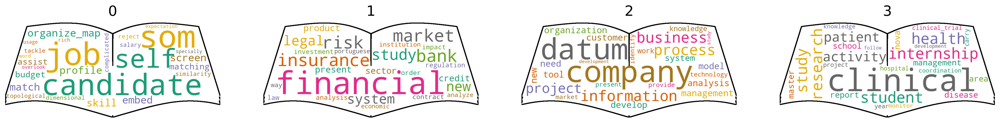

In [14]:
plot_word_cloud_topics(topics_df, "Terms per Topic", "Topic_names")

In [68]:
def plot_word_cloud_topics(data_frame, Topic_Terms_column, Topic_name_column):
    
    # D Import image to np array
    mask = np.array(Image.open('29822.png'))
    
    # E generate wordcloud
    wc = WordCloud(width = 400, height = 300,background_color="white", colormap="Dark2",contour_color='black',
               max_font_size=150, random_state=42, contour_width=8,collocations=True, mask=mask, relative_scaling=0.5)
    
        # Create subplots for each topic
    plt.figure(figsize=(25,25),dpi=400)
    for i in tqdm(list(range(4,8))):

        wc.generate(text=data_frame[Topic_Terms_column][i])

        plt.subplot(4, 8,i+1)
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(data_frame.index[i], fontsize=14)
        plt.savefig(os.path.join("{}.png".format(i)),figsize=(30, 25), dpi=500)

    plt.show()

  0%|          | 0/4 [00:00<?, ?it/s]

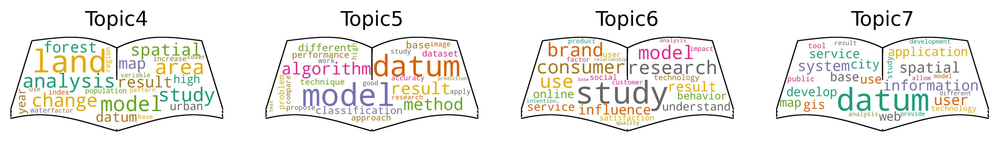

In [69]:
plot_word_cloud_topics(topics_df, "Terms per Topic", "Topic_names")

** **
#### 3.5.5 Analysing Topics by Specialization
[Back to TOC](#toc)
** **
The function below plots the topic distribuiton over years per specualization.

In [16]:

list_topics_lda=["Self organizing maps",
 'Risk/Bank/Insurance/Investiments/Markets/Law',
 'Business/Customers/Companies/Management/Technology',
 'Health//Management/Education',
 'Land_cover/Maps/Urbanism/Population/Environmental',
 'Machine_learning_algorithms',
 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
 'GIS/Spatial/Smart_cities/Maps/Technology', 'Specialization_retificado',
 'year_thesis']


In [17]:
list_topics_lda

['Self organizing maps',
 'Risk/Bank/Insurance/Investiments/Markets/Law',
 'Business/Customers/Companies/Management/Technology',
 'Health//Management/Education',
 'Land_cover/Maps/Urbanism/Population/Environmental',
 'Machine_learning_algorithms',
 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
 'GIS/Spatial/Smart_cities/Maps/Technology',
 'Specialization_retificado',
 'year_thesis']

In [19]:
avg_topics_specia=df_thesis_topics.filter(list_topics_lda).fillna(0).groupby(['Specialization_retificado', "year_thesis"], as_index=False).mean()#.fillna(0)
avg_topics_specia.columns#["Specialization_retificado"].value_counts()

Index(['Specialization_retificado', 'year_thesis', 'Self organizing maps',
       'Risk/Bank/Insurance/Investiments/Markets/Law',
       'Business/Customers/Companies/Management/Technology',
       'Health//Management/Education',
       'Land_cover/Maps/Urbanism/Population/Environmental',
       'Machine_learning_algorithms',
       'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
       'GIS/Spatial/Smart_cities/Maps/Technology'],
      dtype='object')

In [20]:
GIS_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Geographic Information Systems and Science"]
Geospatial_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Geospatial Technologies"]
IAM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Information Analysis and Management"]#.fillna(0)
KMBI_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Knowledge Management and Business Intelligence"]
ISTM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Information Systems and Technologies Management"]
MI_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Marketing Intelligence"]
MRCRM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Marketing Research and CRM"]
RAM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Risk Analysis and Management"]
SIM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Statistics and Information Management"]
DSAA_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Data Science and Advanced Analytics"]
LFM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Law and Financial Markets"]
CRM_avg_topics_year=avg_topics_specia[avg_topics_specia["Specialization_retificado"]=="Clinical Research Management"]

In [44]:
import plotly.graph_objects as go

# Initialize figure with subplots

fig2 = make_subplots(
    rows=2, cols=2, subplot_titles=("Geographic Information Systems and Science",\
                                    "Risk Analysis and Management",\
                                    "Knowledge Management and Business Intelligence",\
                                    "Data Science and Advanced Analytics"\
                                    )
)

# Geographic Information Systems and Science plot

# Plotting the thesis by type and over the years
years = [  "2007", "2008", "2009", "2010","2011","2012","2013", "2014", "2015",\
         "2016", "2017", "2018","2019", "2020","2021"]



fig2.add_trace(go.Bar(x= GIS_avg_topics_year['year_thesis'],\
                          y = GIS_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= GIS_avg_topics_year['year_thesis'], y = GIS_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=1, col=1)

######################################################################################################################################################

# Risk Analysis and Management plot
fig2.add_trace(go.Bar(x= RAM_avg_topics_year['year_thesis'],\
                          y = RAM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          #mode = 'lines',\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology', 
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= RAM_avg_topics_year['year_thesis'], y = RAM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=1, col=2)

######################################################################################################################################################

# Knowledge Management and Business Intelligence plot

fig2.add_trace(go.Bar(x= KMBI_avg_topics_year['year_thesis'],\
                          y = KMBI_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology', 
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental', 
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= KMBI_avg_topics_year['year_thesis'], y = KMBI_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=2, col=1)

######################################################################################################################################################

# Data Science and Advanced Analytics plot

fig2.add_trace(go.Bar(x= DSAA_avg_topics_year['year_thesis'],\
                          y = DSAA_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental', 
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= DSAA_avg_topics_year['year_thesis'], y = DSAA_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=2, col=2)


######################################################################################################################################################

# Change grid color and axis colors
fig2.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig2.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig2.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
fig2.update_layout(showlegend=False)
fig2.update_annotations(font=dict( size=16))

# legend of the graph
fig2.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=10,color="black")))

fig2.update_xaxes(tickangle=90,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),#family='Verdana',
     tickfont=dict( color='black', size=12))#family='Calibri',

fig2.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=12))#family='Calibri'
fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=1, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=1, col=2)
fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=2, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=2, col=2)

# Change the bar mode
fig2.update_layout(barmode='stack')
fig2.show()

pio.write_image(fig2, 'avg_topics_by_Specia_lda_1.png', format='png', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(fig2, 'avg_topics_by_Specia_lda_1.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")


In [48]:
import plotly.graph_objects as go

# Initialize figure with subplots

fig2 = make_subplots(
    rows=2, cols=2, subplot_titles=("Information Analysis and Management",\
                                    "Information Systems and Technologies Management",
                                    "Marketing Intelligence",\
                                    "Marketing Research and CRM"
                                    )
)

# Information Analysis and Managementplot

fig2.add_trace(go.Bar(x= IAM_avg_topics_year['year_thesis'],\
                          y = IAM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict(color='#fdc086'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms', 
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year['year_thesis'], y = IAM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology', 
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=1, col=1)

######################################################################################################################################################

# Information Systems and Technologies Management plot

fig2.add_trace(go.Bar(x= ISTM_avg_topics_year['year_thesis'],\
                          y = ISTM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands', 
     marker=dict(color='#bf5b17'),legendgroup='group1',\
     ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year['year_thesis'], y = ISTM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict(color='#666666'), legendgroup='group1',\
     ),row=1, col=2)

######################################################################################################################################################

# Marketing Intelligence plot

fig2.add_trace(go.Bar(x= MI_avg_topics_year['year_thesis'],\
                          y = MI_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     line=dict( color='#fdc086'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms', 
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= MI_avg_topics_year['year_thesis'], y = MI_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=2, col=1)

######################################################################################################################################################

# Marketing Research and CRM plot

fig2.add_trace(go.Bar(x= MRCRM_avg_topics_year['year_thesis'],\
                          y = MRCRM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict( color='#fdc086'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict( color='#ffff99'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict( color='#386cb0'), legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict( color='#f0027f'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict( color='#bf5b17'),legendgroup='group1',\
     ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year['year_thesis'], y = MRCRM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict( color='#666666'), legendgroup='group1',\
     ),row=2, col=2)

######################################################################################################################################################

# Change grid color and axis colors
fig2.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig2.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig2.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
fig2.update_layout(showlegend=False)
fig2.update_annotations(font=dict( size=16))

# legend of the graph
fig2.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))

fig2.update_xaxes(tickangle=90,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),
     tickfont=dict( color='black', size=12))

fig2.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),
     tickfont=dict(color='black', size=14))

fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=1, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=1, col=2)
fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=2, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=2, col=2)


# Change the bar mode
fig2.update_layout(barmode='stack')
fig2.show()

pio.write_image(fig2, 'avg_topics_by_Specia_lda_2.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(fig2, 'avg_topics_by_Specia_lda_2.png', format='png', width=950, height=550, scale=20, engine="kaleido")

fig2.show()

In [63]:
import plotly.graph_objects as go

# Initialize figure with subplots

fig2 = make_subplots(
    rows=2, cols=2, subplot_titles=("Geospatial Technologies",\
                                    "Statistics and Information Management",\
                                   "Law and Financial Markets",\
                                    "Clinical Research Management"
                                    )
)


# Geospatial Technologies plot

fig2.add_trace(go.Bar(x= Geospatial_avg_topics_year['year_thesis'],\
                          y = Geospatial_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict( color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict(color='#fdc086'),legendgroup='group1',\
          ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict(color='#ffff99'), legendgroup='group1',\
             ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict(color='#386cb0'), legendgroup='group1',\
             ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict(color='#f0027f'),legendgroup='group1',\
     ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict(color='#bf5b17'),legendgroup='group1',\
            ),row=1, col=1)

fig2.add_trace(go.Bar(
     x= Geospatial_avg_topics_year['year_thesis'], y = Geospatial_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology', 
     marker=dict(color='#666666'), legendgroup='group1',\
         ),row=1, col=1)

######################################################################################################################################################

# Statistics and Information Management plot

fig2.add_trace(go.Bar(x= SIM_avg_topics_year['year_thesis'],\
                          y = SIM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict(color='#7fc97f'), legendgroup='group1',\
                          ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict(color='#fdc086'),legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict(color='#ffff99'), legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict(color='#386cb0'), legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict(color='#f0027f'),legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict(color='#bf5b17'),legendgroup='group1',\
             ),row=1, col=2)

fig2.add_trace(go.Bar(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict(color='#666666'), legendgroup='group1',\
             ),row=1, col=2)

######################################################################################################################################################

# Law and Financial Markets plot

fig2.add_trace(go.Bar(x= LFM_avg_topics_year['year_thesis'],\
                          y = LFM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict(color='#7fc97f'), legendgroup='group1',\
                                  ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
     ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict(color='#fdc086'),legendgroup='group1',\
             ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict(color='#ffff99'), legendgroup='group1',\
                 ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental', 
     marker=dict(color='#386cb0'), legendgroup='group1',\
             ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict(color='#f0027f'),legendgroup='group1',\
             ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
     marker=dict(color='#bf5b17'),legendgroup='group1',\
             ),row=2, col=1)

fig2.add_trace(go.Bar(
     x= LFM_avg_topics_year['year_thesis'], y = LFM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict(color='#666666'), legendgroup='group1',\
             ),row=2, col=1)

######################################################################################################################################################

# Clinical Research Management plot

fig2.add_trace(go.Bar(x= CRM_avg_topics_year['year_thesis'],\
                          y = CRM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          marker=dict(color='#7fc97f'), legendgroup='group1',\
                              ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     marker=dict(color='#beaed4'), legendgroup='group1',\
             ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     marker=dict(color='#fdc086'),legendgroup='group1',\
             ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     marker=dict(color='#ffff99'), legendgroup='group1',\
         ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     marker=dict(color='#386cb0'), legendgroup='group1',\
             ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     marker=dict(color='#f0027f'),legendgroup='group1',\
             ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behavior/Marketing/Products/Brands', 
     marker=dict(color='#bf5b17'),legendgroup='group1',\
             ),row=2, col=2)

fig2.add_trace(go.Bar(
     x= CRM_avg_topics_year['year_thesis'], y = CRM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     marker=dict(color='#666666'), legendgroup='group1',\
                ),row=2, col=2)

######################################################################################################################################################

# Change grid color and axis colors
fig2.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig2.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig2.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
fig2.update_layout(showlegend=False)
fig2.update_annotations(font=dict( size=16))

# legend of the graph
fig2.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))

fig2.update_xaxes(tickangle=0,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),
     tickfont=dict( color='black', size=14))

fig2.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),
     tickfont=dict(color='black', size=14))

fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=1, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=1, col=2)
fig2.update_yaxes(title_text="Average topic weight", range=[0, 1.0], row=2, col=1)
fig2.update_yaxes(title_text="", range=[0, 1.0], row=2, col=2)



# Change the bar mode
fig2.update_layout(barmode='stack')

pio.write_image(fig2, 'avg_topics_by_Specia_lda_3.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(fig2, 'avg_topics_by_Specia_lda_3.png', format='png', width=950, height=550, scale=20, engine="kaleido")

fig2.show()

### Legend

In [35]:
import plotly.graph_objects as go

# Initialize figure with subplots

fig3 = go.Figure()

# Statistics and Information Management plot

fig3.add_trace(go.Scatter(x= SIM_avg_topics_year['year_thesis'],\
                          y = SIM_avg_topics_year["Self organizing maps"],\
                          name = "Self organizing maps",\
                          mode = 'lines',\
                          line=dict(width=0.5, color='#7fc97f'), legendgroup='group1',\
                          stackgroup = 'one'))
#2
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Risk/Bank/Insurance/Investiments/Markets/Law'],
     name = 'Risk/Bank/Insurance/Investiments/Markets/Law',
     mode = 'lines',
     line=dict(width=0.5,color='#beaed4'), legendgroup='group1',\
     stackgroup = 'one'))
#3
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Business/Customers/Companies/Management/Technology'],
     name = 'Business/Customers/Companies/Management/Technology',
     mode = 'lines', 
     line=dict(width=0.5, color='#fdc086'),legendgroup='group1',\
     stackgroup = 'one'))
#4
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Health//Management/Education'],
     name = 'Health//Management/Education',
     mode = 'lines', 
     line=dict(width=0.5, color='#ffff99'), legendgroup='group1',\
     stackgroup = 'one'))
#5
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Land_cover/Maps/Urbanism/Population/Environmental'],
     name = 'Land_cover/Maps/Urbanism/Population/Environmental',
     mode = 'lines', 
     line=dict(width=0.5, color='#386cb0'), legendgroup='group1',\
     stackgroup = 'one'))
#6
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Machine_learning_algorithms'],
     name = 'Machine_learning_algorithms',
     mode = 'lines', 
     line=dict(width=0.5, color='#f0027f'),legendgroup='group1',\
     stackgroup = 'one'))
#7
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['Customer_satisfaction_&_behavior/Marketing/Products/Brands'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Products/Brands',
     mode = 'lines', 
     line=dict(width=0.5, color='#bf5b17'),legendgroup='group1',\
     stackgroup = 'one'))
#8
fig3.add_trace(go.Scatter(
     x= SIM_avg_topics_year['year_thesis'], y = SIM_avg_topics_year['GIS/Spatial/Smart_cities/Maps/Technology'],
     name = 'GIS/Spatial/Smart_cities/Maps/Technology',
     mode = 'lines', 
     line=dict(width=0.5, color='#666666'), legendgroup='group1',\
     stackgroup = 'one'))

# ######################################################################################################################################################

# Change grid color and axis colors
fig3.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig3.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig3.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
fig3.update_layout(showlegend=True)
fig3.update_annotations(font=dict( size=12))

# legend of the graph
fig3.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.0,xanchor="right",x=0, 
                              font=dict(size=16,color="black")))

fig3.update_xaxes(
     title_text = 'Year',
     title_font=dict(size=12,  color='black'),
     tickfont=dict( color='black', size=13))

fig3.update_yaxes(
     title_text = "Sales (MM)", range = (0,3.5),
     title_font=dict(size=12, color='black'),
     tickfont=dict(color='black', size=12))

fig3.update_yaxes(title_text="Years", range=[0, 1])
pio.write_image(fig3, 'avg_topics_by_Specia_lda_legenda.pdf', format='pdf', width=950, height=900, scale=15, engine="kaleido")

fig3.show()

** **
# <font color='#E8800A'>IV. BERTopic</font> <a class="anchor" id="ffourth-bullet"></a>
[Back to TOC](#toc)
** ** 

### Step 1 - Sentence Representation

In [36]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.cm as cm
from sentence_transformers import SentenceTransformer
from IPython.display import Markdown, display

In [37]:
import random
from functools import partial
import os
from itertools import compress

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import hdbscan
import umap
import tensorflow as tf
import tensorflow_hub as hub
from sentence_transformers import SentenceTransformer
from sklearn.metrics.cluster import normalized_mutual_info_score
from sklearn.metrics.cluster import adjusted_rand_score
from tqdm.notebook import trange
from hyperopt import fmin, tpe, hp, STATUS_OK, space_eval, Trials

pd.set_option("display.max_rows", 600)
pd.set_option("display.max_columns", 500)
pd.set_option("max_colwidth", 400)

In [38]:
import os
from itertools import compress
import re
import string
import numpy as np

from sklearn.datasets import fetch_20newsgroups
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
from bertopic import BERTopic
from umap import UMAP
from hdbscan import HDBSCAN
from sentence_transformers import SentenceTransformer

In [41]:
df["Abstract_en"]

0       Smarts cities are becoming an important concept in the cities, it tries to discover methods to interact with the environment in sustainable ways inside urban areas. This concept emerged to deal with the growing urbanization faced by the cities around the globe. Within problems brought by the urbanization, waste management is one of the hardest and most impactful. The collection stage of the wa...
1       This research aims to provide a better understanding on how firms stimulate knowledge sharing through the utilization of collaboration tools, in particular Emergent Social Software Platforms (ESSPs). It focuses on the distinctive applications of ESSPs and on the initiatives contributing to maximize its advantages. \nIn the first part of the research, I have itemized all types of existing colla...
2       Forecastng tme series on fnancial markets is regarded as a challenging task. Predictng the\nmovement and directon of the series may be more proftable than the price forecast, b

### BERTopic Preprocessing

In [42]:
#Cleaning the data
re_url = re.compile(r'(?:http|ftp|https)://(?:[\w_-]+(?:(?:\.[\w_-]+)+))(?:[\w.,@?^=%&:/~+#-]*[\w@?^=%&/~+#-])?')
re_email = re.compile('(?:[a-z0-9!#$%&\'*+/=?^_`{|}~-]+(?:\.[a-z0-9!#$%&\'*+/=?^_`{|}~-]+)*|"(?:[\x01-\x08\x0b\x0c\x0e-\x1f\x21\x23-\x5b\x5d-\x7f]|\\[\x01-\x09\x0b\x0c\x0e-\x7f])*")@(?:(?:[a-z0-9](?:[a-z0-9-]*[a-z0-9])?\.)+[a-z0-9](?:[a-z0-9-]*[a-z0-9])?|\[(?:(?:(2(5[0-5]|[0-4][0-9])|1[0-9][0-9]|[1-9]?[0-9]))\.){3}(?:(2(5[0-5]|[0-4][0-9])|1[0-9][0-9]|[1-9]?[0-9])|[a-z0-9-]*[a-z0-9]:(?:[\x01-\x08\x0b\x0c\x0e-\x1f\x21-\x5a\x53-\x7f]|\\[\x01-\x09\x0b\x0c\x0e-\x7f])+)\])')


def clean_text(text):        
    text = text.lower()
    text = text.strip()
    text = re.sub(re_url, '', text)
    text = re.sub(re_email, '', text)
    text = re.sub(f'[{re.escape(string.punctuation)}]', '', text)
    text = re.sub(r'(\d+)', ' ', text)
    text = re.sub(r'(\s+)', ' ', text)  
    return text


# Clean text
abs_clean = list(map(clean_text, df["Abstract_en"]))
print(len(abs_clean))

# Remove blank documents
doc_ids = [len(doc) > 2 for doc in abs_clean]
abs_clean = list(compress(abs_clean, doc_ids))

print(len(abs_clean))

# Remove documents with 4 words or less
doc_ids = [len(doc.split(' ')) > 4 for doc in abs_clean]
abs_clean = list(compress(abs_clean, doc_ids))

print(len(abs_clean))

# Remove outliers (in embedding space)
doc_ids = ['the most current orbital' not in doc for doc in abs_clean]
abs_clean = list(compress(abs_clean, doc_ids))

print(len(abs_clean))

1352
1352
1352
1352


In [43]:
from octis.evaluation_metrics.diversity_metrics import TopicDiversity, InvertedRBO
from octis.evaluation_metrics.coherence_metrics import Coherence, WECoherencePairwise

In [ ]:
# select the embeddings to use
list_transformer_test=['all-mpnet-base-v2']#, 'all-MiniLM-L6-v2']

In [ ]:
# Function to creat embeddings
embeddings_file = 'embeddings.npy'
def models_to_train(list_transformer, sentences):
    
    
    list_embeddings=[]
    name_embeddings=[]
    for i in tqdm(range(len(list_transformer))):
        a=str(list_transformer_test[i])
        b=SentenceTransformer(list_transformer[i]).encode(sentences, show_progress_bar=True)
        list_embeddings.append(b)
        name_embeddings.append(a)
        
        # Save the SBERT embeddings to disk
        np.save(embeddings_file, list_embeddings)
    return list_embeddings, name_embeddings

In [ ]:
list_transformer_np_array, list_transformer_names =models_to_train(list_transformer_test, abs_clean)

In [ ]:
# Function to Provide a topic model score
def topic_evaluation(model_output, texts):
    """
    Provide a topic model output and get the score on several metrics.
    """
    output = {}

    # Topic Coherence - internal
    metric = Coherence(texts=texts, topk=25, measure='c_v')
    output['topic_coherence_c_v'] = metric.score(model_output)
    return output

In [ ]:
# bert pipeline
def bert_train(list_transformer, embedd_transformer_names, clean_corpus, step_topics_size, step_n_neighbors, step_n_components,\
                    step_min_cluster_size, step_min_min_samples ):
    
    

    
    
    # creating dictionary to save the results
    bert_train_results = {'embeddings_name':[], # embeddings to use
                           'Num_Topics': [], # Numbember of topics
                           'n_neighbors': [], # int, UMAP hyperparameter n_neighbors
                           'n_components': [], # int, UMAP hyperparameter n_components
                           'min_cluster_size': [], # int, HDBSCAN hyperparameter min_cluster_size
                           'min_samples': [], # int, HDBSCAN hyperparameter min_samples
                           'cluster_selection_method': [], # string, HDBSCAN hyperparameter method used to select clusters
                           'topic_coherence_c_v': [] # float, topic coherence result
                           }
    # embeddings list
    list_embeddings=list_transformer
    
    # embeddings name list
    name_embeddings=embedd_transformer_names
    
    # Topics range
    topics_range =  list(np.arange(4, 22, step_topics_size))
    
    # UMAP hyperparameter n_neighbors
    n_neighbors = list(np.arange(5, 30, step_n_neighbors))

    # UMAP hyperparameter n_components
    n_components = list(np.arange(5, 30, step_n_components))
    
    # HDBSCAN hyperparameter min_cluster_size
    min_cluster_size = list(np.arange(5, 30, step_min_cluster_size))
    
    # HDBSCAN hyperparameter min_samples
    min_samples = list(np.arange(5, 30, step_min_min_samples))
    
    # HDBSCAN hyperparameter method used to select clusters
    cluster_selection_method = ['eom']


    
    if 1 == 1:
        pbar = tqdm(total=len(list_embeddings)*len(topics_range)*len(n_neighbors)*\
             len(n_components)*len(min_cluster_size)*len(min_samples)*len(cluster_selection_method))
    
        for i in range(len(list_embeddings)):
            embed_name=str(embedd_transformer_names[i]) # Name of the transformer used
    #        encoding_embeddings=SentenceTransformer(list_embeddings[i]).encode(sentences, show_progress_bar=True) # Encoding

            # iterate through number of topics
            for topics_range_ in topics_range:
                print(topics_range_)

                # iterate through the n neighbors
                for n_neighbors_ in n_neighbors:
                    #print(n_neighbors_)

                    # iterate through the n components
                    for n_components_ in n_components:
                        #print(n_components_)

                        # iterate through the min_cluster_size
                        for min_cluster_size_ in min_cluster_size:
                            #print(min_cluster_size_)

                            # iterate through the min_samples
                            for min_samples_ in min_samples:
                                #print(min_samples_)

                                # iterate through the cluster_selection_method
                                for cluster_selection_method_ in cluster_selection_method:
                                    #print(cluster_selection_method_)

                                    # Declaring the umap model
                                    umap_model =(umap.UMAP(n_neighbors = n_neighbors_, n_components = n_components_,\
                                    min_dist=0.1, metric = 'cosine',random_state=1))

                                    # Declaring the Vectorizer model
                                    vectorizer_model = CountVectorizer(ngram_range=(1, 1),stop_words="english")

                                    # Declaring the n_gram_range
                                    n_gram_range_ = (1, 1)

                                    # Declaring the hdbscan model
                                    hdbscan_model = hdbscan.HDBSCAN(min_cluster_size = int(min_cluster_size_),\
                                                                    min_samples = int(min_samples_), metric='euclidean',\
                                                                    gen_min_span_tree=True,\
                                                                    cluster_selection_method=cluster_selection_method_ )


                                    # Declaring the model
                                    model = BERTopic(verbose=True, top_n_words=25,
                                        n_gram_range=n_gram_range_,
                                        nr_topics=int(topics_range_),
                                        #embedding_model="SentenceTransformers",
                                        umap_model=umap_model,
                                        hdbscan_model=hdbscan_model,
                                        vectorizer_model=vectorizer_model)

                                    # Train the BERTopic model
                                    doc_topics, _ = model.fit_transform(clean_corpus, embeddings=list_embeddings[i])


                                    # Get topic diversity for topic coherence metrics
                                    model_output = {
                                        'topics': [[word[0] for word in values] for _, values in model.topics.items()],
                                        'topic-word-matrix': model.c_tf_idf,
                                        'topic-document-matrix': np.array(doc_topics)
                                    }


                                    # Calculating topic coherence 
                                    topic_coherence_c_v=topic_evaluation(model_output,\
                                                                         list(map(lambda x: x.split(' '), clean_corpus)))
                                    #print(topic_coherence_c_v.values())

                                    bert_train_results['embeddings_name'].append(embed_name)
                                    bert_train_results['Num_Topics'].append(topics_range_)
                                    bert_train_results['n_neighbors'].append(n_neighbors_)
                                    bert_train_results['n_components'].append(n_components_)
                                    bert_train_results['min_cluster_size'].append(min_cluster_size_)
                                    bert_train_results['min_samples'].append(min_samples_)
                                    bert_train_results['cluster_selection_method'].append(cluster_selection_method_)
                                    bert_train_results['topic_coherence_c_v'].append(list(topic_coherence_c_v.values())[0])
                                    pbar.update(1)
                           
                                
    bert_train_results_df= pd.DataFrame(bert_train_results)
    bert_train_results_df= bert_train_results_df.sort_values("topic_coherence_c_v", ascending=False)
    pbar.close()
    
    fig = px.scatter(bert_train_results_df, x="Num_Topics", y='topic_coherence_c_v',  size="topic_coherence_c_v")
    fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1))
    fig.show()
    
    print("The best 10 parameter to choose are:")
    print(bert_train_results_df.head(10))
    
    bert_train_results_df.to_csv('bert_tuning_results.csv', index=False)
    return bert_train_results_df

In [ ]:
bert_train_results_df=bert_train(list_transformer_np_array, list_transformer_names, abs_clean,2,5,5,5,5)

In [112]:
bert_train_results_df =pd.read_csv('bert_tuning_results.csv')

In [113]:
bert_train_results_df

,embeddings_name,Num_Topics,n_neighbors,n_components,min_cluster_size,min_samples,cluster_selection_method,topic_coherence_c_v
0,all-mpnet-base-v2,8,20,10,10,15,eom,0.510521
1,all-mpnet-base-v2,8,10,5,5,5,eom,0.506282
2,all-mpnet-base-v2,10,25,15,10,10,eom,0.501997
3,all-mpnet-base-v2,18,25,5,10,15,eom,0.498601
4,all-mpnet-base-v2,14,25,5,15,15,eom,0.498601
...,...,...,...,...,...,...,...,...
5620,all-mpnet-base-v2,16,10,25,10,10,eom,0.251411
5621,all-mpnet-base-v2,18,10,10,5,10,eom,0.251411
5622,all-mpnet-base-v2,20,10,10,5,10,eom,0.251411
5623,all-mpnet-base-v2,18,10,10,10,10,eom,0.251411


In [65]:
# Ploting Topic Coherence Cv_bertopic

fig = px.scatter(bert_train_results_df, x="Num_Topics", y='topic_coherence_c_v',  size='topic_coherence_c_v', size_max=15,
        ).update_traces(marker=dict(color="rgb(0,116,217)"))

# legend of the graph
fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))


# yxaxis legend size and color
fig.update_xaxes(tickangle=0, tickfont=dict(size=14,color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(size=14,color="black"))

fig.update_layout(
   
    xaxis_title="Number of topics",
    yaxis_title="Topic Coherence Cv",
    
    font=dict(
        #family="Courier New, monospace",
        size=14,
        color="black"
    )
)


fig.update_xaxes(
    showgrid=True,
    ticks="outside",
    tickson="boundaries",
    ticklen=0
)

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

fig.add_annotation(x=8, y=0.520521,
            text="n_neig=20; n_comp=10 ;min_clu=10 ;min_sam=15 ; clu_sel=eom; Cv= 0.510521",
            showarrow=True,
            arrowhead=2,
          )



# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

fig.show()

pio.write_image(fig, 'Topic Coherence Cv_bertopic.png', format='png', width=850, height=450, scale=20, engine="kaleido")

In [57]:
model = SentenceTransformer('all-mpnet-base-v2')

In [44]:
model = SentenceTransformer('msmarco-distilbert-base-v4')

In [58]:
embeddings_=model.encode(abs_clean, show_progress_bar=True)

Batches:   0%|          | 0/43 [00:00<?, ?it/s]

In [59]:
# Declaring the umap model
umap_final_model =(umap.UMAP(n_neighbors = 20, n_components = 10,\
min_dist=0.1, metric = 'cosine',random_state=1))

In [60]:
# Declaring the Vectorizer model
vectorizer_final_model = CountVectorizer(ngram_range=(1, 1),stop_words="english")

In [61]:
# Declaring the n_gram_range
n_gram_range_final = (1, 1)

In [62]:
# Declaring the hdbscan model
hdbscan_final_model = hdbscan.HDBSCAN(min_cluster_size = int(10),\
min_samples = int(15), metric='euclidean',\
gen_min_span_tree=True,\
cluster_selection_method="eom",
prediction_data=True)


# Declaring the model
final_model = BERTopic(verbose=True, top_n_words=25, n_gram_range=n_gram_range_final, nr_topics=int(8), umap_model=umap_final_model,\
                       hdbscan_model=hdbscan_final_model, vectorizer_model=vectorizer_final_model, calculate_probabilities=True)

# Train the BERTopic model
doc_topics, probabi = final_model.fit_transform(abs_clean, embeddings_)


2022-06-17 08:54:30,341 - BERTopic - Reduced dimensionality with UMAP
2022-06-17 08:54:30,484 - BERTopic - Clustered UMAP embeddings with HDBSCAN
2022-06-17 08:54:31,693 - BERTopic - Reduced number of topics from 11 to 9


In [50]:
x_bert["dominant_topic"] = list(doc_topics)

NameError: name 'x_bert' is not defined

In [70]:
final_model.visualize_hierarchy()

In [72]:
final_model.get_topic_info()

,Topic,Count,Name
0,0,540,0_data_information_spatial_land
1,-1,345,-1_data_results_study_model
2,1,170,1_business_information_management_data
3,2,110,2_financial_risk_insurance_banks
4,3,88,3_satisfaction_consumers_customer_study
5,4,30,4_intention_technology_use_acceptance
6,5,26,5_customers_models_model_campaign
7,6,22,6_gp_genetic_gsgp_algorithm
8,7,21,7_clinical_internship_research_trials


In [79]:
Topic_names_bert={
    "Topic 0": "Land_cover/GIS/Geospatial/Maps/Urbanism/Cities",
    "Topic 1": "Business_Intelligence_&_Process/Knowledge_Management/Organizations",
    "Topic 2": "Risk/Insurance/Banks/Markets/Financial/Law",
    "Topic 3": "Customer_satisfaction_&_behaviour/Marketing/Brands/Products",
    "Topic 4": "Predictive_marketing/ICT/UTAUT/Online_usage",
    "Topic 5": "Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing",
    "Topic 6": "GA/GP/GSGP/Machine_learning_algorithms",
    "Topic 7": "Health/Management/Education",
}

In [ ]:
pd.DataFrame(final_model.get_topics()[7])[0]

# Creating a dictionary with name of the topics

In [82]:
Topic_top_words_Bert=pd.DataFrame()
Topic_top_words_Bert["Land_cover/GIS/Maps/Urbanism"]=pd.DataFrame(final_model.get_topics()[0])[0]#.get_representative_docs()
Topic_top_words_Bert["Business_Intelligence/Business_Process/Knowledge_Management"]=pd.DataFrame(final_model.get_topics()[1])[0]
Topic_top_words_Bert["Risk/Insurance/Banks/Market/Financial/Law"]=pd.DataFrame(final_model.get_topics()[2])[0]
Topic_top_words_Bert["Satisfaction/Customers/Marketing/Brands/Products/Digitalization"]=pd.DataFrame(final_model.get_topics()[3])[0]
Topic_top_words_Bert["Predictive marketing/ICT/UTAUT/Satisfaction/Models/Online_services/Apps"]=pd.DataFrame(final_model.get_topics()[4])[0]
Topic_top_words_Bert["Machine_learning_algorithms/Data_mining/Customers/Insunrance/Business/Marketing"]=pd.DataFrame(final_model.get_topics()[5])[0]
Topic_top_words_Bert["Genetic_Algorithm_&_Programing/GSGP/Machine_learning_algorithms"]=pd.DataFrame(final_model.get_topics()[6])[0]
Topic_top_words_Bert["Clinical_research_&_trial/Management/Education"]=pd.DataFrame(final_model.get_topics()[7])[0]

In [83]:
Topic_top_words_Bert=pd.DataFrame()
Topic_top_words_Bert["Topic0"]=pd.DataFrame(final_model.get_topics()[0])[0]#.get_representative_docs()
Topic_top_words_Bert["Topic1"]=pd.DataFrame(final_model.get_topics()[1])[0]
Topic_top_words_Bert["Topic2"]=pd.DataFrame(final_model.get_topics()[2])[0]
Topic_top_words_Bert["Topic3"]=pd.DataFrame(final_model.get_topics()[3])[0]
Topic_top_words_Bert["Topic4"]=pd.DataFrame(final_model.get_topics()[4])[0]
Topic_top_words_Bert["Topic5"]=pd.DataFrame(final_model.get_topics()[5])[0]
Topic_top_words_Bert["Topic6"]=pd.DataFrame(final_model.get_topics()[6])[0]
Topic_top_words_Bert["Topic7"]=pd.DataFrame(final_model.get_topics()[7])[0]

In [77]:
Topic_top_words_Bert[["Topic0","Topic1","Topic2","Topic3"]]

,Topic0,Topic1,Topic2,Topic3
0,data,business,financial,satisfaction
1,information,information,risk,consumers
2,spatial,management,insurance,customer
3,land,data,banks,study
4,study,organizations,operational,online
5,analysis,project,market,marketing
6,using,knowledge,credit,consumer
7,use,organization,study,loyalty
8,used,systems,banking,research
9,results,processes,portuguese,brand


In [78]:
def plot_word_cloud_topics_Bert(data_frame):
    
    # D Import image to np array
    mask = np.array(Image.open('29822.png'))
    
    # E generate wordcloud
    wc = WordCloud(width = 800, height = 600,background_color="white", colormap="Dark2",contour_color='black',
               max_font_size=150, random_state=42, contour_width=8,collocations=True, mask=mask, relative_scaling=0.5)
    
        # Create subplots for each topic
    plt.figure(figsize=(15,25), dpi=400)
    a=list(data_frame.columns)
    for i in tqdm(range(len(a))):

        wc.generate(str(data_frame[a[i]]))
        

        plt.subplot(1, 4, i+1)
        plt.imshow(wc, interpolation="bilinear")
        plt.axis("off")
        plt.title(a[i])
        plt.savefig(("{}.png".format(i)), dpi=500)
        #plt.savefig("{}.png".format(a[i]),figsize=(30, 20), dpi=500)

    plt.show()

  0%|          | 0/4 [00:00<?, ?it/s]

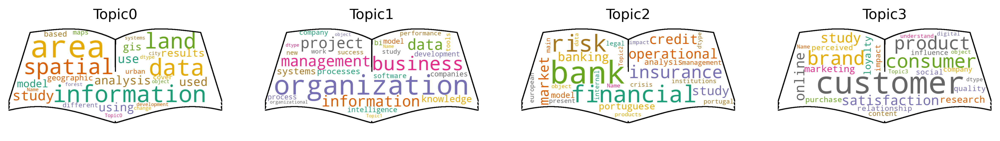

In [79]:
plot_word_cloud_topics_Bert(Topic_top_words_Bert[["Topic0","Topic1","Topic2","Topic3"]])

  0%|          | 0/4 [00:00<?, ?it/s]

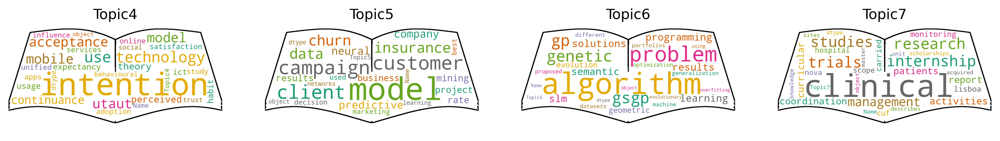

In [80]:
plot_word_cloud_topics_Bert(Topic_top_words_Bert[["Topic4","Topic5","Topic6","Topic7"]])

In [81]:
Name_topics=pd.DataFrame(final_model.get_topic_info())["Name"]#[8]#["name"]
Name_topics

0            0_data_information_spatial_land
1                -1_data_results_study_model
2     1_business_information_management_data
3           2_financial_risk_insurance_banks
4    3_satisfaction_consumers_customer_study
5      4_intention_technology_use_acceptance
6          5_customers_models_model_campaign
7                6_gp_genetic_gsgp_algorithm
8      7_clinical_internship_research_trials
Name: Name, dtype: object

In [85]:
# Getting all topics with respective weights for each document.
df_weights_bert = pd.DataFrame(probabi)
df_weights_bert.columns = ['Topic ' + str(i) for i in list(df_weights_bert.columns)]
df_weights_bert

,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6,Topic 7
0,7.415604e-01,0.029747,2.447685e-02,5.767703e-02,2.739290e-02,3.250338e-02,3.287590e-02,2.453080e-02
1,1.607799e-308,1.000000,1.261451e-308,4.250388e-308,2.450412e-308,1.610609e-308,1.048636e-308,1.402142e-308
2,3.244753e-02,0.035674,3.647429e-02,6.038924e-02,2.466438e-02,8.917103e-02,8.765622e-02,1.669055e-02
3,1.095040e-02,0.009705,1.010990e-02,1.578925e-02,6.918270e-03,1.592113e-02,8.748813e-01,5.908531e-03
4,4.013365e-02,0.097488,4.741822e-02,8.024352e-02,3.434318e-02,1.066126e-01,5.378242e-02,2.533538e-02
...,...,...,...,...,...,...,...,...
1347,1.633959e-02,0.018225,7.253803e-01,3.973967e-02,1.688504e-02,2.888886e-02,1.988187e-02,1.327041e-02
1348,1.789743e-02,0.020190,7.090779e-01,4.346685e-02,1.842365e-02,3.273298e-02,2.208672e-02,1.434278e-02
1349,2.126376e-02,0.023968,6.504578e-01,5.223386e-02,2.204114e-02,3.891481e-02,2.587387e-02,1.674179e-02
1350,1.947276e-02,0.020425,6.354150e-01,4.605025e-02,1.949731e-02,3.203644e-02,2.290657e-02,1.560256e-02


In [ ]:
df_weights_bert.rename(columns={ "Topic 0": "Land_cover/GIS/Geospatial/Maps/Urbanism/Cities",
    "Topic 1": "Business_Intelligence_&_Process/Knowledge_Management/Organizations",
    "Topic 2": "Risk/Insurance/Banks/Markets/Financial/Law",
    "Topic 3": "Customer_satisfaction_&_behaviour/Marketing/Brands/Products",
    "Topic 4": "Predictive_marketing/ICT/UTAUT/Online_usage",
    "Topic 5": "Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing",
    "Topic 6": "GA/GP/GSGP/Machine_learning_algorithms",
    "Topic 7": "Health/Management/Education"},inplace=True)

In [ ]:
# Concatenating original_dataframe, corpus_topic_df and df_weights
x_bert = x.copy()
x_bert = pd.concat([x_bert, df_weights_bert], axis=1)
x_bert.to_csv('x_bert.csv', index=False)
x_bert.head(1)

In [15]:
x_bert= pd.read_csv('x_bert.csv')
x_bert.head(1)

,Column1,thesis_id,collection_id,Nome-apelido,Author_email,Advisor_bom_1,Advisor_bom_2,Advisor_bom_3,Coorientador(es)_bom_3,Date_issued,...,wordcloud_abstract,pre_abstract_trigams,Land_cover/GIS/Geospatial/Maps/Urbanism/Cities,Business_Intelligence_&_Process/Knowledge_Management/Organizations,Risk/Insurance/Banks/Markets/Financial/Law,Customer_satisfaction_&_behaviour/Marketing/Brands/Products,Predictive_marketing/ICT/UTAUT/Online_usage,Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing,GA/GP/GSGP/Machine_learning_algorithms,Health/Management/Education
0,0.0,58592,10362/2160,Evandro da Silva Mendonça,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,20/12/2018,...,smarts cities important concept cities tries d...,"['smart', 'city', 'important', 'concept', 'cit...",0.74156,0.029747,0.024477,0.057677,0.027393,0.032503,0.032876,0.024531


In [76]:
list_topics_bert=["Land_cover/GIS/Geospatial/Maps/Urbanism/Cities",
    "Business_Intelligence_&_Process/Knowledge_Management/Organizations",
    "Risk/Insurance/Banks/Markets/Financial/Law",
    "Customer_satisfaction_&_behaviour/Marketing/Brands/Products",
    "Predictive_marketing/ICT/UTAUT/Online_usage",
    "Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing",
    "GA/GP/GSGP/Machine_learning_algorithms",
    "Health/Management/Education",
  'Specialization_retificado',
  'year_thesis']

In [75]:
list_topics_bert

['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',
 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
 'Risk/Insurance/Banks/Markets/Financial/Law',
 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
 'Predictive_marketing/ICT/UTAUT/Online_usage',
 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
 'GA/GP/GSGP/Machine_learning_algorithms',
 'Health/Management/Education',
 'Specialization_retificado',
 'year_thesis']

In [18]:
avg_topics_specia_bert= x_bert.filter(list_topics_bert).fillna(0).groupby(['Specialization_retificado', 'year_thesis' ], as_index=False).mean()##

In [19]:
GIS_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Geographic Information Systems and Science"]
Geospatial_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Geospatial Technologies"]
IAM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Information Analysis and Management"]#.fillna(0)
KMBI_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Knowledge Management and Business Intelligence"]
ISTM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Information Systems and Technologies Management"]
MI_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Marketing Intelligence"]
MRCRM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Marketing Research and CRM"]
RAM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Risk Analysis and Management"]
SIM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Statistics and Information Management"]
DSAA_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Data Science and Advanced Analytics"]
LFM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Law and Financial Markets"]
CRM_avg_topics_year_bert=avg_topics_specia_bert[avg_topics_specia_bert["Specialization_retificado"]=="Clinical Research Management"]

In [21]:
import plotly.graph_objects as go

# Initialize figure with subplots


bert_fig1 = make_subplots(
    rows=2, cols=2, subplot_titles=("Geographic Information Systems and Science",\
                                    "Risk Analysis and Management",\
                                    "Knowledge Management and Business Intelligence",\
                                    "Data Science and Advanced Analytics"
                                    )
)

# Geographic Information Systems and Science plot

bert_fig1.add_trace(go.Bar(x= GIS_avg_topics_year_bert['year_thesis'],\
                          y = GIS_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products', 
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= GIS_avg_topics_year_bert['year_thesis'], y = GIS_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education', 
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=1)

######################################################################################################################################################

# Risk Analysis and Management plot

bert_fig1.add_trace(go.Bar(x= RAM_avg_topics_year_bert['year_thesis'],\
                          y = RAM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=2)

bert_fig1.add_trace(go.Bar(
     x= RAM_avg_topics_year_bert['year_thesis'], y = RAM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict( color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=2)

######################################################################################################################################################

# Knowledge Management and Business Intelligence plot

bert_fig1.add_trace(go.Bar(x= KMBI_avg_topics_year_bert['year_thesis'],\
                          y = KMBI_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=1)

bert_fig1.add_trace(go.Bar(
     x= KMBI_avg_topics_year_bert['year_thesis'], y = KMBI_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=1)

######################################################################################################################################################
# Data Science and Advanced Analytics plot

# 1 width=0.5,stackgroup = 'one'
bert_fig1.add_trace(go.Bar(x= DSAA_avg_topics_year_bert['year_thesis'],\
                          y = DSAA_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=1)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=2)

bert_fig1.add_trace(go.Bar(
     x= DSAA_avg_topics_year_bert['year_thesis'], y = DSAA_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=2)

#####################################################################################################################################################

# Change grid color and axis colors
bert_fig1.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
bert_fig1.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
bert_fig1.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
bert_fig1.update_layout(showlegend=False)
bert_fig1.update_annotations(font=dict( size=16))

# legend of the graph
bert_fig1.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))

bert_fig1.update_xaxes(tickangle=90,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),
     tickfont=dict( color='black', size=14))

bert_fig1.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),
     tickfont=dict(color='black', size=14))
bert_fig1.update_yaxes(title_text="Average topic weight", range=[0, 1], row=1, col=1)
bert_fig1.update_yaxes(title_text="", range=[0, 1], row=1, col=2)
bert_fig1.update_yaxes(title_text="Average topic weight", range=[0, 1], row=2, col=1)
bert_fig1.update_yaxes(title_text="", range=[0, 1], row=2, col=2)
# Change the bar mode
bert_fig1.update_layout(barmode='stack')

pio.write_image(bert_fig1, 'avg_topics_by_Specia_bert_1.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(bert_fig1, 'avg_topics_by_Specia_bert_1.png', format='png', width=950, height=550, scale=20, engine="kaleido")
bert_fig1.show()

In [33]:
import plotly.graph_objects as go

# Initialize figure with subplots

                                    

bert_fig2 = make_subplots(
    rows=2, cols=2, subplot_titles=("Information Analysis and Management",\
                                    "Information Systems and Technologies Management",\
                                    "Marketing Intelligence",\
                                    "Marketing Research and CRM",\
                                    )
)

# "Information Analysis and Management" plot


# 1
bert_fig2.add_trace(go.Bar(x= IAM_avg_topics_year_bert['year_thesis'],\
                          y = IAM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=1)
#2
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=1)

#3
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=1)

#4
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=1)

#5
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=1)

#6
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing', 
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=1)

#7
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms', 
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=1)

#8
bert_fig2.add_trace(go.Bar(
     x= IAM_avg_topics_year_bert['year_thesis'], y = IAM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=1)

######################################################################################################################################################

# Information Systems and Technologies Management plot

# 1
bert_fig2.add_trace(go.Bar(x= ISTM_avg_topics_year_bert['year_thesis'],\
                          y = ISTM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=2)

#2
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=2)

#3
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=2)

#4
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products', 
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=2)

#5
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=2)

#6
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=2)

#7
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=2)

#8
bert_fig2.add_trace(go.Bar(
     x= ISTM_avg_topics_year_bert['year_thesis'], y = ISTM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=2)

######################################################################################################################################################

# Marketing Intelligence plot

# 1
bert_fig2.add_trace(go.Bar(x= MI_avg_topics_year_bert['year_thesis'],\
                          y = MI_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=1)

#2
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=1)

#3
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=1)

#4
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=1)

#5
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     #mode = 'lines', 
     marker=dict( color='#f781bf'), legendgroup='group1',\
     ),row=2, col=1)

#6
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing', 
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=2, col=1)

#7
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=1)

#8
bert_fig2.add_trace(go.Bar(
     x= MI_avg_topics_year_bert['year_thesis'], y = MI_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=1)

######################################################################################################################################################

# Marketing Research and CRM plot

# 1
bert_fig2.add_trace(go.Bar(x= MRCRM_avg_topics_year_bert['year_thesis'],\
                          y = MRCRM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=2)

#2
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=2)

#3
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     #mode = 'lines', 
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=2)

#4
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=2)

#5
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=2, col=2)

#6
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=2, col=2)

#7
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=2)

#8
bert_fig2.add_trace(go.Bar(
     x= MRCRM_avg_topics_year_bert['year_thesis'], y = MRCRM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=2)
#####################################################################################################################################################

# Change grid color and axis colors
bert_fig2.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
bert_fig2.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
bert_fig2.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
bert_fig2.update_layout(showlegend=False)
bert_fig2.update_annotations(font=dict( size=16))

# legend of the graph
bert_fig2.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))

bert_fig2.update_xaxes(tickangle=90,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),
     tickfont=dict( color='black', size=14))

bert_fig2.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),
     tickfont=dict(color='black', size=14))
bert_fig2.update_yaxes(title_text="Average topic weight", range=[0, 1], row=1, col=1)
bert_fig2.update_yaxes(title_text="", range=[0, 1], row=1, col=2)
bert_fig2.update_yaxes(title_text="Average topic weight", range=[0, 1], row=2, col=1)
bert_fig2.update_yaxes(title_text="", range=[0, 1], row=2, col=2)


# Change the bar mode
bert_fig2.update_layout(barmode='stack')


pio.write_image(bert_fig2, 'avg_topics_by_Specia_bert_2.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(bert_fig2, 'avg_topics_by_Specia_bert_2.png', format='png', width=950, height=550, scale=20, engine="kaleido")




bert_fig2.show()

In [38]:
import plotly.graph_objects as go

# Initialize figure with subplots
  
bert_fig3 = make_subplots(
    rows=2, cols=2, subplot_titles=("Geospatial Technologies",\
                                    "Statistics and Information Management",\
                                   "Law and Financial Markets",\
                                    "Clinical Research Management"
                                    )
)

# Statistics and Information Management plot


# 1
bert_fig3.add_trace(go.Bar(x= Geospatial_avg_topics_year_bert['year_thesis'],\
                          y = Geospatial_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=1)
#2
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=1)

#3
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=1)

#4
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=1)

#5
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=1)

#6
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=1)

#7
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=1)

#8
bert_fig3.add_trace(go.Bar(
     x= Geospatial_avg_topics_year_bert['year_thesis'], y = Geospatial_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=1)

######################################################################################################################################################

# Statistics and Information Management plot

# 1
bert_fig3.add_trace(go.Bar(x= SIM_avg_topics_year_bert['year_thesis'],\
                          y = SIM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          #mode = 'lines',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=1, col=2)
#2
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=1, col=2)

#3
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law', 
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=1, col=2)

#4
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=1, col=2)

#5
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage', 
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=1, col=2)

#6
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=1, col=2)

#7
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=1, col=2)
#8
bert_fig3.add_trace(go.Bar(
     x= SIM_avg_topics_year_bert['year_thesis'], y = SIM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=1, col=2)

######################################################################################################################################################

# Law and Financial Markets plot

# 1
bert_fig3.add_trace(go.Bar(x= LFM_avg_topics_year_bert['year_thesis'],\
                          y = LFM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=1)
#2
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=1)

#3
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=1)

#4
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=1)

#5
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=2, col=1)

#6
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict(color='#ffff33'),legendgroup='group1',\
     ),row=2, col=1)

#7
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=1)

#8
bert_fig3.add_trace(go.Bar(
     x= LFM_avg_topics_year_bert['year_thesis'], y = LFM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=1)

######################################################################################################################################################

# Clinical Research Management plot

# 1
bert_fig3.add_trace(go.Bar(x= CRM_avg_topics_year_bert['year_thesis'],\
                          y = CRM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          marker=dict(color="#e41a1c"), legendgroup='group1',\
                          ),row=2, col=2)

#2
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     marker=dict(color='#377eb8'), legendgroup='group1',\
     ),row=2, col=2)

#3
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     marker=dict(color='#33a02c'),legendgroup='group1',\
     ),row=2, col=2)

#4
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     marker=dict(color='#984ea3'), legendgroup='group1',\
     ),row=2, col=2)

#5
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     marker=dict(color='#f781bf'), legendgroup='group1',\
     ),row=2, col=2)

#6
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     marker=dict( color='#ffff33'),legendgroup='group1',\
     ),row=2, col=2)

#7
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     marker=dict(color='#a65628'),legendgroup='group1',\
     ),row=2, col=2)

#8
bert_fig3.add_trace(go.Bar(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     marker=dict(color='#ff7f00'), legendgroup='group1',\
     ),row=2, col=2)
#####################################################################################################################################################

# Change grid color and axis colors
bert_fig3.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
bert_fig3.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
bert_fig3.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
bert_fig3.update_layout(showlegend=False)
bert_fig3.update_annotations(font=dict( size=16))

# legend of the graph
bert_fig3.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))


bert_fig3.update_xaxes(tickangle=0,
     title_text = 'Years',
     title_font=dict(size=14,  color='black'),
     tickfont=dict( color='black', size=14))

bert_fig3.update_yaxes(
     title_text = "Average topic weight", range = (0,3.5),
     title_font=dict(size=14, color='black'),
     tickfont=dict(color='black', size=14))


bert_fig3.update_yaxes(title_text="Average topic weight", range=[0, 1], row=1, col=1)
bert_fig3.update_yaxes(title_text="", range=[0, 1], row=1, col=2)
bert_fig3.update_yaxes(title_text="Average topic weight", range=[0, 1], row=2, col=1)
bert_fig3.update_yaxes(title_text="", range=[0, 1], row=2, col=2)


# Change the bar mode
bert_fig3.update_layout(barmode='stack')


pio.write_image(bert_fig3, 'avg_topics_by_Specia_bert_3.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(bert_fig3, 'avg_topics_by_Specia_bert_3.png', format='png', width=950, height=550, scale=20, engine="kaleido")
bert_fig3.show()

# Legenda Graphics

In [95]:
import plotly.graph_objects as go

# Initialize figure with subplots

bert_legen_fig3 = make_subplots(
    rows=2, cols=2, subplot_titles=("",\
                                    "",\
                                    "Law and Financial Markets",\
                                    "Clinical Research Management"\
                                    )
)

# Statistics and Information Management plot

# Clinical Research Management plot

# 1
bert_legen_fig3.add_trace(go.Scatter(x= CRM_avg_topics_year_bert['year_thesis'],\
                          y = CRM_avg_topics_year_bert['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities'],\
                          name = 'Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',\
                          mode = 'lines',\
                          line=dict(width=0.5, color="#e41a1c"), legendgroup='group1',\
                          stackgroup = 'one'),row=2, col=2)
#2
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Business_Intelligence_&_Process/Knowledge_Management/Organizations'],
     name = 'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
     mode = 'lines',
     line=dict(width=0.5,color='#377eb8'), legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#3
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Risk/Insurance/Banks/Markets/Financial/Law'],
     name = 'Risk/Insurance/Banks/Markets/Financial/Law',
     mode = 'lines', 
     line=dict(width=0.5, color='#33a02c'),legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#'#4daf4a'
#4
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Customer_satisfaction_&_behaviour/Marketing/Brands/Products'],
     name = 'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
     mode = 'lines', 
     line=dict(width=0.5, color='#984ea3'), legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#5
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Predictive_marketing/ICT/UTAUT/Online_usage'],
     name = 'Predictive_marketing/ICT/UTAUT/Online_usage',
     mode = 'lines', 
     line=dict(width=0.5, color='#f781bf'), legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#6
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing'],
     name = 'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
     mode = 'lines', 
     line=dict(width=0.5, color='#ffff33'),legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#7
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['GA/GP/GSGP/Machine_learning_algorithms'],
     name = 'GA/GP/GSGP/Machine_learning_algorithms',
     mode = 'lines', 
     line=dict(width=0.5, color='#a65628'),legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
#8
bert_legen_fig3.add_trace(go.Scatter(
     x= CRM_avg_topics_year_bert['year_thesis'], y = CRM_avg_topics_year_bert['Health/Management/Education'],
     name = 'Health/Management/Education',
     mode = 'lines', 
     line=dict(width=0.5, color='#ff7f00'), legendgroup='group1',\
     stackgroup = 'one'),row=2, col=2)
######################################################################################################################################################


# ######################################################################################################################################################

# Change grid color and axis colors
bert_legen_fig3.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
bert_legen_fig3.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
bert_legen_fig3.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Hide the legend
bert_legen_fig3.update_layout(showlegend=True)
bert_legen_fig3.update_annotations(font=dict( size=12))

# legend of the graph
bert_legen_fig3.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.0,xanchor="right",x=0, 
                              font=dict(size=16,color="black")))

# fig2.update_layout(
# #      title = "PS4 Global Sales per Region",
#       title_font_size = 40, legend_font_size = 20,
#      width = 1600, height = 1400)

bert_legen_fig3.update_xaxes(
     title_text = 'Year',
     title_font=dict(size=12,  color='black'),
     tickfont=dict( color='black', size=13))

bert_legen_fig3.update_yaxes(
     title_text = "Sales (MM)", range = (0,3.5),
     title_font=dict(size=12, color='black'),
     tickfont=dict(color='black', size=12))

bert_legen_fig3.update_yaxes(title_text="Years", range=[0, 1])
pio.write_image(bert_legen_fig3, 'avg_topics_by_Specia_bertopic_legenda.pdf', format='pdf', width=950, height=900, scale=15, engine="kaleido")

bert_legen_fig3.show()

** **
# <font color='#E8800A'>IVV. Silhouette_analysis</font> <a class="anchor" id="ffourth-bullet"></a>
[Back to TOC](#toc)
** ** 

In [49]:
# Adapted from:
# https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html#sphx-glr-auto-examples-cluster-plot-kmeans-silhouette-analysis-py

# Storing average silhouette metric
def avg_silhouette(dataframe, mim_cluster, max_cluster, topic_model_name):
#  # creating dictionary to save the results   
    silhouette_results = {"topic_model_vector": [], 'nclus': [],'avg_silhouette': []}
    
    avg_silhouette = []
    for nclus in tqdm(range(mim_cluster, max_cluster)):
        # Skip nclus == 1
        if nclus == 1:
            continue
            
        # Create a figure
        fig = plt.figure(figsize=(13, 7))

        # Initialize the KMeans object with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        kmclust = KMeans(n_clusters=nclus, init='k-means++', n_init=15, random_state=1)
        cluster_labels = kmclust.fit_predict(dataframe)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed clusters
        silhouette_avg = silhouette_score(dataframe, cluster_labels)
        avg_silhouette.append(silhouette_avg)
        print(f"For n_clusters = {nclus}, the average silhouette_score is : {silhouette_avg}")
        
        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(dataframe, cluster_labels)
        silhouette_results['nclus'].append(nclus)
        silhouette_results['avg_silhouette'].append(silhouette_avg)
        silhouette_results['topic_model_vector'].append(topic_model_name)

        y_lower = 10
        for i in range(nclus):
            # Aggregate the silhouette scores for samples belonging to cluster i, and sort them
            ith_cluster_silhouette_values = sample_silhouette_values[cluster_labels == i]
            ith_cluster_silhouette_values.sort()
            # Get y_upper to demarcate silhouette y range size
            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            # Filling the silhouette
            color = cm.nipy_spectral(float(i) / nclus)
            plt.fill_betweenx(np.arange(y_lower, y_upper),\
                              0, ith_cluster_silhouette_values,\
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10
            # 10 for the 0 samples

        plt.title("The silhouette plot for the various clusters.")
        plt.xlabel("The silhouette coefficient values")
        plt.ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        plt.axvline(x=silhouette_avg, color="red", linestyle="--")

        # The silhouette coefficient can range from -1, 1
        xmin, xmax = np.round(sample_silhouette_values.min() -0.1, 2), np.round(sample_silhouette_values.max() + 0.1, 2)
        plt.xlim([xmin, xmax])
        
        # The (nclus+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        plt.ylim([0, len(dataframe) + (nclus + 1) * 10])
        plt.yticks([])# Clear the yaxis labels / ticks
        plt.xticks(np.arange(xmin, xmax, 0.1))
        silhouette_results_df_= pd.DataFrame(silhouette_results)
        
        silhouette_results_df_.to_csv(topic_model_name+'_silhouette_results.csv', index=False)
        
    return silhouette_results_df_
    #plt.savefig(os.path.join('kmean++.png'), dpi=300)

# LDA

In [ ]:
avg_silhouette(df_thesis_topics[list(Topic_names.values())].fillna(0), 2, 10, "lda")

# BERT

In [ ]:
avg_silhouette(x_bert[list(Topic_names_bert.values())], 2, 10, "Bert")

In [ ]:
# Import silhoute_lda_Bert results datasets
silhoute_lda= pd.read_csv('lda_silhouette_results.csv')
silhoute_bert = pd.read_csv('Bert_silhouette_results.csv')

In [ ]:
# Plotting the thesis by type and over the years
Clusters = ["2", "3", "4", "5", "6", "7", "8", "9"]

fig = px.scatter(pd.concat([silhoute_lda, silhoute_bert], axis=0), x="nclus", y='avg_silhouette', color='topic_model_vector', size="avg_silhouette", size_max=15)
fig.update_layout (xaxis= dict(tickmode = "array", tickvals =Clusters, ticktext =["2", "3", "4", "5", "6", "7", "8", "9"]))

fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1))
fig.update_layout(height=400, width=500, xaxis_nticks=20,  yaxis_nticks=10)
fig.show()

** **
# <font color='#E8800A'>IV. SOM</font> <a class="anchor" id="fourth-bullet"></a>
[Back to TOC](#toc)
** ** 

**The main Goal is to create a two-dimensional spatialization using n-dimensional topic vector**;

**Discovery related research topics**;

**Analyse the dispersion and concentration of the theses; Etc**.


![Preprocess Image](./images/StepTrainingSOM.gif)

In [39]:
# Importing libraries
from os.path import join
import pandas as pd
import numpy as np
import glob
import joblib
import random

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.neighbors import KNeighborsClassifier

import sompy
from sompy.visualization.mapview import View2D
from sompy.visualization.bmuhits import BmuHitsView
from sompy.visualization.hitmap import HitMapView
from sompy.visualization.histogram import Hist2d
from sompy.visualization.dotmap import DotMapView


from sklearn.manifold import TSNE


** **
#### 4.1 Training SOM Models
[Back to TOC](#toc)
** **
The function below is going to train some models save the results to be chosen the best one.
Are going to test several random mapsizes and the two initialization avaliable on the libraries

In [111]:
def train_save_random_som(number_random_maps, low_value_map, high_value_map, LDA_vector, BERT_vector):
    # train some models and check the best one
    np.random.seed(42)
    
    # creating dictionary to save the results
    model_train_results = {'Topic_modeling_name':[],
                           'model_num': [],
                           'lattice': [],
                           'initialization': [],
                           'mapsize_model': [],
                           'topographic_error': [],
                           'quantization_error': []
                           }
    
    # Data sets
    dataframe_topic_model= [LDA_vector, BERT_vector]
    
    # Data sets title
    Topic_modeling_name= ["LDA_vector", "BERT_vector"]

    # Listing the diferent initialization to be traned:
    initialization =["pca", "random"]
    
    # type of lattice to be trained
    lattice =["hexa"]#"rect"
    
    if 1 == 1:
        pbar = tqdm(total=(number_random_maps*len(initialization)*len(lattice)*len(Topic_modeling_name)))
        
        # iterate through number of random maps
        for i in (range(number_random_maps)): #Number of random maps to be trained
            # Generating random mapsize
            np.random.seed(42)
            mapsize=(random.choice(list(range(low_value_map, high_value_map))),random.choice(list(range(low_value_map, high_value_map))))
        
            # Iterate through the datasets
            for j in range(len(dataframe_topic_model)):

                # iterate through the lattice            
                for latt in lattice:
                        # iterate through the initialization
                    for ini in initialization:
                        # Building SOM with diferente mapsizes above and Feeling nan values with zero
                        sms = sompy.SOMFactory().build(dataframe_topic_model[j].replace(np.nan, 0).values,\
                                                   mapsize=mapsize,\
                                                   normalization = 'var', initialization=ini,\
                                                   training='batch', neighborhood='gaussian',\
                                                   component_names=list(dataframe_topic_model[j].columns), lattice=latt)
                        # train some models
                        sms.train(n_job=-1,verbose=False, train_rough_len=200, train_finetune_len=200)#verbose='debug'

                        # Saving the results and each model
                        model_train_results['Topic_modeling_name'].append(Topic_modeling_name[j]) # Appending the number of each model
                        model_train_results['model_num'].append(Topic_modeling_name[j]+"_model_"+str(i)+"_"+latt+"_"+ini) # Appending the number of each model
                        model_train_results['lattice'].append(latt) #Appending the lattice
                        model_train_results['initialization'].append(ini) # Appending the initialization
                        model_train_results["mapsize_model"].append(mapsize) # Appending the mapsize of each model
                        model_train_results["topographic_error"].append(sms.calculate_topographic_error()) # Appending the topographic error of each model
                        model_train_results["quantization_error"].append(sms.calculate_quantization_error()) # Appending the quantization error of each model
                        pbar.update(1)

                        joblib.dump(sms, "{}_model_{}_{}_{}.joblib".format(Topic_modeling_name[j],i,latt,ini)) # Saving each trained model
        model_train_results_df= pd.DataFrame(model_train_results)
        
        model_train_results_df.to_csv('SOM_train_results.csv', index=False)

#     # Ploting the topographic and quantization error of all trained models 

        fig = px.scatter(model_train_results_df, x="topographic_error", y='quantization_error', color='Topic_modeling_name')
        #fig.update_layout (xaxis= dict(tickmode = "array", tickvals =Clusters, ticktext =["2", "3", "4", "5", "6", "7", "8", "9"]))

        fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1))
        fig.show()    

        return model_train_results_df

In [ ]:
# As the data is relatively high and several models are going to be trained, will take some time to finish.
train_save_random_som(75, 15, 55, df_thesis_topics[list(Topic_names.values())], x_bert[list(Topic_names_bert.values())])

In [ ]:
list(Topic_names.values())

In [ ]:
# Import silhoute_lda_Bert results datasets
SOM_train_results= pd.read_csv('SOM_train_results.csv')
SOM_train_results.sort_values(by=['quantization_error','topographic_error'], ascending=True, inplace=True)
SOM_train_results.head(85)

In [ ]:
# Ploting BERTopic_vs_lda_som_trainig results

fig = px.scatter(SOM_train_results, x="topographic_error", y='quantization_error',  size='quantization_error', color='Topic_modeling_name', size_max=10)

# legend of the graph
fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1, 
                              font=dict(size=14,color="black")))

# yxaxis legend size and color
fig.update_xaxes(tickangle=0, tickfont=dict(size=14,color="black"))
fig.update_yaxes(tickangle=0, tickfont=dict(size=14,color="black"))

fig.update_layout(
   
    xaxis_title="Topographic error",
    yaxis_title="Quantization error",
    
    font=dict(
        size=14,
        color="black"
    )
)

fig.update_xaxes(
    showgrid=True,
    ticks="outside",
    tickson="boundaries",
    ticklen=0
)

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

fig.add_annotation(x=0.201923, y=0.022432,
            text="lattice= Hexa; init= pca; mapsize=(53, 46); QE=0.022432",
            showarrow=True,
            arrowhead=2,
          )

fig.add_annotation(x=0.169379, y=0.045621,
            text="lattice= Hexa; init= random; mapsize=(54, 48); QE=0.045621",
            showarrow=True,
            arrowhead=2,
          )


# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

fig.show()

# export a graph
pio.write_image(fig, 'BERTopic_vs_lda_som_trainig.png', format='png', width=850, height=450, scale=20, engine="kaleido")

In [ ]:
fig = px.scatter(SOM_train_results, x="topographic_error", y='quantization_error', color='Topic_modeling_name')
        #fig.update_layout (xaxis= dict(tickmode = "array", tickvals =Clusters, ticktext =["2", "3", "4", "5", "6", "7", "8", "9"]))

fig.update_layout(legend=dict(orientation="h",yanchor="bottom",y=1.02,xanchor="right",x=1))
fig.update_layout(height=300, width=500, xaxis_nticks=20,  yaxis_nticks=10)
fig.show() 

** **
#### 4.2 Select the best model trained
[Back to TOC](#toc)
** **
The function below is to pick the SOM models with the best results.

**The idea is to select the model with lower topographic error model, because it is very important to keep the topographic error as low as possible to assure a correct prototyping.**

In [40]:
def pick_trained_model(name_of_model):
    
    # load all the trained models in the directory
    models_pool = glob.glob("model_*")
    
    # assign the selected model 
    sm = joblib.load(name_of_model)
    
    # calculating and printing the topographic and quantization error of the selected model
    topographic_error = sm.calculate_topographic_error()
    quantization_error = sm.calculate_quantization_error()
    print ("Topographic error = %s\n Quantization error = %s" % (topographic_error, quantization_error))
    
    # returning the selected model       
    return sm

In [41]:
# Select the model with best results (Bert_Vector).
sm_bert=pick_trained_model('BERT_vector_model_51_hexa_pca.joblib')

 find_bmu took: 0.260000 seconds
 find_bmu took: 0.250000 seconds
 find_bmu took: 0.133000 seconds


Topographic error = 0.20192307692307693
 Quantization error = 0.02243180112614174


In [104]:
# Select the model with best results (LDA_Vector).
sm_lda=pick_trained_model('LDA_vector_model_34_hexa_random.joblib')

 find_bmu took: 0.185000 seconds
 find_bmu took: 0.208000 seconds
 find_bmu took: 0.172000 seconds


Topographic error = 0.16937869822485208
 Quantization error = 0.045621164924824355


In [ ]:
# Select the model with best results (Bert_Vector).
sm_teste=pick_trained_model('BERT_vector_model_67_rect_random.joblib')

In [ ]:
x_bert_no_outlier[list(Topic_names_bert.values())]

** **
#### 4.2.1 Model Training
[Back to TOC](#toc)
** **
Train again another model with the same characteristic with the chosen model in order to plot the component planes

In [125]:
# This som implementation does not have a random seed parameter
# We're going to train the same model again
np.random.seed(42)

sm_bert = sompy.SOMFactory().build(
    x_bert[list(Topic_names_bert.values())].replace(np.nan, 0).values, 
    mapsize=(53, 46),
    initialization='pca', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=list(Topic_names_bert.values())
)
sm_bert.train(n_job=-1, verbose='debug', train_rough_len=2000, train_finetune_len=2000)

 Training...
--------------------------------------------------------------
 details: 
      > data len is 1352 and data dimension is 8
      > map size is 53,46
      > array size in log10 scale is 7.421100379879924
      > number of jobs in parallel: -1
 -------------------------------------------------------------

 pca_linear_initialization took: 0.052000 seconds
 Rough training...
 radius_ini: 7.000000 , radius_final: 1.750000, trainlen: 2000

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1 ---> elapsed time:  0.127000, quantization error: 1.525491

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 2 ---> elapsed time:  0.132000, quantization error: 1.920337

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 3 ---> elapsed time:  0.135000, quantization error: 1.875706

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 4 ---

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 52 ---> elapsed time:  0.135000, quantization error: 1.862240

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 53 ---> elapsed time:  0.138000, quantization error: 1.862045

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 54 ---> elapsed time:  0.143000, quantization error: 1.861848

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 55 ---> elapsed time:  0.155000, quantization error: 1.861650

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 56 ---> elapsed time:  0.170000, quantization error: 1.861454

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 57 ---> elapsed time:  0.191000, quantization error: 1.861257

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch:

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 106 ---> elapsed time:  0.211000, quantization error: 1.851455

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 107 ---> elapsed time:  0.214000, quantization error: 1.851250

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 108 ---> elapsed time:  0.200000, quantization error: 1.851044

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 109 ---> elapsed time:  0.180000, quantization error: 1.850835

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 110 ---> elapsed time:  0.199000, quantization error: 1.850628

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 111 ---> elapsed time:  0.200000, quantization error: 1.850419

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 160 ---> elapsed time:  0.215000, quantization error: 1.840122

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 161 ---> elapsed time:  0.215000, quantization error: 1.839907

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 162 ---> elapsed time:  0.208000, quantization error: 1.839690

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 163 ---> elapsed time:  0.199000, quantization error: 1.839471

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 164 ---> elapsed time:  0.201000, quantization error: 1.839251

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 165 ---> elapsed time:  0.202000, quantization error: 1.839035

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 214 ---> elapsed time:  0.207000, quantization error: 1.828092

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 215 ---> elapsed time:  0.229000, quantization error: 1.827862

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 216 ---> elapsed time:  0.236000, quantization error: 1.827631

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 217 ---> elapsed time:  0.233000, quantization error: 1.827404

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 218 ---> elapsed time:  0.228000, quantization error: 1.827174

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 219 ---> elapsed time:  0.242000, quantization error: 1.826943

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 268 ---> elapsed time:  0.223000, quantization error: 1.815491

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 269 ---> elapsed time:  0.213000, quantization error: 1.815257

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 270 ---> elapsed time:  0.201000, quantization error: 1.815014

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 271 ---> elapsed time:  0.186000, quantization error: 1.814770

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 272 ---> elapsed time:  0.194000, quantization error: 1.814528

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 273 ---> elapsed time:  0.217000, quantization error: 1.814283

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 322 ---> elapsed time:  0.207000, quantization error: 1.802252

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 323 ---> elapsed time:  0.187000, quantization error: 1.801994

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 324 ---> elapsed time:  0.206000, quantization error: 1.801741

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 325 ---> elapsed time:  0.200000, quantization error: 1.801488

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 326 ---> elapsed time:  0.190000, quantization error: 1.801232

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 327 ---> elapsed time:  0.201000, quantization error: 1.800980

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 376 ---> elapsed time:  0.243000, quantization error: 1.788197

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 377 ---> elapsed time:  0.219000, quantization error: 1.787927

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 378 ---> elapsed time:  0.236000, quantization error: 1.787655

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 379 ---> elapsed time:  0.218000, quantization error: 1.787389

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 380 ---> elapsed time:  0.233000, quantization error: 1.787121

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 381 ---> elapsed time:  0.233000, quantization error: 1.786848

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.017000 seconds
 epoch: 430 ---> elapsed time:  0.230000, quantization error: 1.773423

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 431 ---> elapsed time:  0.211000, quantization error: 1.773140

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 432 ---> elapsed time:  0.230000, quantization error: 1.772850

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 433 ---> elapsed time:  0.236000, quantization error: 1.772572

 find_bmu took: 0.105000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 434 ---> elapsed time:  0.279000, quantization error: 1.772290

 find_bmu took: 0.043000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 435 ---> elapsed time:  0.246000, quantization error: 1.772004

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 484 ---> elapsed time:  0.222000, quantization error: 1.758227

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 485 ---> elapsed time:  0.192000, quantization error: 1.757939

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 486 ---> elapsed time:  0.174000, quantization error: 1.757642

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 487 ---> elapsed time:  0.173000, quantization error: 1.757340

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 488 ---> elapsed time:  0.178000, quantization error: 1.757040

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 489 ---> elapsed time:  0.195000, quantization error: 1.756738

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 538 ---> elapsed time:  0.220000, quantization error: 1.741890

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 539 ---> elapsed time:  0.237000, quantization error: 1.741575

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 540 ---> elapsed time:  0.216000, quantization error: 1.741258

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 541 ---> elapsed time:  0.240000, quantization error: 1.740942

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 542 ---> elapsed time:  0.226000, quantization error: 1.740625

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 543 ---> elapsed time:  0.226000, quantization error: 1.740307

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 592 ---> elapsed time:  0.161000, quantization error: 1.724453

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 593 ---> elapsed time:  0.158000, quantization error: 1.724120

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 594 ---> elapsed time:  0.159000, quantization error: 1.723789

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 595 ---> elapsed time:  0.153000, quantization error: 1.723456

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 596 ---> elapsed time:  0.150000, quantization error: 1.723118

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 597 ---> elapsed time:  0.161000, quantization error: 1.722786

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 646 ---> elapsed time:  0.234000, quantization error: 1.706016

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 647 ---> elapsed time:  0.238000, quantization error: 1.705666

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 648 ---> elapsed time:  0.237000, quantization error: 1.705313

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 649 ---> elapsed time:  0.219000, quantization error: 1.704970

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 650 ---> elapsed time:  0.193000, quantization error: 1.704616

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 651 ---> elapsed time:  0.187000, quantization error: 1.704266

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 700 ---> elapsed time:  0.155000, quantization error: 1.686733

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 701 ---> elapsed time:  0.196000, quantization error: 1.686371

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 702 ---> elapsed time:  0.190000, quantization error: 1.686006

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 703 ---> elapsed time:  0.198000, quantization error: 1.685638

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 704 ---> elapsed time:  0.190000, quantization error: 1.685262

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 705 ---> elapsed time:  0.174000, quantization error: 1.684892

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 754 ---> elapsed time:  0.197000, quantization error: 1.666552

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 755 ---> elapsed time:  0.171000, quantization error: 1.666167

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 756 ---> elapsed time:  0.205000, quantization error: 1.665777

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 757 ---> elapsed time:  0.212000, quantization error: 1.665392

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 758 ---> elapsed time:  0.216000, quantization error: 1.664983

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 759 ---> elapsed time:  0.220000, quantization error: 1.664606

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 808 ---> elapsed time:  0.187000, quantization error: 1.645286

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 809 ---> elapsed time:  0.168000, quantization error: 1.644892

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 810 ---> elapsed time:  0.173000, quantization error: 1.644494

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 811 ---> elapsed time:  0.185000, quantization error: 1.644095

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 812 ---> elapsed time:  0.205000, quantization error: 1.643692

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 813 ---> elapsed time:  0.205000, quantization error: 1.643327

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 862 ---> elapsed time:  0.205000, quantization error: 1.622915

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 863 ---> elapsed time:  0.217000, quantization error: 1.622464

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 864 ---> elapsed time:  0.236000, quantization error: 1.622014

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 865 ---> elapsed time:  0.189000, quantization error: 1.621574

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 866 ---> elapsed time:  0.211000, quantization error: 1.621125

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 867 ---> elapsed time:  0.225000, quantization error: 1.620695

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 916 ---> elapsed time:  0.244000, quantization error: 1.598923

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 917 ---> elapsed time:  0.227000, quantization error: 1.598484

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 918 ---> elapsed time:  0.201000, quantization error: 1.598030

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 919 ---> elapsed time:  0.236000, quantization error: 1.597576

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 920 ---> elapsed time:  0.229000, quantization error: 1.597127

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 921 ---> elapsed time:  0.252000, quantization error: 1.596689

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 970 ---> elapsed time:  0.212000, quantization error: 1.574002

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 971 ---> elapsed time:  0.197000, quantization error: 1.573542

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 972 ---> elapsed time:  0.215000, quantization error: 1.573059

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 973 ---> elapsed time:  0.185000, quantization error: 1.572589

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 974 ---> elapsed time:  0.180000, quantization error: 1.572103

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 975 ---> elapsed time:  0.211000, quantization error: 1.571634

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 

 epoch: 1023 ---> elapsed time:  0.201000, quantization error: 1.548134

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1024 ---> elapsed time:  0.237000, quantization error: 1.547648

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1025 ---> elapsed time:  0.228000, quantization error: 1.547161

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1026 ---> elapsed time:  0.199000, quantization error: 1.546644

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1027 ---> elapsed time:  0.245000, quantization error: 1.546156

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1028 ---> elapsed time:  0.155000, quantization error: 1.545645

 find_bmu took: 0.045000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 1029 ---> elapsed time:  0.217000, quantization error: 1.545135

 fi

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1077 ---> elapsed time:  0.219000, quantization error: 1.516141

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 1078 ---> elapsed time:  0.227000, quantization error: 1.515607

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1079 ---> elapsed time:  0.216000, quantization error: 1.515078

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1080 ---> elapsed time:  0.197000, quantization error: 1.514547

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1081 ---> elapsed time:  0.217000, quantization error: 1.514014

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1082 ---> elapsed time:  0.222000, quantization error: 1.513484

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 sec

 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1130 ---> elapsed time:  0.210000, quantization error: 1.487376

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1131 ---> elapsed time:  0.219000, quantization error: 1.486881

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1132 ---> elapsed time:  0.222000, quantization error: 1.486404

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1133 ---> elapsed time:  0.185000, quantization error: 1.485931

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1134 ---> elapsed time:  0.210000, quantization error: 1.485497

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1135 ---> elapsed time:  0.189000, quantization error: 1.484942

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1136 ---> elapsed ti

 epoch: 1183 ---> elapsed time:  0.188000, quantization error: 1.450955

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1184 ---> elapsed time:  0.192000, quantization error: 1.450374

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1185 ---> elapsed time:  0.208000, quantization error: 1.449785

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1186 ---> elapsed time:  0.204000, quantization error: 1.449215

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1187 ---> elapsed time:  0.192000, quantization error: 1.448621

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1188 ---> elapsed time:  0.233000, quantization error: 1.448016

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1189 ---> elapsed time:  0.222000, quantization error: 1.447412

 fi

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1237 ---> elapsed time:  0.227000, quantization error: 1.418944

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1238 ---> elapsed time:  0.226000, quantization error: 1.418297

 find_bmu took: 0.019000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1239 ---> elapsed time:  0.200000, quantization error: 1.417693

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1240 ---> elapsed time:  0.224000, quantization error: 1.417066

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1241 ---> elapsed time:  0.206000, quantization error: 1.416435

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1242 ---> elapsed time:  0.218000, quantization error: 1.415820

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 sec

 update_codebook_voronoi took: 0.016000 seconds
 epoch: 1290 ---> elapsed time:  0.240000, quantization error: 1.378662

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1291 ---> elapsed time:  0.208000, quantization error: 1.378007

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 1292 ---> elapsed time:  0.231000, quantization error: 1.377347

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 1293 ---> elapsed time:  0.208000, quantization error: 1.376692

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1294 ---> elapsed time:  0.225000, quantization error: 1.376025

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1295 ---> elapsed time:  0.248000, quantization error: 1.375337

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 1296 ---> elapsed ti

 epoch: 1343 ---> elapsed time:  0.159000, quantization error: 1.342145

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1344 ---> elapsed time:  0.184000, quantization error: 1.341401

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1345 ---> elapsed time:  0.166000, quantization error: 1.340735

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1346 ---> elapsed time:  0.150000, quantization error: 1.340052

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1347 ---> elapsed time:  0.151000, quantization error: 1.339334

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1348 ---> elapsed time:  0.152000, quantization error: 1.338622

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1349 ---> elapsed time:  0.157000, quantization error: 1.337898

 fi

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1397 ---> elapsed time:  0.201000, quantization error: 1.301588

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1398 ---> elapsed time:  0.194000, quantization error: 1.300770

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1399 ---> elapsed time:  0.202000, quantization error: 1.300082

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 1400 ---> elapsed time:  0.222000, quantization error: 1.299313

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1401 ---> elapsed time:  0.220000, quantization error: 1.298567

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1402 ---> elapsed time:  0.193000, quantization error: 1.297814

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 sec

 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1450 ---> elapsed time:  0.223000, quantization error: 1.258418

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1451 ---> elapsed time:  0.218000, quantization error: 1.257631

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1452 ---> elapsed time:  0.206000, quantization error: 1.256834

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1453 ---> elapsed time:  0.199000, quantization error: 1.256032

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1454 ---> elapsed time:  0.198000, quantization error: 1.255241

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1455 ---> elapsed time:  0.212000, quantization error: 1.254441

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.017000 seconds
 epoch: 1456 ---> elapsed ti

 epoch: 1503 ---> elapsed time:  0.177000, quantization error: 1.205366

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1504 ---> elapsed time:  0.176000, quantization error: 1.204475

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1505 ---> elapsed time:  0.180000, quantization error: 1.203583

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1506 ---> elapsed time:  0.168000, quantization error: 1.202646

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.023000 seconds
 epoch: 1507 ---> elapsed time:  0.185000, quantization error: 1.201704

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.018000 seconds
 epoch: 1508 ---> elapsed time:  0.210000, quantization error: 1.200813

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1509 ---> elapsed time:  0.224000, quantization error: 1.199920

 fi

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1557 ---> elapsed time:  0.215000, quantization error: 1.155057

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1558 ---> elapsed time:  0.164000, quantization error: 1.154088

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1559 ---> elapsed time:  0.158000, quantization error: 1.153130

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1560 ---> elapsed time:  0.163000, quantization error: 1.152140

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1561 ---> elapsed time:  0.158000, quantization error: 1.151189

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1562 ---> elapsed time:  0.159000, quantization error: 1.150218

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.010000 sec

 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1610 ---> elapsed time:  0.165000, quantization error: 1.090891

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1611 ---> elapsed time:  0.163000, quantization error: 1.089805

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1612 ---> elapsed time:  0.164000, quantization error: 1.088726

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1613 ---> elapsed time:  0.166000, quantization error: 1.087681

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1614 ---> elapsed time:  0.166000, quantization error: 1.086579

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1615 ---> elapsed time:  0.175000, quantization error: 1.085496

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1616 ---> elapsed ti

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 183 ---> elapsed time:  0.164000, quantization error: 0.426349

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 184 ---> elapsed time:  0.161000, quantization error: 0.425994

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 185 ---> elapsed time:  0.170000, quantization error: 0.425744

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 186 ---> elapsed time:  0.162000, quantization error: 0.425504

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.004000 seconds
 epoch: 187 ---> elapsed time:  0.148000, quantization error: 0.425259

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 188 ---> elapsed time:  0.160000, quantization error: 0.425021

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 237 ---> elapsed time:  0.162000, quantization error: 0.412458

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 238 ---> elapsed time:  0.168000, quantization error: 0.412241

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 239 ---> elapsed time:  0.164000, quantization error: 0.411998

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 240 ---> elapsed time:  0.204000, quantization error: 0.411746

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 241 ---> elapsed time:  0.213000, quantization error: 0.411491

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.002000 seconds
 epoch: 242 ---> elapsed time:  0.215000, quantization error: 0.411282

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 291 ---> elapsed time:  0.157000, quantization error: 0.398831

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 292 ---> elapsed time:  0.162000, quantization error: 0.398595

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 293 ---> elapsed time:  0.160000, quantization error: 0.398301

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 294 ---> elapsed time:  0.204000, quantization error: 0.397979

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 295 ---> elapsed time:  0.175000, quantization error: 0.397743

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 296 ---> elapsed time:  0.173000, quantization error: 0.397528

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.001000 seconds
 epoch: 345 ---> elapsed time:  0.175000, quantization error: 0.385374

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.002000 seconds
 epoch: 346 ---> elapsed time:  0.199000, quantization error: 0.385086

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 347 ---> elapsed time:  0.161000, quantization error: 0.384778

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 348 ---> elapsed time:  0.164000, quantization error: 0.384459

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 349 ---> elapsed time:  0.165000, quantization error: 0.383976

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 350 ---> elapsed time:  0.153000, quantization error: 0.383719

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 399 ---> elapsed time:  0.162000, quantization error: 0.370241

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 400 ---> elapsed time:  0.169000, quantization error: 0.370038

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 401 ---> elapsed time:  0.165000, quantization error: 0.369843

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 402 ---> elapsed time:  0.194000, quantization error: 0.369622

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 403 ---> elapsed time:  0.172000, quantization error: 0.369351

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 404 ---> elapsed time:  0.168000, quantization error: 0.369115

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 453 ---> elapsed time:  0.160000, quantization error: 0.356793

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 454 ---> elapsed time:  0.156000, quantization error: 0.356573

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 455 ---> elapsed time:  0.170000, quantization error: 0.356364

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 456 ---> elapsed time:  0.180000, quantization error: 0.356125

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 457 ---> elapsed time:  0.167000, quantization error: 0.355908

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 458 ---> elapsed time:  0.156000, quantization error: 0.355722

 find_bmu took: 0.091000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 507 ---> elapsed time:  0.247000, quantization error: 0.343900

 find_bmu took: 0.048000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 508 ---> elapsed time:  0.243000, quantization error: 0.343647

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 509 ---> elapsed time:  0.210000, quantization error: 0.343455

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 510 ---> elapsed time:  0.184000, quantization error: 0.343241

 find_bmu took: 0.037000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 511 ---> elapsed time:  0.213000, quantization error: 0.343012

 find_bmu took: 0.045000 seconds
 update_codebook_voronoi took: 0.026000 seconds
 epoch: 512 ---> elapsed time:  0.223000, quantization error: 0.342815

 find_bmu took: 0.115000 seconds
 update_codebook_voronoi took: 0.022000 seconds
 

 find_bmu took: 0.043000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 561 ---> elapsed time:  0.251000, quantization error: 0.330710

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 562 ---> elapsed time:  0.183000, quantization error: 0.330499

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 563 ---> elapsed time:  0.180000, quantization error: 0.330264

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 564 ---> elapsed time:  0.197000, quantization error: 0.330053

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 565 ---> elapsed time:  0.161000, quantization error: 0.329842

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 566 ---> elapsed time:  0.169000, quantization error: 0.329620

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 615 ---> elapsed time:  0.166000, quantization error: 0.317759

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 616 ---> elapsed time:  0.164000, quantization error: 0.317408

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 617 ---> elapsed time:  0.162000, quantization error: 0.317026

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 618 ---> elapsed time:  0.162000, quantization error: 0.316778

 find_bmu took: 0.037000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 619 ---> elapsed time:  0.165000, quantization error: 0.316549

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 620 ---> elapsed time:  0.156000, quantization error: 0.316205

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 

 find_bmu took: 0.047000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 669 ---> elapsed time:  0.241000, quantization error: 0.305157

 find_bmu took: 0.037000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 670 ---> elapsed time:  0.228000, quantization error: 0.304869

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 671 ---> elapsed time:  0.237000, quantization error: 0.304638

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 672 ---> elapsed time:  0.226000, quantization error: 0.304433

 find_bmu took: 0.054000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 673 ---> elapsed time:  0.246000, quantization error: 0.304239

 find_bmu took: 0.037000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 674 ---> elapsed time:  0.227000, quantization error: 0.304052

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 723 ---> elapsed time:  0.194000, quantization error: 0.293101

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 724 ---> elapsed time:  0.194000, quantization error: 0.292944

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 725 ---> elapsed time:  0.196000, quantization error: 0.292744

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 726 ---> elapsed time:  0.196000, quantization error: 0.292527

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 727 ---> elapsed time:  0.189000, quantization error: 0.292331

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 728 ---> elapsed time:  0.199000, quantization error: 0.292132

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 777 ---> elapsed time:  0.203000, quantization error: 0.279414

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 778 ---> elapsed time:  0.184000, quantization error: 0.279201

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 779 ---> elapsed time:  0.192000, quantization error: 0.279027

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 780 ---> elapsed time:  0.186000, quantization error: 0.278827

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 781 ---> elapsed time:  0.185000, quantization error: 0.278638

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 782 ---> elapsed time:  0.221000, quantization error: 0.278437

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 831 ---> elapsed time:  0.214000, quantization error: 0.267887

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 832 ---> elapsed time:  0.212000, quantization error: 0.267692

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 833 ---> elapsed time:  0.242000, quantization error: 0.267503

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 834 ---> elapsed time:  0.234000, quantization error: 0.267306

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 835 ---> elapsed time:  0.210000, quantization error: 0.267095

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 836 ---> elapsed time:  0.202000, quantization error: 0.266815

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 885 ---> elapsed time:  0.195000, quantization error: 0.256016

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 886 ---> elapsed time:  0.195000, quantization error: 0.255860

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 887 ---> elapsed time:  0.191000, quantization error: 0.255677

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 888 ---> elapsed time:  0.180000, quantization error: 0.255429

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 889 ---> elapsed time:  0.198000, quantization error: 0.255243

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 890 ---> elapsed time:  0.189000, quantization error: 0.255052

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 939 ---> elapsed time:  0.222000, quantization error: 0.242861

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 940 ---> elapsed time:  0.201000, quantization error: 0.242704

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 941 ---> elapsed time:  0.187000, quantization error: 0.242525

 find_bmu took: 0.019000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 942 ---> elapsed time:  0.171000, quantization error: 0.242374

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 943 ---> elapsed time:  0.191000, quantization error: 0.242157

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 944 ---> elapsed time:  0.189000, quantization error: 0.241954

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 993 ---> elapsed time:  0.199000, quantization error: 0.232492

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 994 ---> elapsed time:  0.218000, quantization error: 0.232265

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 995 ---> elapsed time:  0.219000, quantization error: 0.232025

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 996 ---> elapsed time:  0.189000, quantization error: 0.231848

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 997 ---> elapsed time:  0.200000, quantization error: 0.231547

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 998 ---> elapsed time:  0.186000, quantization error: 0.231434

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 

 epoch: 1046 ---> elapsed time:  0.201000, quantization error: 0.220257

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1047 ---> elapsed time:  0.198000, quantization error: 0.220078

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1048 ---> elapsed time:  0.192000, quantization error: 0.219800

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1049 ---> elapsed time:  0.198000, quantization error: 0.219603

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1050 ---> elapsed time:  0.185000, quantization error: 0.219433

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1051 ---> elapsed time:  0.194000, quantization error: 0.219260

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1052 ---> elapsed time:  0.219000, quantization error: 0.219087

 fi

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1100 ---> elapsed time:  0.227000, quantization error: 0.209806

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1101 ---> elapsed time:  0.221000, quantization error: 0.209640

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1102 ---> elapsed time:  0.191000, quantization error: 0.209435

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1103 ---> elapsed time:  0.187000, quantization error: 0.209269

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1104 ---> elapsed time:  0.187000, quantization error: 0.209050

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1105 ---> elapsed time:  0.218000, quantization error: 0.208883

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.011000 sec

 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1153 ---> elapsed time:  0.197000, quantization error: 0.200183

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1154 ---> elapsed time:  0.182000, quantization error: 0.200036

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1155 ---> elapsed time:  0.228000, quantization error: 0.199881

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1156 ---> elapsed time:  0.203000, quantization error: 0.199731

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1157 ---> elapsed time:  0.190000, quantization error: 0.199589

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1158 ---> elapsed time:  0.226000, quantization error: 0.199464

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1159 ---> elapsed ti

 epoch: 1206 ---> elapsed time:  0.230000, quantization error: 0.190470

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1207 ---> elapsed time:  0.234000, quantization error: 0.190128

 find_bmu took: 0.041000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1208 ---> elapsed time:  0.258000, quantization error: 0.189947

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1209 ---> elapsed time:  0.233000, quantization error: 0.189789

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1210 ---> elapsed time:  0.221000, quantization error: 0.189453

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1211 ---> elapsed time:  0.210000, quantization error: 0.189204

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1212 ---> elapsed time:  0.235000, quantization error: 0.188975

 fi

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1260 ---> elapsed time:  0.195000, quantization error: 0.178574

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1261 ---> elapsed time:  0.199000, quantization error: 0.178324

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1262 ---> elapsed time:  0.194000, quantization error: 0.178160

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1263 ---> elapsed time:  0.191000, quantization error: 0.177999

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1264 ---> elapsed time:  0.200000, quantization error: 0.177722

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1265 ---> elapsed time:  0.188000, quantization error: 0.177563

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.012000 sec

 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1313 ---> elapsed time:  0.202000, quantization error: 0.169310

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1314 ---> elapsed time:  0.204000, quantization error: 0.169169

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1315 ---> elapsed time:  0.201000, quantization error: 0.169025

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1316 ---> elapsed time:  0.199000, quantization error: 0.168881

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1317 ---> elapsed time:  0.198000, quantization error: 0.168717

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1318 ---> elapsed time:  0.200000, quantization error: 0.168571

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1319 ---> elapsed ti

 epoch: 1366 ---> elapsed time:  0.232000, quantization error: 0.160512

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.018000 seconds
 epoch: 1367 ---> elapsed time:  0.234000, quantization error: 0.160354

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1368 ---> elapsed time:  0.237000, quantization error: 0.160219

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.017000 seconds
 epoch: 1369 ---> elapsed time:  0.237000, quantization error: 0.160151

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1370 ---> elapsed time:  0.208000, quantization error: 0.160073

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1371 ---> elapsed time:  0.211000, quantization error: 0.159938

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1372 ---> elapsed time:  0.223000, quantization error: 0.159788

 fi

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1420 ---> elapsed time:  0.158000, quantization error: 0.153033

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1421 ---> elapsed time:  0.170000, quantization error: 0.152896

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 1422 ---> elapsed time:  0.230000, quantization error: 0.152742

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1423 ---> elapsed time:  0.230000, quantization error: 0.152608

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 1424 ---> elapsed time:  0.230000, quantization error: 0.152413

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1425 ---> elapsed time:  0.214000, quantization error: 0.152116

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.012000 sec

 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1473 ---> elapsed time:  0.152000, quantization error: 0.145129

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1474 ---> elapsed time:  0.157000, quantization error: 0.144965

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.004000 seconds
 epoch: 1475 ---> elapsed time:  0.149000, quantization error: 0.144743

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1476 ---> elapsed time:  0.155000, quantization error: 0.144380

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 1477 ---> elapsed time:  0.146000, quantization error: 0.144179

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1478 ---> elapsed time:  0.154000, quantization error: 0.144120

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1479 ---> elapsed ti

 epoch: 1526 ---> elapsed time:  0.155000, quantization error: 0.138280

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1527 ---> elapsed time:  0.141000, quantization error: 0.138110

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1528 ---> elapsed time:  0.150000, quantization error: 0.137926

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1529 ---> elapsed time:  0.158000, quantization error: 0.137812

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1530 ---> elapsed time:  0.146000, quantization error: 0.137700

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.004000 seconds
 epoch: 1531 ---> elapsed time:  0.151000, quantization error: 0.137582

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1532 ---> elapsed time:  0.159000, quantization error: 0.137455

 fi

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1580 ---> elapsed time:  0.161000, quantization error: 0.130481

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 1581 ---> elapsed time:  0.153000, quantization error: 0.130360

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1582 ---> elapsed time:  0.174000, quantization error: 0.130259

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1583 ---> elapsed time:  0.237000, quantization error: 0.130147

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1584 ---> elapsed time:  0.230000, quantization error: 0.130037

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1585 ---> elapsed time:  0.207000, quantization error: 0.129944

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.010000 sec

 update_codebook_voronoi took: 0.003000 seconds
 epoch: 1633 ---> elapsed time:  0.159000, quantization error: 0.123906

 find_bmu took: 0.025000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1634 ---> elapsed time:  0.145000, quantization error: 0.123776

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 1635 ---> elapsed time:  0.157000, quantization error: 0.123676

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1636 ---> elapsed time:  0.149000, quantization error: 0.123581

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1637 ---> elapsed time:  0.212000, quantization error: 0.123456

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1638 ---> elapsed time:  0.226000, quantization error: 0.123341

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 1639 ---> elapsed ti

 epoch: 1686 ---> elapsed time:  0.168000, quantization error: 0.116989

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1687 ---> elapsed time:  0.164000, quantization error: 0.116801

 find_bmu took: 0.028000 seconds
 update_codebook_voronoi took: 0.006000 seconds
 epoch: 1688 ---> elapsed time:  0.165000, quantization error: 0.116657

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.004000 seconds
 epoch: 1689 ---> elapsed time:  0.161000, quantization error: 0.116586

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1690 ---> elapsed time:  0.151000, quantization error: 0.116483

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1691 ---> elapsed time:  0.160000, quantization error: 0.116374

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1692 ---> elapsed time:  0.172000, quantization error: 0.116278

 fi

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1740 ---> elapsed time:  0.240000, quantization error: 0.110924

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 1741 ---> elapsed time:  0.236000, quantization error: 0.110828

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 1742 ---> elapsed time:  0.182000, quantization error: 0.110732

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1743 ---> elapsed time:  0.221000, quantization error: 0.110636

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 1744 ---> elapsed time:  0.197000, quantization error: 0.110540

 find_bmu took: 0.019000 seconds
 update_codebook_voronoi took: 0.000000 seconds
 epoch: 1745 ---> elapsed time:  0.176000, quantization error: 0.110443

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.010000 sec

 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1793 ---> elapsed time:  0.169000, quantization error: 0.105018

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1794 ---> elapsed time:  0.155000, quantization error: 0.104929

 find_bmu took: 0.030000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 1795 ---> elapsed time:  0.165000, quantization error: 0.104792

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1796 ---> elapsed time:  0.156000, quantization error: 0.104676

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1797 ---> elapsed time:  0.165000, quantization error: 0.104555

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1798 ---> elapsed time:  0.145000, quantization error: 0.104461

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1799 ---> elapsed ti

 epoch: 1846 ---> elapsed time:  0.193000, quantization error: 0.099146

 find_bmu took: 0.021000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1847 ---> elapsed time:  0.162000, quantization error: 0.099057

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.003000 seconds
 epoch: 1848 ---> elapsed time:  0.157000, quantization error: 0.098969

 find_bmu took: 0.023000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1849 ---> elapsed time:  0.151000, quantization error: 0.098881

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1850 ---> elapsed time:  0.157000, quantization error: 0.098793

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1851 ---> elapsed time:  0.162000, quantization error: 0.098705

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1852 ---> elapsed time:  0.160000, quantization error: 0.098618

 fi

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1900 ---> elapsed time:  0.164000, quantization error: 0.094196

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1901 ---> elapsed time:  0.164000, quantization error: 0.094098

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 1902 ---> elapsed time:  0.148000, quantization error: 0.093999

 find_bmu took: 0.026000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 1903 ---> elapsed time:  0.153000, quantization error: 0.093877

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1904 ---> elapsed time:  0.164000, quantization error: 0.093795

 find_bmu took: 0.024000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1905 ---> elapsed time:  0.151000, quantization error: 0.093713

 find_bmu took: 0.020000 seconds
 update_codebook_voronoi took: 0.008000 sec

 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1953 ---> elapsed time:  0.169000, quantization error: 0.089235

 find_bmu took: 0.022000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 1954 ---> elapsed time:  0.158000, quantization error: 0.089158

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1955 ---> elapsed time:  0.188000, quantization error: 0.089074

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 1956 ---> elapsed time:  0.178000, quantization error: 0.088996

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 1957 ---> elapsed time:  0.220000, quantization error: 0.088916

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 1958 ---> elapsed time:  0.194000, quantization error: 0.088825

 find_bmu took: 0.027000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 1959 ---> elapsed ti

In [129]:
np.random.seed(42)
sm_lda = sompy.SOMFactory().build(
    df_thesis_topics[list(Topic_names.values())].replace(np.nan, 0).values, 
    mapsize=(54, 48),
    initialization='random', 
    neighborhood='gaussian',
    training='batch',
    lattice='hexa',
    component_names=list(Topic_names.values())
)
sm_lda.train(n_job=-1, verbose='debug', train_rough_len=200, train_finetune_len=200)

 Training...
--------------------------------------------------------------
 details: 
      > data len is 1352 and data dimension is 8
      > map size is 54,48
      > array size in log10 scale is 7.447701675796116
      > number of jobs in parallel: -1
 -------------------------------------------------------------

 random_initialization took: 0.003000 seconds
 Rough training...
 radius_ini: 18.000000 , radius_final: 3.000000, trainlen: 200

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 1 ---> elapsed time:  0.141000, quantization error: 2.332814

 find_bmu took: 0.029000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 2 ---> elapsed time:  0.139000, quantization error: 2.556668

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 3 ---> elapsed time:  0.142000, quantization error: 2.550065

 find_bmu took: 0.031000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 4 ---> el

 update_codebook_voronoi took: 0.012000 seconds
 epoch: 52 ---> elapsed time:  0.161000, quantization error: 2.511623

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 53 ---> elapsed time:  0.157000, quantization error: 2.511026

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 54 ---> elapsed time:  0.159000, quantization error: 2.510418

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 55 ---> elapsed time:  0.158000, quantization error: 2.509800

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 56 ---> elapsed time:  0.158000, quantization error: 2.509170

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 57 ---> elapsed time:  0.161000, quantization error: 2.508531

 find_bmu took: 0.032000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 58 ---> elapsed time:  0.162000,

 update_codebook_voronoi took: 0.011000 seconds
 epoch: 106 ---> elapsed time:  0.160000, quantization error: 2.456822

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 107 ---> elapsed time:  0.161000, quantization error: 2.455113

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 108 ---> elapsed time:  0.159000, quantization error: 2.453365

 find_bmu took: 0.033000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 109 ---> elapsed time:  0.157000, quantization error: 2.451574

 find_bmu took: 0.035000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 110 ---> elapsed time:  0.170000, quantization error: 2.449741

 find_bmu took: 0.034000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 111 ---> elapsed time:  0.164000, quantization error: 2.447864

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 112 ---> elapsed time:  0.

 find_bmu took: 0.055000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 160 ---> elapsed time:  0.258000, quantization error: 2.246774

 find_bmu took: 0.054000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 epoch: 161 ---> elapsed time:  0.295000, quantization error: 2.238341

 find_bmu took: 0.044000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 162 ---> elapsed time:  0.260000, quantization error: 2.229591

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 163 ---> elapsed time:  0.255000, quantization error: 2.220515

 find_bmu took: 0.044000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 164 ---> elapsed time:  0.237000, quantization error: 2.211065

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 165 ---> elapsed time:  0.248000, quantization error: 2.201228

 find_bmu took: 0.044000 seconds
 update_codebook_voronoi took: 0.015000 seconds
 

 update_codebook_voronoi took: 0.011000 seconds
 epoch: 13 ---> elapsed time:  0.192000, quantization error: 1.908033

 find_bmu took: 0.037000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 14 ---> elapsed time:  0.188000, quantization error: 1.902746

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.010000 seconds
 epoch: 15 ---> elapsed time:  0.191000, quantization error: 1.897444

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 16 ---> elapsed time:  0.198000, quantization error: 1.892077

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 17 ---> elapsed time:  0.178000, quantization error: 1.886653

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 18 ---> elapsed time:  0.190000, quantization error: 1.881165

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 19 ---> elapsed time:  0.209000,

 update_codebook_voronoi took: 0.015000 seconds
 epoch: 67 ---> elapsed time:  0.197000, quantization error: 1.536416

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 68 ---> elapsed time:  0.198000, quantization error: 1.527580

 find_bmu took: 0.041000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 69 ---> elapsed time:  0.195000, quantization error: 1.518630

 find_bmu took: 0.045000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 70 ---> elapsed time:  0.219000, quantization error: 1.509716

 find_bmu took: 0.044000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 71 ---> elapsed time:  0.189000, quantization error: 1.500725

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 72 ---> elapsed time:  0.193000, quantization error: 1.491549

 find_bmu took: 0.045000 seconds
 update_codebook_voronoi took: 0.019000 seconds
 epoch: 73 ---> elapsed time:  0.198000,

 find_bmu took: 0.045000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 121 ---> elapsed time:  0.257000, quantization error: 0.947853

 find_bmu took: 0.040000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 epoch: 122 ---> elapsed time:  0.245000, quantization error: 0.935941

 find_bmu took: 0.049000 seconds
 update_codebook_voronoi took: 0.016000 seconds
 epoch: 123 ---> elapsed time:  0.266000, quantization error: 0.924165

 find_bmu took: 0.040000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 124 ---> elapsed time:  0.246000, quantization error: 0.912291

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.009000 seconds
 epoch: 125 ---> elapsed time:  0.175000, quantization error: 0.900458

 find_bmu took: 0.042000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 126 ---> elapsed time:  0.252000, quantization error: 0.888670

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 

 find_bmu took: 0.043000 seconds
 update_codebook_voronoi took: 0.014000 seconds
 epoch: 175 ---> elapsed time:  0.188000, quantization error: 0.396095

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.008000 seconds
 epoch: 176 ---> elapsed time:  0.189000, quantization error: 0.387492

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.011000 seconds
 epoch: 177 ---> elapsed time:  0.192000, quantization error: 0.379606

 find_bmu took: 0.039000 seconds
 update_codebook_voronoi took: 0.013000 seconds
 epoch: 178 ---> elapsed time:  0.192000, quantization error: 0.371538

 find_bmu took: 0.036000 seconds
 update_codebook_voronoi took: 0.005000 seconds
 epoch: 179 ---> elapsed time:  0.186000, quantization error: 0.363948

 find_bmu took: 0.043000 seconds
 update_codebook_voronoi took: 0.007000 seconds
 epoch: 180 ---> elapsed time:  0.182000, quantization error: 0.356062

 find_bmu took: 0.038000 seconds
 update_codebook_voronoi took: 0.012000 seconds
 

** **
#### 4.3 Component planes
[Back to TOC](#toc)
** **

Analyse these plots from the following perspectives:
- Feature importance
- Feature correlation (both globally and locally)
- Data distribution
- Outlier detection

In [126]:
def component_planes(som_trained_model, name_cp):
    # Visualizing the Component planes (feature values)
    sns.set()
    view2D = View2D(14,46,"", text_size=10)
    view2D.show(som_trained_model, col_sz=2, )
    plt.subplots_adjust(top=0.90)
    plt.suptitle("Component Planes", fontsize=15)
    plt.savefig(os.path.join("{}.png".format(name_cp)), dpi=400)
    
    plt.show()

In [ ]:
# component_planes Bert
component_planes(sm_bert, "bert_cp")

In [ ]:
# component_planes LDA
component_planes(sm_lda, "lda_cp")

In [ ]:
# component_planes Bert
component_planes(sm_bert_lda, "bert_lda_cp")

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889EDA460>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889EDA460> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889F5DD30>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889F5DD30> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88990E490>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88990E490> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889FF32E0>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889FF32E0> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C881889880>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator o

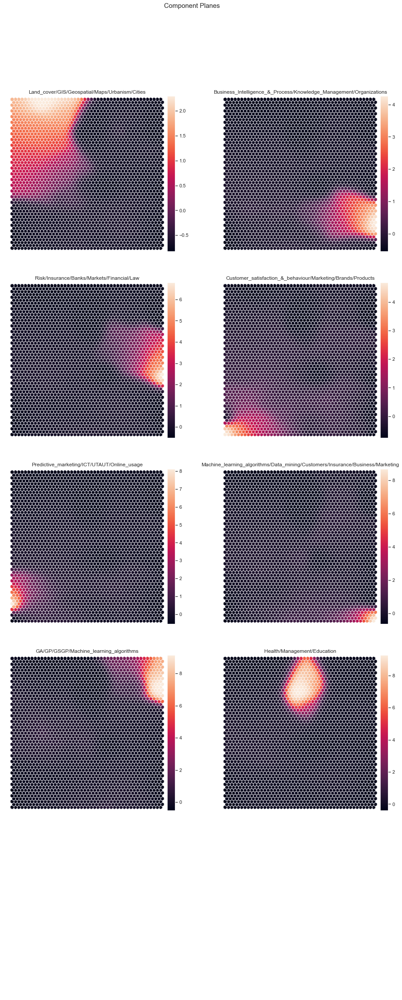

In [128]:
# component_planes Bert
component_planes(sm_bert, "bert_cp_")

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88ACE4730>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88ACE4730> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88DF3AB50>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88DF3AB50> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88A892880>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88A892880> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88AC4AA00>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C88AC4AA00> on colorbar
Setting pcolormesh
locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889234400>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator o

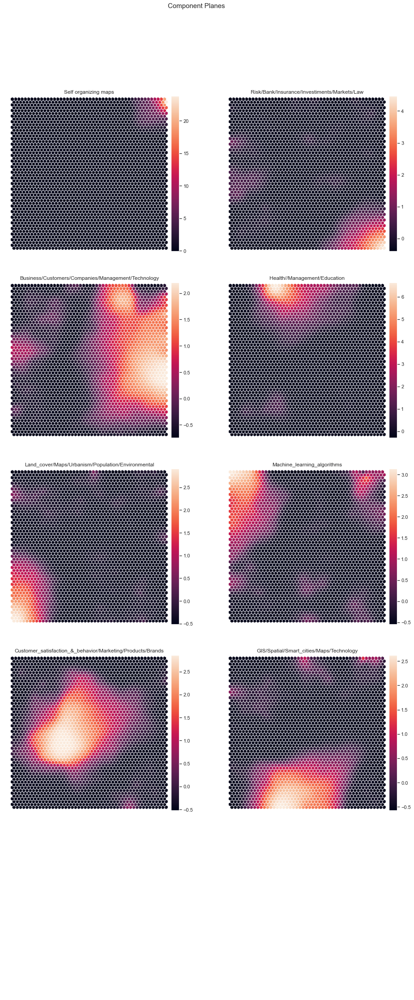

In [130]:
# component_planes LDA
component_planes(sm_lda, "lda_cp_")

** **
#### 4.4 U-matrix
[Back to TOC](#toc)
** **
Encode each neuron in the output space with the **average distance** to its neighbors in the input space.

Analyse these plots from the following perspectives:
- Clusters of units
- Pontential outliers (units which are very distant from its neighbors and have low frequency)

In [284]:
def u_matrix(som_trained_model):
    # Here you have U-matrix
    u = sompy.umatrix.UMatrixView(14, 46, 'umatrix', show_axis=True, text_size=8, show_text=True)
    UMAT = u.show(
    som_trained_model, 
    distance2=1, 
    row_normalized=False, 
    show_data=True, 
    contooor=True, # Visualize isomorphic curves
    blob=False)

top of axes not in the figure, so title not moved


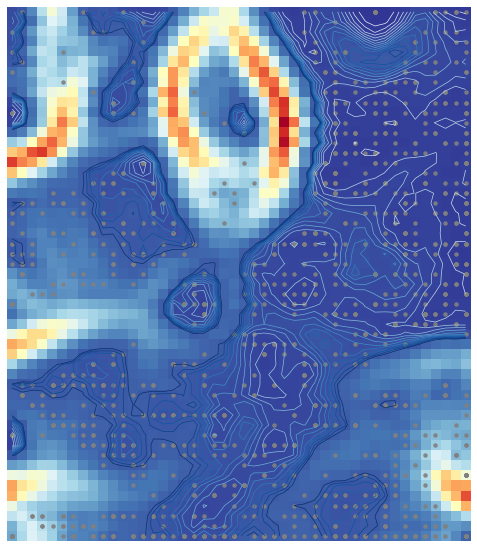

In [285]:
# u_matrix Bert
u_matrix(sm_bert)

top of axes not in the figure, so title not moved


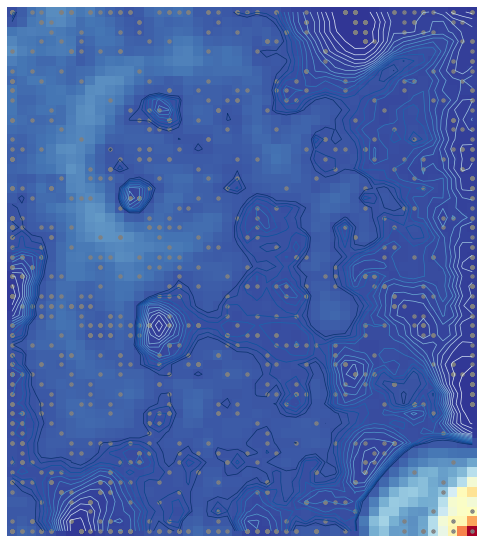

In [286]:
# u_matrix LDA
u_matrix(sm_lda)

In [ ]:
# u_matrix LDA
u_matrix(sm_bert_lda)

In [ ]:
# u_matrix LDA
u_matrix(sm)

In [ ]:
sm.build_data_labels()

** **
#### 4.5 Hit-map
[Back to TOC](#toc)
** **
Show the **frequency** of each Unit in the output map

In [57]:
def hit_map(som_trained_model):
    vhts  = BmuHitsView(30,20,"Hits Map")
    vhts.show(som_trained_model, anotate=True, onlyzeros=False, labelsize=10, cmap="Blues")
    plt.show()

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000019CE37E4580>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000019CE37E4580> on colorbar
Setting pcolormesh


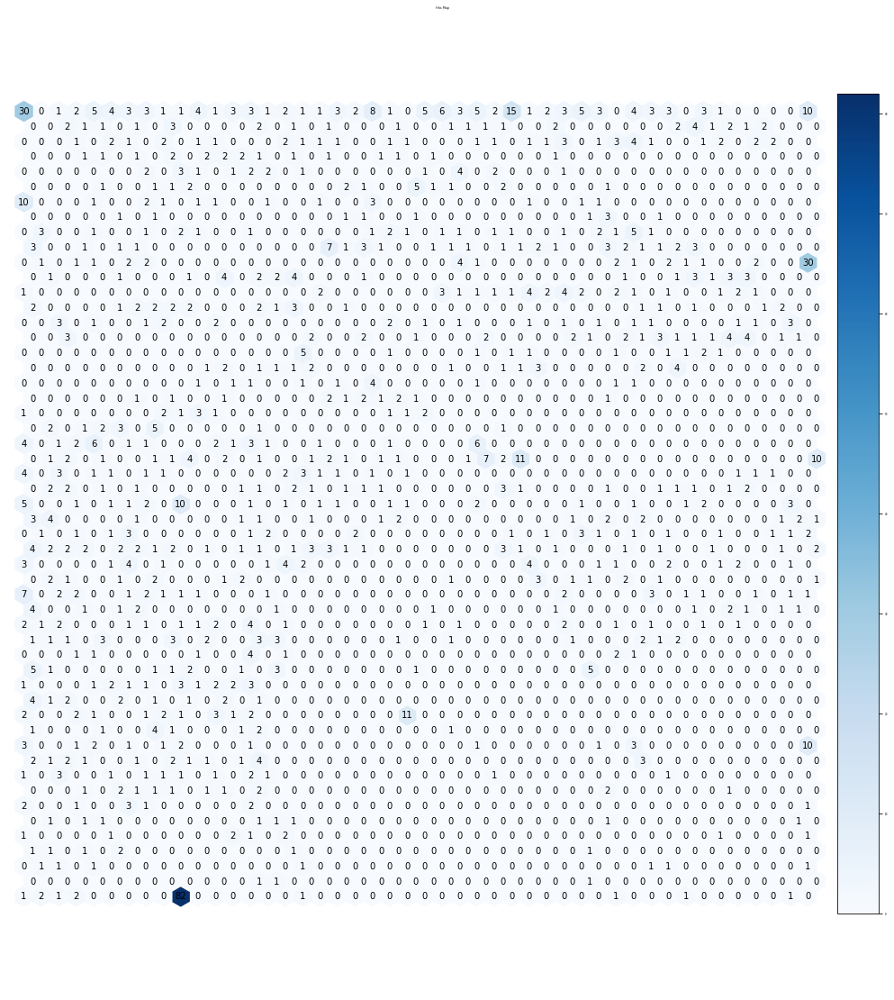

In [60]:
# hit_map Bert
hit_map(sm_bert)

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000019CF495A6D0>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x0000019CF495A6D0> on colorbar
Setting pcolormesh


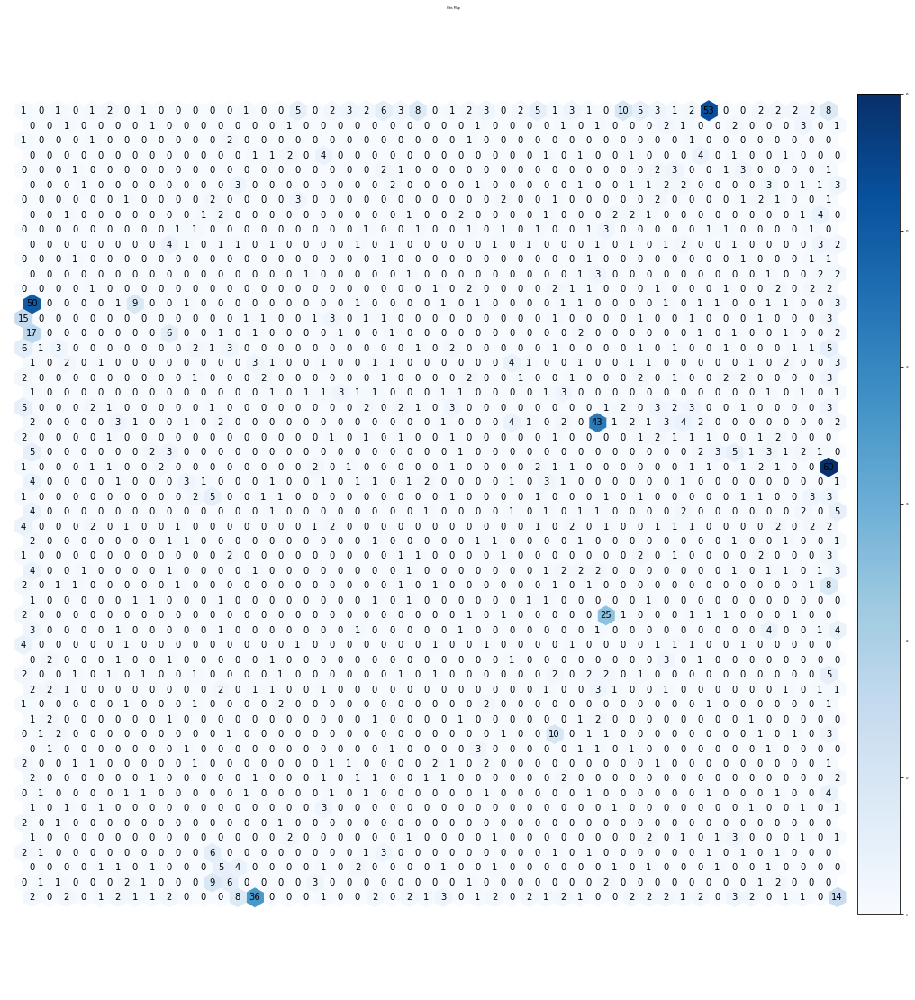

In [61]:
# hit_map LDA
hit_map(sm_lda)

In [ ]:
# hit_map Bert
hit_map(sm_bert_lda)

In [ ]:
# hit_map Bert
hit_map(sm)

** **
#### 4.6 Clustering with SOMs:
[Back to TOC](#toc)
** **
- **Ward on top of SOM units (BERT_Vector)** 
- **Ward on top of SOM units (LDA_Vector)** 

In [70]:
# Getting the BMU
bert_BMU=pd.DataFrame(sm_bert.get_node_vectors())
lda_BMU=pd.DataFrame(sm_lda.get_node_vectors())
var_dendo=[0,1,2,3,4,5,6,7]

In [135]:
# Adding empty label names to plot
lda_BMU["label_names"] = ''
bert_BMU["label_names"] = ''
#fig = ff.create_dendrogram(X, orientation='left', labels=names)

## Bert Dendrogram 

In [148]:
# Ploting the dendrogram from berttopic
from scipy.cluster.hierarchy import linkage
import plotly.figure_factory as ff
np.random.seed(1)


figure = ff.create_dendrogram(
    bert_BMU[var_dendo], orientation='bottom', labels=list(bert_BMU["label_names"]), color_threshold=0, colorscale=[
                "rgb(0,116,217)",  # blue
            ],
    linkagefun=lambda x: linkage(bert_BMU[var_dendo], 'ward', metric='euclidean', optimal_ordering=True)
)


######################################################################################################################################################
# Change background color 
figure.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})

# Add horizontal line.
figure.add_hline(y=8, line_width=3, line_dash="dash", line_color="grey")

figure.update_layout(width=1100, height=800)
pio.write_image(figure, 'Bert Dendrogram.png', format='png', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(figure, 'Bert Dendrogram.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
figure.show()

## Lda Dendrogram 

In [149]:
# Ploting the dendrogram from berttopic
from scipy.cluster.hierarchy import linkage
import plotly.figure_factory as ff
np.random.seed(1)


figure = ff.create_dendrogram(
    lda_BMU[var_dendo], orientation='bottom', labels=list(lda_BMU["label_names"]),color_threshold=0, colorscale=[
                "rgb(255,65,54)",  # red
            ],
    linkagefun=lambda x: linkage(lda_BMU[var_dendo], 'ward', metric='euclidean', optimal_ordering=True)
)


######################################################################################################################################################
# Change background color 
figure.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})



# Add horizontal line.
figure.add_hline(y=9, line_width=3, line_dash="dash", line_color="grey")

figure.update_layout(width=1100, height=800)
pio.write_image(figure, 'lda Dendrogram.png', format='png', width=950, height=550, scale=20, engine="kaleido")
pio.write_image(figure, 'lda Dendrogram.pdf', format='pdf', width=950, height=550, scale=20, engine="kaleido")
figure.show()

## Perform ward clustering on top of SOM Lda

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889F40850>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C889F40850> on colorbar
Setting pcolormesh
Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.
top of axes not in the figure, so title not moved


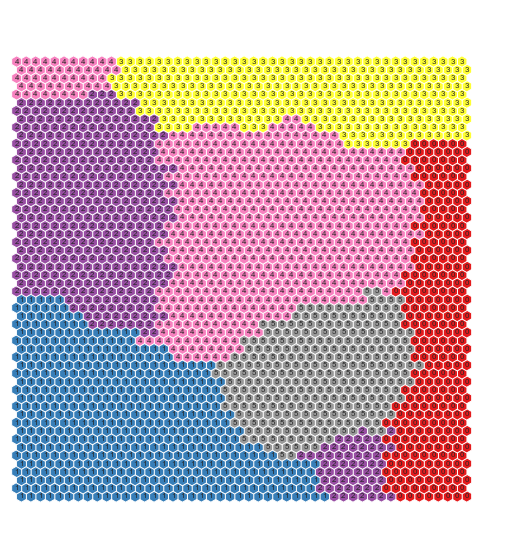

In [165]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust_lda = AgglomerativeClustering(n_clusters=6, linkage='ward',)

# Perform ward clustering on top of SOM
nodeclus_labels = sm_lda.cluster(hierclust_lda)

# Get cluster labels for each observation
data_labels_lda = np.array([nodeclus_labels[int(k)] for k in sm_lda._bmu[0]])
df_thesis_topics["cluster_label_ward"]=data_labels_lda

hits  = HitMapView(10, 10,"",text_size=10)
hits.show(sm_lda, anotate=True, onlyzeros=False, labelsize=8, cmap="Set1")

plt.savefig(os.path.join("{}.png".format("lda_hip_map")), dpi=500)
plt.savefig(os.path.join("{}.pdf".format("lda_hip_map")), dpi=500)

plt.show()

## Counting number of theses in each cluster (LDA-vectors)


In [ ]:
lda_vars_pro1=["thesis_id",'cluster_label_ward']

In [ ]:
counts_lda = df_thesis_topics[lda_vars_pro1].groupby(by='cluster_label_ward',).count()#.#iloc[:,[0,1]]
counts_lda

In [ ]:
# imports
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go

# data
d = {'Scenario': ["Cluster 5","Cluster 1", "Cluster 0","Cluster 3","Cluster 2", "Cluster 4"],
     'Type': ["Cluster 5","Cluster 1", "Cluster 0","Cluster 3","Cluster 2", "Cluster 4"],
     'VAL_1': [113, 232, 246, 248, 252, 261],
    }
dfq = pd.DataFrame(data=d)

# assign colors to type using a dictionary
colors = {"Cluster 4":'#e935a1',
          "Cluster 5":'#eeeeee',
         "Cluster 3":"#ffff33",
         "Cluster 0":'#e41a1c',
         "Cluster 2":'#984ea3',
         "Cluster 1":'#4053d3'}

# plotly figure
fig=go.Figure()
for t in dfq['Type'].unique():
    dfp = dfq[dfq['Type']==t]
    fig.add_traces(go.Bar(x=dfp['Scenario'], y = dfp['VAL_1'], name=t,
                         marker_color=colors[t], text = dfp['VAL_1']))

    
# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')




# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})
fig.update_yaxes(
     title_text = "Number of thesis", 
     title_font=dict(size=16, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=16))#family='Calibri'  

fig.update_xaxes(
     title_text = "", 
     title_font=dict(size=16, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=16))

# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=20))


pio.write_image(fig, 'N_clusters_lda.png', format='png', width=650, height=450, scale=20, engine="kaleido")
pio.write_image(fig, 'N_clusters_lda.pdf', format='pdf', width=650, height=450, scale=20, engine="kaleido")

fig.show()

## Average topic weigth in each cluster (LDA-vectors)

In [166]:
lda_vars_pro=['Self organizing maps',
 'Risk/Bank/Insurance/Investiments/Markets/Law',
 'Business/Customers/Companies/Management/Technology',
 'Health//Management/Education',
 'Land_cover/Maps/Urbanism/Population/Environmental',
 'Machine_learning_algorithms',
 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
 'GIS/Spatial/Smart_cities/Maps/Technology','cluster_label_ward']

In [170]:
centroids_lda = df_thesis_topics[lda_vars_pro].groupby(by='cluster_label_ward', as_index=False).mean()
centroids_lda["cluster_label_ward"]=["Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3","Cluster 4", "Cluster 5"]
centroids_lda

,cluster_label_ward,Self organizing maps,Risk/Bank/Insurance/Investiments/Markets/Law,Business/Customers/Companies/Management/Technology,Health//Management/Education,Land_cover/Maps/Urbanism/Population/Environmental,Machine_learning_algorithms,Customer_satisfaction_&_behavior/Marketing/Products/Brands,GIS/Spatial/Smart_cities/Maps/Technology
0,Cluster 0,NaN,0.125028,0.179595,0.496647,0.747176,0.179641,0.197080,0.273967
1,Cluster 1,NaN,0.107936,0.358907,0.161009,0.125235,0.143439,0.730205,0.127731
2,Cluster 2,0.028407,0.146730,0.849456,0.226732,0.167675,0.158997,0.103124,0.164153
3,Cluster 3,NaN,0.132214,0.262344,0.107404,0.161447,0.149380,0.157727,0.761642
4,Cluster 4,0.113288,0.175039,0.283287,0.115933,0.276139,0.626485,0.156000,0.258899
5,Cluster 5,0.021525,0.661887,0.293944,0.103090,0.182160,0.197554,0.205062,0.163793


In [452]:
centroids_lda.rename(columns = {'Land_cover/Maps/Urbanism/Populations/Environmental':'Land_cover/Maps/Urbanism/Population/Environmental'}, inplace = True)

Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


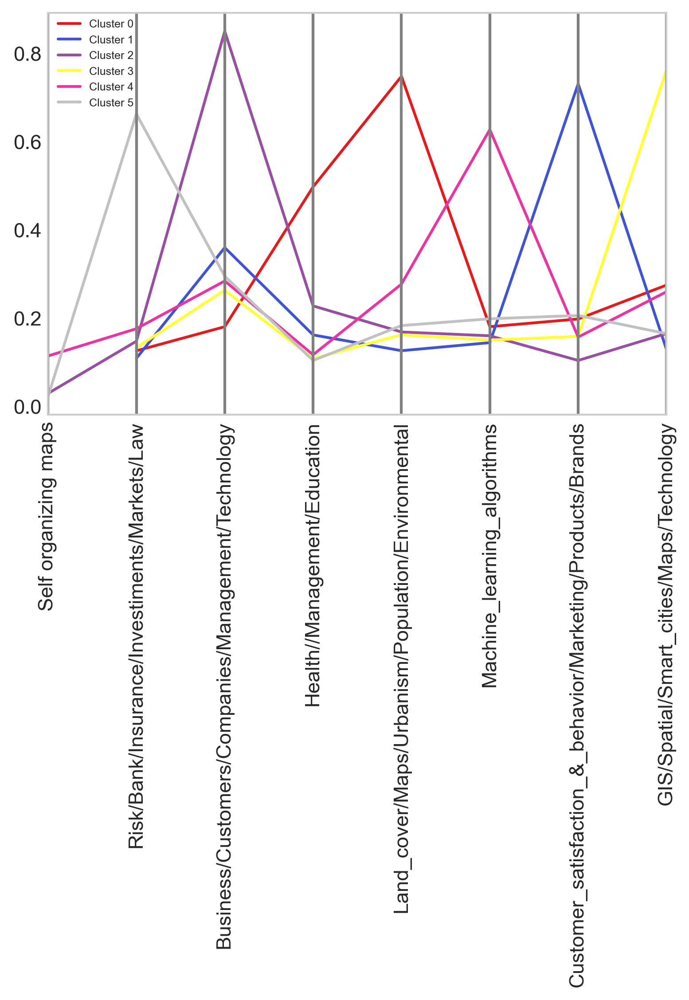

In [296]:
with plt.style.context(("seaborn-whitegrid")):
    fig = plt.figure(figsize=(6,4), dpi=300)
    pd.plotting.parallel_coordinates(centroids_lda, "cluster_label_ward",
                                     color=['#e41a1c','#4053d3','#984ea3',"#ffff33", '#e935a1','#C1C1C1' ],
                                     alpha=1,
                                     #sort_labels=True,
                                     #colormap=sns.color_palette("husl", 9),
                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 6}

    plt.rcParams.update(params)
    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    plt.title("")
    plt.savefig(os.path.join("{}.png".format("cluster_pro_lda_parellel_coordinates")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("cluster_pro_lda_parellel_coordinates")), dpi=500)

## Counting number of theses in each cluster by Specialization (LDA-vectors)

In [173]:
clustering_lda = pd.pivot_table(data=df_thesis_topics,
                                  index=['Specialization_retificado','cluster_label_ward'],
                                  values="thesis_id",
                                  aggfunc=['count'],
                                  margins=False,
                                  margins_name='Grand Total').unstack(-1, fill_value=0).T
clustering_lda.reset_index(inplace=True)
clustering_lda["cluster_label_ward"]=["Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3","Cluster 4","Cluster 5"]
clustering_lda.drop(['level_0', 'level_1'], axis = 1, inplace=True)
clustering_lda

Specialization_retificado,cluster_label_ward,Clinical Research Management,Data Science and Advanced Analytics,Geographic Information Systems and Science,Geospatial Technologies,Information Analysis and Management,Information Systems and Technologies Management,Knowledge Management and Business Intelligence,Law and Financial Markets,Marketing Intelligence,Marketing Research and CRM,Risk Analysis and Management,Statistics and Information Management
0,Cluster 0,16,4,68,91,20,3,15,0,4,4,0,21
1,Cluster 1,0,6,0,0,13,38,35,0,71,43,3,23
2,Cluster 2,2,24,1,0,9,89,75,0,14,6,10,22
3,Cluster 3,0,7,66,111,0,17,26,0,1,1,0,19
4,Cluster 4,0,64,13,70,15,9,52,0,0,4,17,17
5,Cluster 5,0,0,0,1,16,3,5,30,1,3,46,8


Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


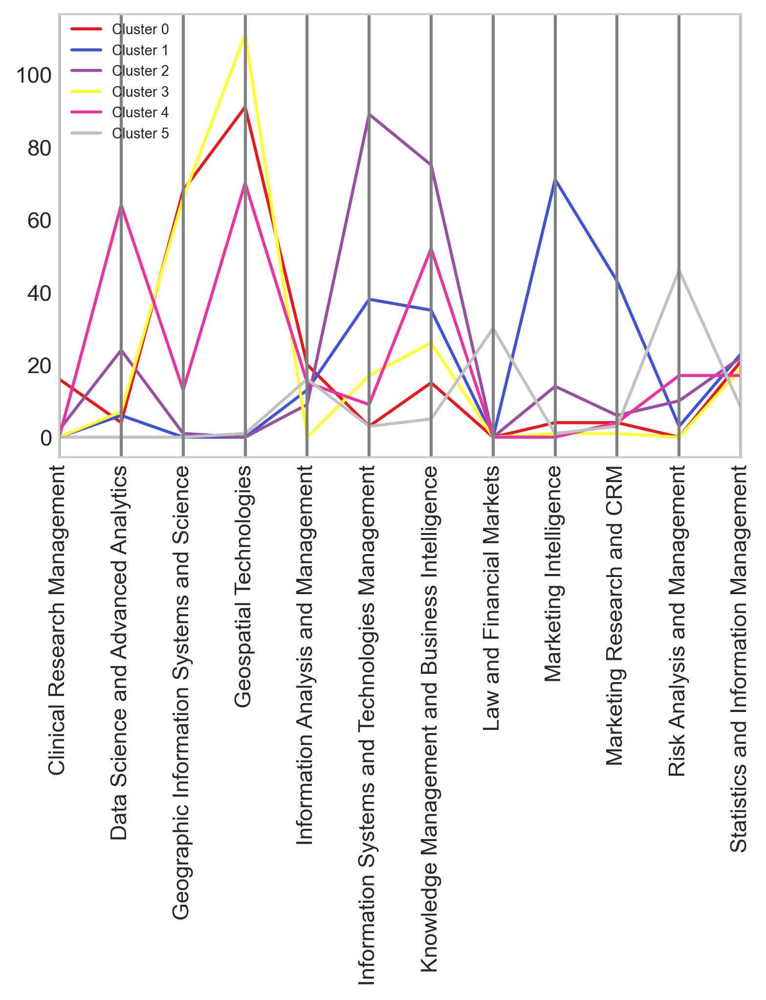

In [287]:
with plt.style.context(("seaborn-whitegrid")):
    fig = plt.figure(figsize=(6,4), dpi=300)
    pd.plotting.parallel_coordinates(clustering_lda, "cluster_label_ward",
                                     color=['#e41a1c','#4053d3','#984ea3',"#ffff33", '#e935a1','#C1C1C1' ],
                                     alpha=1,
                                     #sort_labels=True,
                                     #colormap=sns.color_palette("husl", 9),
                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 7}

    plt.rcParams.update(params)
    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    plt.title("")
    plt.savefig(os.path.join("{}.png".format("cluster_pro_lda_teses_parellel_coordinates")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("cluster_pro_lda_teses_parellel_coordinates")), dpi=500)

* **
#### 4.6.1 Perform ward clustering on top of SOM BERTopic (BERT_Vector)

In [181]:
bert_vars_pro=['Land_cover/GIS/Geospatial/Maps/Urbanism/Cities',
  'Business_Intelligence_&_Process/Knowledge_Management/Organizations',
  'Risk/Insurance/Banks/Markets/Financial/Law',
  'Customer_satisfaction_&_behaviour/Marketing/Brands/Products',
  'Predictive_marketing/ICT/UTAUT/Online_usage',
  'Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing',
  'GA/GP/GSGP/Machine_learning_algorithms',
  'Health/Management/Education', 'cluster_label_ward']

locator: <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C8899C0130>
Using auto colorbar locator <matplotlib.colorbar._ColorbarAutoLocator object at 0x000001C8899C0130> on colorbar
Setting pcolormesh
Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.
top of axes not in the figure, so title not moved


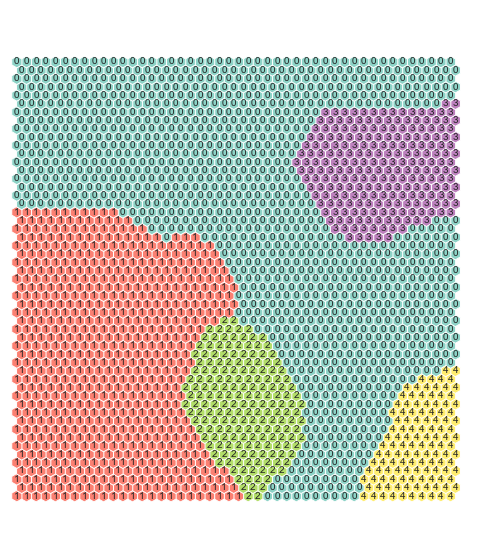

In [180]:
# Perform Hierarchical clustering on top of the 2500 untis (sm.get_node_vectors() output)
hierclust = AgglomerativeClustering(n_clusters=5, linkage='ward',)

# Perform ward clustering on top of SOM
nodeclus_labels = sm_bert.cluster(hierclust)

# Get cluster labels for each observation
data_labels = np.array([nodeclus_labels[int(k)] for k in sm_bert._bmu[0]])
x_bert["cluster_label_ward"]=data_labels

hits  = HitMapView(10, 10,"",text_size=10)
hits.show(sm_bert, anotate=True, onlyzeros=False, labelsize=10, cmap="Set3")

plt.savefig(os.path.join("{}.png".format("bert_hip_map")), dpi=500)
plt.savefig(os.path.join("{}.pdf".format("bert_hip_map")), dpi=500)

plt.show()

## Counting number of theses in each cluster (BERTopic-vectors)

In [182]:
counts_bert = x_bert[bert_vars_pro].groupby(by='cluster_label_ward', as_index=False).count().iloc[:,[0,1]]
counts_bert

,cluster_label_ward,Land_cover/GIS/Geospatial/Maps/Urbanism/Cities
0,0,644
1,1,515
2,2,20
3,3,153
4,4,20


In [183]:
# imports
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go

# data
d = {'Scenario': ["Cluster 4", "Cluster 2","Cluster 3","Cluster 1", "Cluster 0"],
     'Type': ["Cluster 4", "Cluster 2","Cluster 3","Cluster 1", "Cluster 0"],
     'VAL_1': [20, 20, 153, 515 ,644],
    }
dfq = pd.DataFrame(data=d)

# assign colors to type using a dictionary
colors = {"Cluster 4":'#ffff99',
          "Cluster 2":'#4daf4a',
         "Cluster 3":"#984ea3",
         "Cluster 1":'#fb8072',
         "Cluster 0":'#8dd3c7',}

# plotly figure
fig=go.Figure()
for t in dfq['Type'].unique():
    dfp = dfq[dfq['Type']==t]
    fig.add_traces(go.Bar(x=dfp['Scenario'], y = dfp['VAL_1'], name=t,
                         marker_color=colors[t], text = dfp['VAL_1']))

    
# Change grid color and axis colors
fig.update_xaxes(showline=True, linewidth=1, linecolor='black', gridcolor='white')
fig.update_yaxes(showline=True, linewidth=1, linecolor='black', gridcolor='grey')

# Change background color 
fig.update_layout({
"plot_bgcolor": "rgba(0, 0, 0, 0)",
"paper_bgcolor": "rgba(0, 0, 0, 0)",
})
fig.update_yaxes(
     title_text = "Number of thesis", 
     title_font=dict(size=16, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=16))#family='Calibri'  

fig.update_xaxes(
     title_text = "", 
     title_font=dict(size=16, color='black'),#, family='Verdana'
     tickfont=dict(color='black', size=16))

# Hide the legend
fig.update_layout(showlegend=False)
fig.update_annotations(font=dict( size=20))


pio.write_image(fig, 'N_clusters_bert.png', format='png', width=650, height=450, scale=20, engine="kaleido")
pio.write_image(fig, 'N_clusters_bert.pdf', format='pdf', width=650, height=450, scale=20, engine="kaleido")

fig.show()

## Average topic weigth in each cluster (BERTopic-vectors)

In [184]:
centroids_bert = x_bert[bert_vars_pro].groupby(by='cluster_label_ward', as_index=False).mean()
centroids_bert["cluster_label_ward"]=["Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3","Cluster 4"]
centroids_bert

,cluster_label_ward,Land_cover/GIS/Geospatial/Maps/Urbanism/Cities,Business_Intelligence_&_Process/Knowledge_Management/Organizations,Risk/Insurance/Banks/Markets/Financial/Law,Customer_satisfaction_&_behaviour/Marketing/Brands/Products,Predictive_marketing/ICT/UTAUT/Online_usage,Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing,GA/GP/GSGP/Machine_learning_algorithms,Health/Management/Education
0,Cluster 0,0.040299,0.052559,0.105838,0.209064,0.085173,0.096462,0.039933,0.025202
1,Cluster 1,0.631715,0.037245,0.033876,0.072117,0.034243,0.040104,0.048904,0.036053
2,Cluster 2,0.007428,0.007711,0.005189,0.012923,0.006964,0.005376,0.004394,0.831694
3,Cluster 3,0.037215,0.640580,0.034462,0.082104,0.039526,0.052373,0.032886,0.026556
4,Cluster 4,0.010278,0.009211,0.009550,0.014889,0.006501,0.015627,0.823917,0.005508


Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


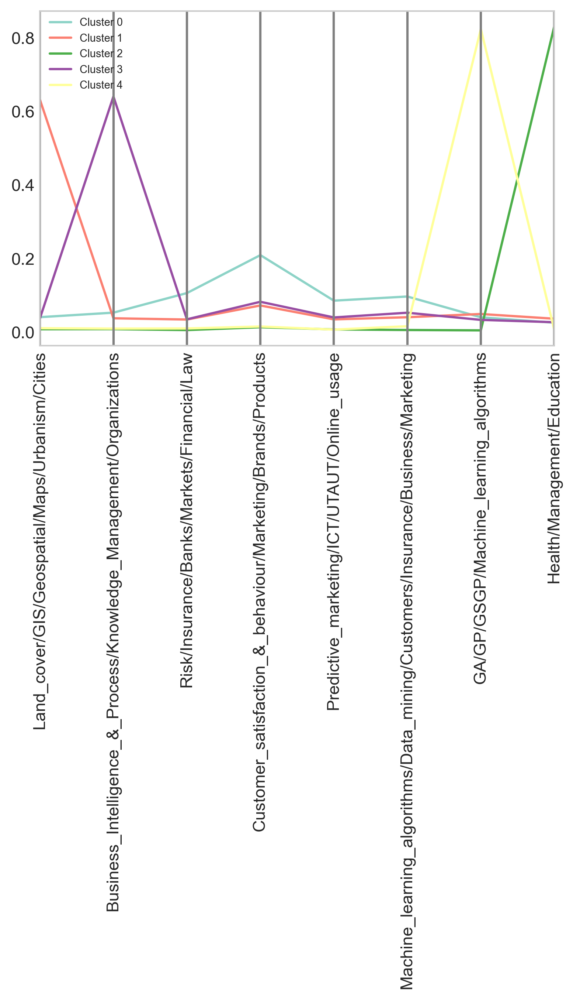

In [186]:
with plt.style.context(("seaborn-whitegrid")):
    fig = plt.figure(figsize=(6,4), dpi=300)
    pd.plotting.parallel_coordinates(centroids_bert, "cluster_label_ward",
                                     color=["#8dd3c7",'#fb8072','#4daf4a',"#984ea3", "#ffff99"],
                                     alpha=1,
                                     #sort_labels=True,
                                     #colormap=sns.color_palette("husl", 9),
                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 7}

    plt.rcParams.update(params)
    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    plt.savefig(os.path.join("{}.png".format("cluster_pro_bert_parellel_coordinates")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("cluster_pro_bert_parellel_coordinates")), dpi=500)
    plt.title("")

## Counting number of theses in each cluster by Specialization (BERTopic-vectors)

In [187]:
clustering_bert = pd.pivot_table(data=x_bert,
                                  index=['Specialization_retificado','cluster_label_ward'],
                                  values="thesis_id",
                                  aggfunc=['count'],
                                  margins=False,
                                  margins_name='Grand Total').unstack(-1, fill_value=0).T
clustering_bert.reset_index(inplace=True)
clustering_bert["cluster_label_ward"]=["Cluster 0", "Cluster 1", "Cluster 2", "Cluster 3","Cluster 4"]
clustering_bert.drop(['level_0', 'level_1'], axis = 1, inplace=True)
clustering_bert

Specialization_retificado,cluster_label_ward,Clinical Research Management,Data Science and Advanced Analytics,Geographic Information Systems and Science,Geospatial Technologies,Information Analysis and Management,Information Systems and Technologies Management,Knowledge Management and Business Intelligence,Law and Financial Markets,Marketing Intelligence,Marketing Research and CRM,Risk Analysis and Management,Statistics and Information Management
0,Cluster 0,0,73,2,6,55,73,135,30,80,58,73,59
1,Cluster 1,0,10,146,267,16,16,23,0,3,1,1,32
2,Cluster 2,18,0,0,0,0,0,1,0,1,0,0,0
3,Cluster 3,0,7,0,0,2,68,46,0,7,2,2,19
4,Cluster 4,0,15,0,0,0,2,3,0,0,0,0,0


Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


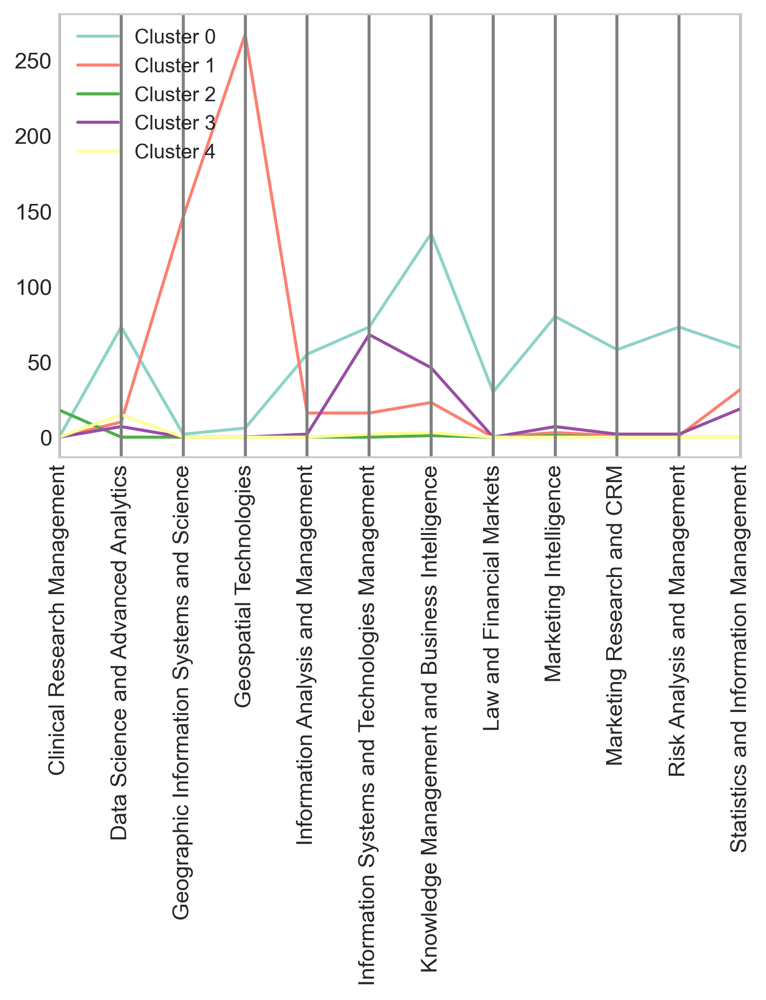

In [193]:
with plt.style.context(("seaborn-whitegrid")):
    fig = plt.figure(figsize=(6,4), dpi=300)
    pd.plotting.parallel_coordinates(clustering_bert, "cluster_label_ward",
                                     color=["#8dd3c7",'#fb8072','#4daf4a',"#984ea3", "#ffff99"],
                                     alpha=1,
                                     #sort_labels=True,
                                     #colormap=sns.color_palette("husl", 9),
                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 10}

    plt.rcParams.update(params)
    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    plt.savefig(os.path.join("{}.png".format("cluster_pro_bert_teses_parellel_coordinates")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("cluster_pro_bert_teses_parellel_coordinates")), dpi=500)
    plt.title("")

** **
# <font color='#E8800A'>V. Network analysis</font> <a class="anchor" id="fifth-bullet"></a>
[Back to TOC](#toc)
** **

**Analyse and visualize relationships and connections between theses**

![Preprocess Image](./images/network.gif)

In [214]:
# Basic data manipulation and visualisation libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import glob

# Network Libraries
import networkx as nx
from nxviz import CircosPlot
import nxviz as nv
from nxviz import utils

from tqdm.notebook import tqdm_notebook,tnrange,tqdm

** **
#### 5.1 Preparing the dataframe (BERT&LDA)
[Back to TOC](#toc)
** **

In [215]:
# Vector of topics
variables_bert= list(Topic_names_bert.values())#['Topic 0', 'Topic 1', 'Topic 2', 'Topic 3', 'Topic 4', 'Topic 5', 'Topic 6', 'Topic 7', 'Topic 8', 'Topic 9']
variables_lda= list(Topic_names.values())

In [216]:
variables_lda

['Self organizing maps',
 'Risk/Bank/Insurance/Investiments/Markets/Law',
 'Business/Customers/Companies/Management/Technology',
 'Health//Management/Education',
 'Land_cover/Maps/Urbanism/Population/Environmental',
 'Machine_learning_algorithms',
 'Customer_satisfaction_&_behavior/Marketing/Products/Brands',
 'GIS/Spatial/Smart_cities/Maps/Technology']

In [218]:
# This function is going to recive the dataframe with the topics and pick the selected number of best topics and return\
# a dictionary of each thesis and the topics with respective weight 
def best_topics(dataframe, number_of_topics, list_topics):    

    """Pick the selected best number of topics for each these .

    Args:
        dataframe: The data frame with topics (after applying Topic Modeling).
        number_of_topics: Number of best topics that you want select in each thesis
        list_topics: List of all the topics after applying Topic Modeling
        
    Returns:
        thesis dictionary: A dictionary of each thesis and the selected number of best topics with respective weight.
        The key of the dictionary is the ID of the thesis        
    """
    
    dictionary_thesis = {} #Creating a empty dictionary to save each thesis and the best number of topics selected
    for thesis_id in tqdm(list(dataframe[list_topics].index)): 
        dictionary_thesis[thesis_id] = \
        pd.DataFrame(dataframe[list_topics].iloc[thesis_id].sort_values(ascending=False)[:number_of_topics])
    return dictionary_thesis

In [270]:
# Lets pick the two most important topics in each thesis (BERT/LDA)
dictionary_thesis_bert=best_topics(x_bert,3, variables_bert)
dictionary_thesis_lda=best_topics(df_thesis_topics,3, variables_lda)

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

## Full topics

In [219]:
# Lets pick the all the topics for calculate the metrics in each thesis (BERT/LDA)
dictionary_thesis_bert_full=best_topics(x_bert,9, variables_bert)
dictionary_thesis_lda_full=best_topics(df_thesis_topics,9, variables_lda)

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

In [221]:
# This function is going to recive a dictionary of thesis and the selected number of best topics with respective weight on each thesis and return a DF

def dictionary_to_data_frame(dictionary):
    
    """Transform a dictionary to a dataframe .

    Args:
        dataframe: The data frame with topics (after applying Topic Modeling).
        number_of_topics: Number of best topics that you want select in each thesis
        list_topics: List of all the topics after applying Topic Modeling
        
    Returns:
        Dataframe of the selected number of best topics with respective weight on each thesis       
    """
    
    top_topics_df = pd.DataFrame() # Create an empty dataframe, this will be your final dataframe

    
    for thesis_id, sub_df in tqdm(dictionary.items()):
        columns_name = {'thesis_id': list(dictionary.keys())[sub_df.keys().values[0]],\
                       "top_topics":list(pd.DataFrame(dictionary[thesis_id]).index),\
                        'weight': pd.DataFrame(dictionary[thesis_id])[sub_df.keys().values[0]]}
        temporary_dataframe=pd.DataFrame(data=columns_name)
        top_topics_df = pd.concat([top_topics_df,temporary_dataframe], axis=0)
        
    return top_topics_df

In [271]:
top_topics_df_bert=dictionary_to_data_frame(dictionary_thesis_bert).fillna(0)
top_topics_df_lda=dictionary_to_data_frame(dictionary_thesis_lda).fillna(0)

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

## Full

In [222]:
full_topics_df_bert=dictionary_to_data_frame(dictionary_thesis_bert_full).fillna(0)
full_topics_df_lda=dictionary_to_data_frame(dictionary_thesis_lda_full).fillna(0)

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

In [226]:
def average_amount_topical_coherence (data_frame_with_best_topics, thesis_id_column, weight_column):
    
    """Calculate the average amount of all topical coherence explained by selected number of topics.

    Args:
        data_frame_with_best_topics: Dataframe of the selected number of best topics with respective weight on each thesis.
        thesis_id_column: Name of the column with the id of the thesis
        weight_column: Name of the column with the weight of topics
            
    Returns:
        The average amount of all topical coherence explained by selected number of topics.
        Plot with the distribution of the total topical coherence explained by selected number of topics
       
    """

    sum_topics_thesis= data_frame_with_best_topics.fillna(0).groupby([thesis_id_column])[weight_column].sum()
    mean_sum_topics= sum_topics_thesis.mean()
    number_of_topics= data_frame_with_best_topics.fillna(0).groupby([thesis_id_column])[weight_column].count()[0]
    print(f"The average amount of all topical coherence explained when you select {number_of_topics} best topics on each thesis is = {mean_sum_topics}")
    
    # Ploting the distribution of the total topical coherence explained by selected number of topics 
    #sum_topics_thesis.hist(column='sum of topical coherence explained by selected number of topics')
    sum_topics_thesis.plot.hist(alpha=0.7)
    plt.show()

The average amount of all topical coherence explained when you select 3 best topics on each thesis is = 0.633540277173077


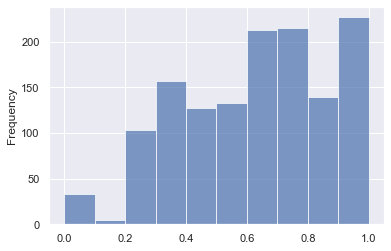

The average amount of all topical coherence explained when you select 3 best topics on each thesis is = 0.9809068518047348


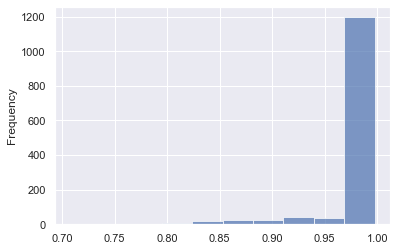

In [273]:
average_amount_topical_coherence (top_topics_df_bert, 'thesis_id', "weight")
average_amount_topical_coherence (top_topics_df_lda, 'thesis_id', "weight")

## Full

The average amount of all topical coherence explained when you select 8 best topics on each thesis is = 0.8009578720273668


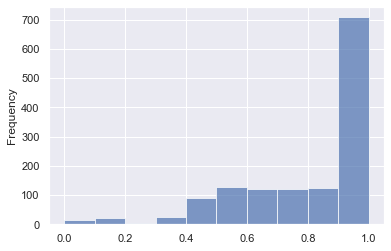

The average amount of all topical coherence explained when you select 8 best topics on each thesis is = 0.9923005369171608


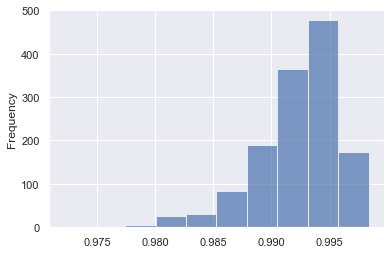

In [227]:
average_amount_topical_coherence (full_topics_df_bert, 'thesis_id', "weight")
average_amount_topical_coherence (full_topics_df_lda, 'thesis_id', "weight")

** **
#### 5.2 Creating a Graph
[Back to TOC](#toc)
** **

In [274]:
# Transpose thesis to columns
def transpose_thesis_to_columns(data_frame_with_best_topics, top_topics_columns, thesis_id_column):
    thesis_to_columns= pd.pivot_table(data_frame_with_best_topics,  index = top_topics_columns, columns = thesis_id_column).\
    reset_index().fillna(0).rename_axis(axis="columns").set_index(top_topics_columns)
    return thesis_to_columns

In [275]:
transpose_thesis_bert=transpose_thesis_to_columns(top_topics_df_bert, "top_topics", 'thesis_id')
transpose_thesis_lda=transpose_thesis_to_columns(top_topics_df_lda, "top_topics", 'thesis_id')

In [276]:
transpose_thesis_bert=transpose_thesis_bert.round(decimals = 7)

In [277]:
transpose_thesis_lda=transpose_thesis_lda.round(decimals = 7)

## Full

In [229]:
transpose_thesis_bert_full=transpose_thesis_to_columns(full_topics_df_bert, "top_topics", 'thesis_id')
transpose_thesis_lda_full=transpose_thesis_to_columns(full_topics_df_lda, "top_topics", 'thesis_id')

In [232]:
transpose_thesis_bert_full_=transpose_thesis_bert_full.round(decimals = 7)

In [237]:
transpose_thesis_lda_full_=transpose_thesis_lda_full.round(decimals = 7)

In [235]:
# Creating a sparse matrix
def transpose_to_sparse_matrix(transpose_thesis_to_columns_dataframe, data_frame_orig, thesis_id):
    #     """Calculate the average amount of all topical coherence explained by selected number of topics.

#     Args:
#         data_frame_with_best_topics: The data frame with topics (after applying Topic Modeling).
#         number_of_topics: Number of best topics that you want select in each thesis
#         thesis_id_column: List of all the topics after applying Topic Modeling
#         weight_column:
#         number_of_topics
            
#     Returns:
#         thesis dictionary: A dictionary of each thesis and the selected number of best topics with respective weight.
#         The key of the dictionary is the ID of the thesis        
#     """

# 1st:
    thesis_id_=[] #Creat empty list to save the id of the thesis
    for i in tqdm(range(0, len(transpose_thesis_to_columns_dataframe.columns))):
        b=transpose_thesis_to_columns_dataframe.columns[i][1]
        id_=data_frame_orig[thesis_id][b]
        thesis_id_.append(id_)  
    thesis_id_

# 2nd
    import scipy.sparse as sp
    columns_name = transpose_thesis_to_columns_dataframe.columns
    matrix = sp.csr_matrix(transpose_thesis_to_columns_dataframe.astype(float).values)
    

    sparse_matrix = matrix.T * matrix  # multiply sparse matrix
    sparse_matrix.setdiag(0)  # reset diagonal

    # create dataframe from co-occurence matrix in dense format
    sparse_matrix_data_frame = pd.DataFrame(sparse_matrix.todense(), index=columns_name, columns=columns_name)


# 3rd
    sparse_matrix_df=pd.DataFrame(np.tril(sparse_matrix_data_frame, k=0))
    sparse_matrix_df.columns= list(thesis_id_)
    sparse_matrix_df.index= list(thesis_id_)
        
    return sparse_matrix_df

In [278]:
sparse_matrix_bert=transpose_to_sparse_matrix(transpose_thesis_bert, x_bert, "thesis_id")
sparse_matrix_lda=transpose_to_sparse_matrix(transpose_thesis_lda, df_thesis_topics, "thesis_id")

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

## Full

In [238]:
sparse_matrix_bert_full=transpose_to_sparse_matrix(transpose_thesis_bert_full_, x_bert, "thesis_id")
sparse_matrix_lda_full=transpose_to_sparse_matrix(transpose_thesis_lda_full_, df_thesis_topics, "thesis_id")

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

In [249]:
# Sparse matrix to Graph
def dataframe_to_graph(sparse_matrix_df_):
    unstack_df=sparse_matrix_df_.unstack().reset_index()
    unstack_df.columns = ['source', 'target', 'weight']
    unstack_connected_df = unstack_df[unstack_df['weight'] != 0]  # remove non-connected nodes
    G = nx.from_pandas_edgelist(unstack_connected_df, source='source', target='target', edge_attr='weight')
    return G

In [279]:
G_bert=dataframe_to_graph(sparse_matrix_bert)
G_lda=dataframe_to_graph(sparse_matrix_lda)

In [280]:
density_G_bert = nx.density(G_bert)
density_G_lda = nx.density(G_lda)
print("Network bert density:", density_G_bert)
print("Network lda density:", density_G_lda)

Network bert density: 0.84959653633399
Network lda density: 0.5735922108979103


## Full

In [250]:
G_bert_full=dataframe_to_graph(sparse_matrix_bert_full)
G_lda_full=dataframe_to_graph(sparse_matrix_lda_full)

In [251]:
density_G_bert_full = nx.density(G_bert_full)
density_G_lda_full = nx.density(G_lda_full)
print("Network bert density:", density_G_bert_full)
print("Network lda density:", density_G_lda_full)

Network bert density: 0.9843044286397987
Network lda density: 0.6028593765740039


In [ ]:
#nx.write_edgelist(G_lda, "test.edgelist.gz", data=True)

** **
#### 5.3 Computing the centralities measures
[Back to TOC](#toc)
** **

In [247]:
# Compute centralities measures
def compute_centralities(Graph_name, weight_name):
    
# degree/strength
    # Computation of nodal degree/strength
    strength = Graph_name.degree(weight=weight_name)
    # Now we add the degree/strength value as an attribute to the nodes
    nx.set_node_attributes(Graph_name, dict(strength), 'strength')
    
    # Normalized node strength values 1/N-1
    normstrenghts = {node: val * 1/(len(Graph_name.nodes)-1) for (node, val) in tqdm(strength)}
    # Now we add the Normalized node strength value as an attribute to the nodes
    nx.set_node_attributes(Graph_name, normstrenghts, 'strengthnorm')
    
# Closeness centrality
    # The function accepts a argument 'distance' that, in correlation-based networks, must be seen as the inverse ... asdsa
    # of the weight value. Thus, a high correlation value (e.g., 0.8) means a shorter distance (i.e., 0.2).sadsadasdsadsa
    G_distance_dict = {(e1, e2): 1 / abs(weight) for e1, e2, weight in tqdm(Graph_name.edges(data=weight_name))}
    
    # Now we add the closeness centrality value as an attribute to the edges
    nx.set_edge_attributes(Graph_name, G_distance_dict, 'distance')
    
    # Computation of Closeness Centrality
    closeness = nx.closeness_centrality(Graph_name, distance='distance')
    
    # Now we add the closeness centrality value as an attribute to the nodes
    nx.set_node_attributes(Graph_name, closeness, 'closeness centrality')

# Betweenness centrality:
    # Computation of Betweenness centrality
    betweenness = nx.betweenness_centrality(Graph_name, weight='distance', normalized=True)
    
    # Now we add the betweenness centrality value as an attribute to the nodes
    nx.set_node_attributes(Graph_name, betweenness, 'betweenness centrality')

# Eigenvector centrality
    # Computation of Eigenvector centrality
    eigen = nx.eigenvector_centrality(Graph_name, weight=weight_name)
    
    # Now we add the Eigenvector centrality value as an attribute to the nodes
    nx.set_node_attributes(Graph_name, eigen, 'eigenvector centrality')

# Returning the graph with all the centralities 
    return Graph_name  

In [283]:
# Calculating the Centralite measures
G_centralities_measures_bert=compute_centralities(G_bert, 'weight')
G_centralities_measures_lda=compute_centralities(G_lda, 'weight')

  0%|          | 0/1341 [00:00<?, ?it/s]

  0%|          | 0/763337 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/523848 [00:00<?, ?it/s]

## Full

In [252]:
# Calculating the Centralite measures
G_centralities_measures_bert_full=compute_centralities(G_bert_full, 'weight')
G_centralities_measures_lda_full=compute_centralities(G_lda_full, 'weight')

  0%|          | 0/1341 [00:00<?, ?it/s]

  0%|          | 0/884368 [00:00<?, ?it/s]

  0%|          | 0/1352 [00:00<?, ?it/s]

  0%|          | 0/550577 [00:00<?, ?it/s]

In [318]:
# Passing the measures to dataframe
centralities_df_bert = utils.node_table(G_centralities_measures_bert)
centralities_df_lda = utils.node_table(G_centralities_measures_lda)
#centralities_df_lda.head(-5)

## Full

In [253]:
# Passing the measures to dataframe
centralities_df_bert_full = utils.node_table(G_centralities_measures_bert_full)
centralities_df_lda_full = utils.node_table(G_centralities_measures_lda_full)
#centralities_df_lda.head(-5)

In [255]:
centralities_df_bert_full.to_csv('centralities_df_bert_full.csv', index=True)
centralities_df_bert_full

,strength,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality
58592,290.695658,0.216937,0.091439,0.000000,0.047542
13946,150.376549,0.112221,0.074465,0.000314,0.007018
58594,48.822049,0.036434,0.044922,0.000000,0.004076
66297,74.211731,0.055382,0.062104,0.000000,0.005263
74318,65.960830,0.049225,0.052455,0.000000,0.005239
...,...,...,...,...,...
63148,87.695406,0.065444,0.058602,0.000000,0.005023
94328,88.466273,0.066020,0.058579,0.000000,0.005142
51673,87.852034,0.065561,0.057992,0.000000,0.005292
28326_,83.075585,0.061997,0.057159,0.000000,0.004965


In [321]:
centralities_df_lda.to_csv('centralities_df_lda.csv', index=True)
centralities_df_lda

,strength,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality
58592,231.499310,0.171354,0.236994,0.000000,0.016385
13946,292.712674,0.216664,0.229371,0.000002,0.041936
58594,180.826497,0.133846,0.195811,0.000000,0.009938
66297,191.378397,0.141657,0.237061,0.000000,0.011322
94550,227.314888,0.168257,0.219732,0.000000,0.022483
...,...,...,...,...,...
114784,50.955020,0.037717,0.208895,0.005341,0.002508
110481,50.872418,0.037655,0.208738,0.000000,0.002504
115618,50.907743,0.037682,0.208805,0.000000,0.002506
110486,50.824822,0.037620,0.208647,0.000000,0.002501


## Full

In [256]:
centralities_df_lda_full.to_csv('centralities_df_lda_full.csv', index=True)
centralities_df_lda_full

,strength,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality
58592,232.601712,0.172170,0.237298,0.000000,0.016699
13946,294.630861,0.218084,0.230026,0.000002,0.041569
58594,182.856307,0.135349,0.196279,0.000000,0.010453
66297,192.766697,0.142684,0.237353,0.000000,0.011778
94550,228.795762,0.169353,0.220071,0.000000,0.022628
...,...,...,...,...,...
114784,52.565630,0.038909,0.209202,0.004364,0.002696
110481,52.480366,0.038846,0.209044,0.000000,0.002692
115618,52.516829,0.038873,0.209112,0.000000,0.002693
110486,52.431235,0.038809,0.208953,0.000000,0.002689


In [322]:
G_centralities_measures_bert

In [323]:
nx.write_graphml_lxml(G_lda, "G_lda.graphml",)

In [324]:
nx.write_graphml_lxml(G_bert, "G_bert.graphml",)

## Full

In [ ]:
nx.write_graphml_lxml(G_bert_full, "G_bert_full.graphml",)

In [ ]:
nx.write_graphml_lxml(G_lda_full, "G_lda_full.graphml",)

In [ ]:
2 in list(x_bert["thesis_id"].value_counts())

** **
#### 5.4 Analysing the centralities measures by specialization, cluster and dominant topic
[Back to TOC](#toc)
** **

In [327]:
# First we have to concatenate the dataframes
# Creating a copy of the original dataframe
bert_clus_centra= x_bert.copy()
lda_clus_centra= df_thesis_topics.copy()

# Set a thesis_id as the index
bert_clus_centra.set_index("thesis_id", drop=True, inplace=True)
lda_clus_centra.set_index("thesis_id", drop=True, inplace=True)

# Concatenate the dataframes
bert_clus_centra = pd.concat((bert_clus_centra, centralities_df_bert), axis=1)
lda_clus_centra = pd.concat((lda_clus_centra, centralities_df_lda), axis=1)

In [328]:
lda_clus_centra["Cluster label"]=['Cluster 0' if v == 0 else 'Cluster 1' if v == 1 else 'Cluster 2' if v==2 else 'Cluster 3' if v==3 else 'Cluster 4' if v==4 else 'Cluster 5' for v in list(lda_clus_centra["cluster_label_ward"])]

In [329]:
lda_clus_centra["color"]=['#e41a1c' if v == 0 else '#4053d3' if v == 1 else '#984ea3'if v==2 else "#ffff33" if v==3 else '#e935a1' if v==4 else '#C1C1C1' for v in list(lda_clus_centra["cluster_label_ward"])]

In [330]:
lda_clus_centra.to_csv('Nodes_lda.csv', index=True)

In [331]:
lda_clus_centra=pd.read_csv('Nodes_lda.csv')

In [332]:
lda_clus_centra.head(1)

,Unnamed: 0,Unnamed: 0.1,Unnamed: 0.1.1,Column1,collection_id,Nome-apelido,Author_email,Advisor_bom_1,Advisor_bom_2,Advisor_bom_3,Coorientador(es)_bom_3,Date_issued,Rights,Date_embargo,Embargo_info,title,Type_thesis,Language,Thesis_url,Specialization_retificado,Abstract_en,year_thesis,n_tokens,n_unique_tokens,proportion_unique_tokens,flesch_reading_ease,dependency_distance_mean,abstract_reading_time,wordcloud_abstract,pre_abstract_trigams,abstract_trigams,Dominant Topic,Contribution %,Topic Terms,Machine_learning_algorithms,GIS/Spatial/Smart_cities/Maps/Technology,Business/Customers/Companies/Management/Technology,Customer_satisfaction_&_behavior/Marketing/Products/Brands,Risk/Bank/Insurance/Investiments/Markets/Law,Land_cover/Maps/Urbanism/Population/Environmental,Health//Management/Education,Self organizing maps,cluster_label_ward,strength,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality,Cluster label,color
0,58592,0,0,0.0,10362/2160,Evandro da Silva Mendonça,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,20/12/2018,openAccess,NaN,NaN,Genetic algorithm for waste collection in smart cities : case of Campolide,Work project,eng,http://hdl.handle.net/10362/57146,Knowledge Management and Business Intelligence,"Smarts cities are becoming an important concept in the cities, it tries to discover methods to interact with the environment in sustainable ways inside urban areas. This concept emerged to deal with the growing urbanization faced by the cities around the globe. Within problems brought by the urbanization, waste management is one of the hardest and most impactful. The collection stage of the wa...",2018,196,110,0.561224,52.046071,2.633487,14.56,smarts cities important concept cities tries discover methods interact environment sustainable ways inside urban areas concept emerged deal growing urbanization faced cities globe problems brought urbanization waste management hardest impactful collection stage waste management costliest route planning garbage trucks known hard problem project genetic algorithm proposed deal waste collection r...,"['smart', 'city', 'important', 'concept', 'city', 'try', 'discover', 'method', 'interact', 'environment', 'sustainable', 'way', 'inside', 'urban', 'area', 'concept', 'emerge', 'deal', 'grow', 'urbanization', 'face', 'city', 'globe', 'problem', 'bring', 'urbanization', 'waste', 'management', 'hard', 'impactful', 'collection', 'stage', 'waste', 'management', 'costly', 'route', 'planning', 'garba...","['smart', 'city', 'important', 'concept', 'city', 'try', 'discover', 'method', 'interact', 'environment', 'sustainable', 'way', 'inside', 'urban_area', 'concept', 'emerge', 'deal', 'grow', 'urbanization', 'face', 'city', 'globe', 'problem', 'bring', 'urbanization', 'waste', 'management', 'hard', 'impactful', 'collection', 'stage', 'waste', 'management', 'costly', 'route', 'planning', 'garbage'...",7,0.911934,"datum, information, system, spatial, user, application, service, web, base, develop, gis, use, city, map, technology, tool, public, study, development, model, result, allow, analysis, provide, different",0.079734,0.911922,NaN,NaN,NaN,NaN,NaN,NaN,3,231.49931,0.171354,0.236994,0.0,0.016385,Cluster 3,#ffff33


In [333]:
bert_clus_centra["Cluster label"]=['Cluster 0' if v == 0 else 'Cluster 1' if v == 1 else 'Cluster 2' if v==2 else 'Cluster 3' if v==3 else 'Cluster 4' for v in list(bert_clus_centra["cluster_label_ward"])]

In [ ]:
colors = {"Cluster 4":'#ffff99',
          "Cluster 2":'#4daf4a',
         "Cluster 3":"#984ea3",
         "Cluster 1":'#fb8072',
         "Cluster 0":'#8dd3c7',}

In [334]:
bert_clus_centra["color"]=['#8dd3c7' if v == 0 else '#fb8072' if v == 1 else '#4daf4a' if v==2 else "#984ea3" if v==3 else '#ffff99' for v in list(bert_clus_centra["cluster_label_ward"])]

In [335]:
bert_clus_centra.to_csv('Nodes_bert.csv', index=True)

In [336]:
bert_clus_centra=pd.read_csv('Nodes_bert.csv')
bert_clus_centra.head(2)

,Unnamed: 0,Column1,collection_id,Nome-apelido,Author_email,Advisor_bom_1,Advisor_bom_2,Advisor_bom_3,Coorientador(es)_bom_3,Date_issued,Rights,Date_embargo,Embargo_info,title,Type_thesis,Language,Thesis_url,Specialization_retificado,Abstract_en,year_thesis,wordcloud_abstract,pre_abstract_trigams,Land_cover/GIS/Geospatial/Maps/Urbanism/Cities,Business_Intelligence_&_Process/Knowledge_Management/Organizations,Risk/Insurance/Banks/Markets/Financial/Law,Customer_satisfaction_&_behaviour/Marketing/Brands/Products,Predictive_marketing/ICT/UTAUT/Online_usage,Machine_learning_algorithms/Data_mining/Customers/Insurance/Business/Marketing,GA/GP/GSGP/Machine_learning_algorithms,Health/Management/Education,cluster_label_ward,strength,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality,Cluster label,color
0,58592,0.0,10362/2160,Evandro da Silva Mendonça,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,20/12/2018,openAccess,NaN,NaN,Genetic algorithm for waste collection in smart cities : case of Campolide,Work project,eng,http://hdl.handle.net/10362/57146,Knowledge Management and Business Intelligence,"Smarts cities are becoming an important concept in the cities, it tries to discover methods to interact with the environment in sustainable ways inside urban areas. This concept emerged to deal with the growing urbanization faced by the cities around the globe. Within problems brought by the urbanization, waste management is one of the hardest and most impactful. The collection stage of the wa...",2018,smarts cities important concept cities tries discover methods interact environment sustainable ways inside urban areas concept emerged deal growing urbanization faced cities globe problems brought urbanization waste management hardest impactful collection stage waste management costliest route planning garbage trucks known hard problem project genetic algorithm proposed deal waste collection r...,"['smart', 'city', 'important', 'concept', 'city', 'try', 'discover', 'method', 'interact', 'environment', 'sustainable', 'way', 'inside', 'urban', 'area', 'concept', 'emerge', 'deal', 'grow', 'urbanization', 'face', 'city', 'globe', 'problem', 'bring', 'urbanization', 'waste', 'management', 'hard', 'impactful', 'collection', 'stage', 'waste', 'management', 'costly', 'route', 'planning', 'garba...",0.74156,0.029747,0.024477,5.767704e-02,2.739290e-02,0.032503,0.032876,0.024531,1,258.055681,0.192579,0.084762,0.000000,0.048539,Cluster 1,#fb8072
1,13946,1.0,10362/2160,Sabrina Vieira Fialho,NaN,Miguel de Castro Simőes Ferreira Neto,NaN,NaN,NaN,29/07/2014,openAccess,NaN,NaN,"How enterprise 2,0 firms take advantage of emergent social software platforms to manage knowledge",Dissertation,eng,http://hdl.handle.net/10362/13755,Information Systems and Technologies Management,"This research aims to provide a better understanding on how firms stimulate knowledge sharing through the utilization of collaboration tools, in particular Emergent Social Software Platforms (ESSPs). It focuses on the distinctive applications of ESSPs and on the initiatives contributing to maximize its advantages. \nIn the first part of the research, I have itemized all types of existing colla...",2014,research aims provide better_understanding firms stimulate knowledge sharing utilization collaboration tools particular emergent social software platforms essps focuses distinctive applications essps initiatives contributing maximize advantages research itemized types existing collaboration tools classify different categories according capabilities objectives according faculty promoting knowle...,"['research', 'aim', 'provide', 'better understande', 'firm', 'stimulate', 'knowledge', 'sharing', 'utilization', 'collaboration', 'tool', 'particular', 'emergent', 'social', 'software', 'platform', 'essp', 'focus', 'distinctive', 'application', 'essp', 'initiative', 'contribute', 'maximize', 'advantage', 'research', 'itemized', 'type', 'exist', 'collaboration', 'tool'

## Full

In [257]:
# First we have to concatenate the dataframes
# Creating a copy of the original dataframe
bert_clus_centra_full= x_bert.copy()
lda_clus_centra_full= df_thesis_topics.copy()

# Set a thesis_id as the index
bert_clus_centra_full.set_index("thesis_id", drop=True, inplace=True)
lda_clus_centra_full.set_index("thesis_id", drop=True, inplace=True)

# Concatenate the dataframes
bert_clus_centra_full = pd.concat((bert_clus_centra_full, centralities_df_bert_full), axis=1)
lda_clus_centra_full = pd.concat((lda_clus_centra_full, centralities_df_lda_full), axis=1)

In [258]:
lda_clus_centra_full.to_csv('Nodes_lda_full.csv', index=True)
bert_clus_centra_full.to_csv('Nodes_bert_full.csv', index=True)

In [196]:
lda_clus_centra_full=pd.read_csv('Nodes_lda_full.csv')

In [197]:
bert_clus_centra_full=pd.read_csv('Nodes_bert_full.csv')

In [259]:
lda_clus_centra_full["Cluster label"]=['Cluster 0' if v == 0 else 'Cluster 1' if v == 1 else 'Cluster 2' if v==2 else 'Cluster 3' if v==3 else 'Cluster 4' if v==4 else 'Cluster 5' for v in list(lda_clus_centra_full["cluster_label_ward"])]

In [260]:
bert_clus_centra_full["Cluster label"]=['Cluster 0' if v == 0 else 'Cluster 1' if v == 1 else 'Cluster 2' if v==2 else 'Cluster 3' if v==3 else 'Cluster 4' for v in list(bert_clus_centra_full["cluster_label_ward"])]

****
#### 5.4.1 Centrality measures by cluster
[Back to TOC](#toc)
****

In [261]:
#list of measures
filter_=["strengthnorm", "closeness centrality", "betweenness centrality", "eigenvector centrality",  'cluster_label_ward']#"page Rank",
list_measures=["strengthnorm", "closeness centrality", "betweenness centrality", "eigenvector centrality"]#, "page Rank"

In [263]:
#list of measures
filter_list=["strengthnorm", "closeness centrality", "betweenness centrality", "eigenvector centrality",  "Cluster label"]#"page Rank",
filter_list_1=["strengthnorm", "closeness centrality", "betweenness centrality", "eigenvector centrality", "Specialization_retificado"]

In [203]:
bert_clus_centra_full.index

RangeIndex(start=0, stop=1352, step=1)

In [262]:
round(bert_clus_centra_full.filter(filter_list).groupby(["Cluster label"]).mean(),4)#.T

,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality
Cluster label,,,,
Cluster 0,0.0685,0.0669,0.0009,0.0067
Cluster 1,0.1935,0.0911,0.0003,0.0411
Cluster 2,0.0400,0.0460,0.0006,0.0037
Cluster 3,0.1044,0.0752,0.0005,0.0085
Cluster 4,0.0522,0.0612,0.0015,0.0050


In [264]:
round(bert_clus_centra_full.filter(filter_).groupby(["cluster_label_ward"]).mean(),4)#.T

,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality
cluster_label_ward,,,,
0,0.0685,0.0669,0.0009,0.0067
1,0.1935,0.0911,0.0003,0.0411
2,0.0400,0.0460,0.0006,0.0037
3,0.1044,0.0752,0.0005,0.0085
4,0.0522,0.0612,0.0015,0.0050


In [265]:
centrality_bert_cluster_full=round(bert_clus_centra_full.filter(filter_list).groupby(["Cluster label"]).mean(),4)
#centrality_bert_cluster_full["Centralite measures"]=["Strengthnorm", "Closeness", "Betweenness", "Eigenvector"]
centrality_bert_cluster_full.columns
centrality_bert_cluster_full["cluster_label_ward"]=centrality_bert_cluster_full.index
centrality_bert_cluster_full

,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality,cluster_label_ward
Cluster label,,,,,
Cluster 0,0.0685,0.0669,0.0009,0.0067,Cluster 0
Cluster 1,0.1935,0.0911,0.0003,0.0411,Cluster 1
Cluster 2,0.0400,0.0460,0.0006,0.0037,Cluster 2
Cluster 3,0.1044,0.0752,0.0005,0.0085,Cluster 3
Cluster 4,0.0522,0.0612,0.0015,0.0050,Cluster 4


Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


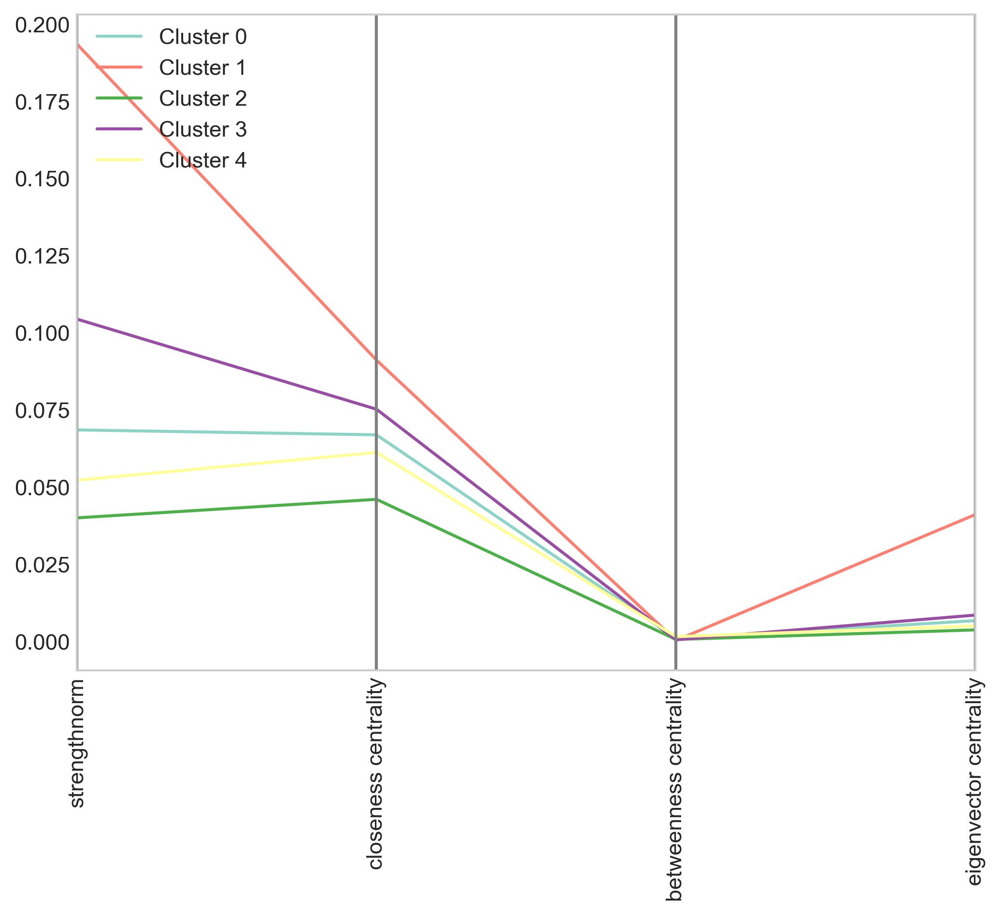

In [266]:
with plt.style.context(("seaborn-whitegrid")):#seaborn-white
    fig = plt.figure(figsize=(8,6), dpi=300)
    pd.plotting.parallel_coordinates(centrality_bert_cluster_full, "cluster_label_ward",
                                     color=["#8dd3c7",'#fb8072','#4daf4a',"#984ea3", "#ffff99"],
                                     alpha=1,

                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )

    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 2}
    
    plt.savefig(os.path.join("{}.png".format("central_cluster_bert")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("central_cluster_bert")), dpi=500)

    plt.rcParams.update(params)
    plt.title("")

In [268]:
centrality_lda_cluster_full=round(lda_clus_centra_full.filter(filter_list).groupby(['Cluster label']).mean(),4)
#centrality_lda_cluster_full["Centralite measures"]=["Strengthnorm", "Closeness", "Betweenness", "Eigenvector"]
centrality_lda_cluster_full["cluster_label_ward"]=centrality_lda_cluster_full.index
centrality_lda_cluster_full#.columns

,strengthnorm,closeness centrality,betweenness centrality,eigenvector centrality,cluster_label_ward
Cluster label,,,,,
Cluster 0,0.1354,0.2112,0.0008,0.0110,Cluster 0
Cluster 1,0.1659,0.2202,0.0004,0.0227,Cluster 1
Cluster 2,0.2281,0.2540,0.0002,0.0481,Cluster 2
Cluster 3,0.1759,0.2258,0.0006,0.0201,Cluster 3
Cluster 4,0.1528,0.2090,0.0008,0.0164,Cluster 4
Cluster 5,0.1176,0.1944,0.0008,0.0154,Cluster 5


Assigning font /b'F1' = 'C:\\Windows\\Fonts\\arial.ttf'
Embedding font C:\Windows\Fonts\arial.ttf.
Writing TrueType font.


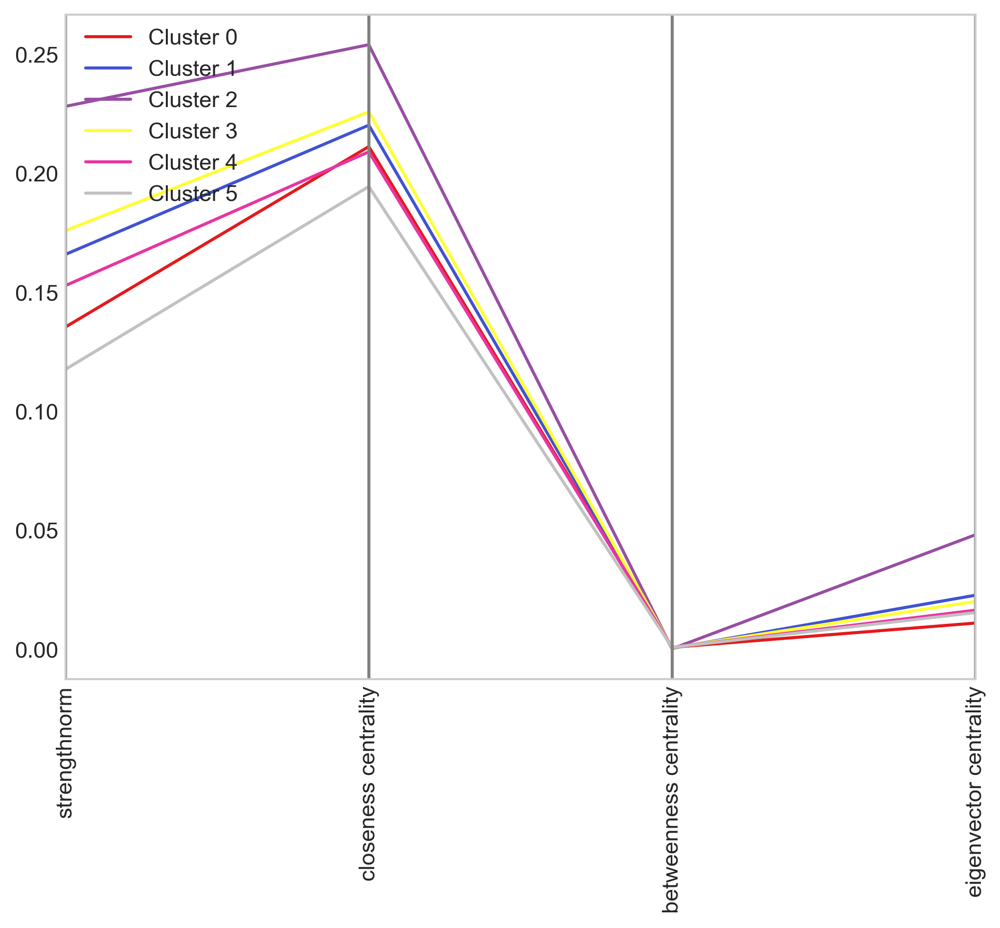

In [269]:
with plt.style.context(("seaborn-whitegrid")):
    fig = plt.figure(figsize=(8,6), dpi=300)
    pd.plotting.parallel_coordinates(centrality_lda_cluster_full, "cluster_label_ward",
                                     color=['#e41a1c','#4053d3','#984ea3',"#ffff33", '#e935a1','#C1C1C1' ],
                                     alpha=1,
                                     #sort_labels=True,
                                     #colormap=sns.color_palette("husl", 9),
                                     axvlines_kwds={"color":"grey"},
                                     axvlines=True
                                    )
    plt.legend(loc='upper left', bbox_to_anchor=(0.0000000,1.009))#'center left')
    plt.xticks(rotation=90)
    params = {'axes.labelsize': 20,
              'axes.titlesize': 25,
              'xtick.labelsize': 30,
              'ytick.labelsize': 30,
              'legend.fontsize': 2}

    plt.rcParams.update(params)
    plt.xticks(rotation=90)
    
    plt.savefig(os.path.join("{}.png".format("central_cluster_bert")), dpi=500)
    plt.savefig(os.path.join("{}.pdf".format("central_cluster_bert")), dpi=500)
    
    plt.title("")

** **
#### 5.5 Network graph
[Back to TOC](#toc)
** **

top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved
top of axes not in the figure, so title not moved


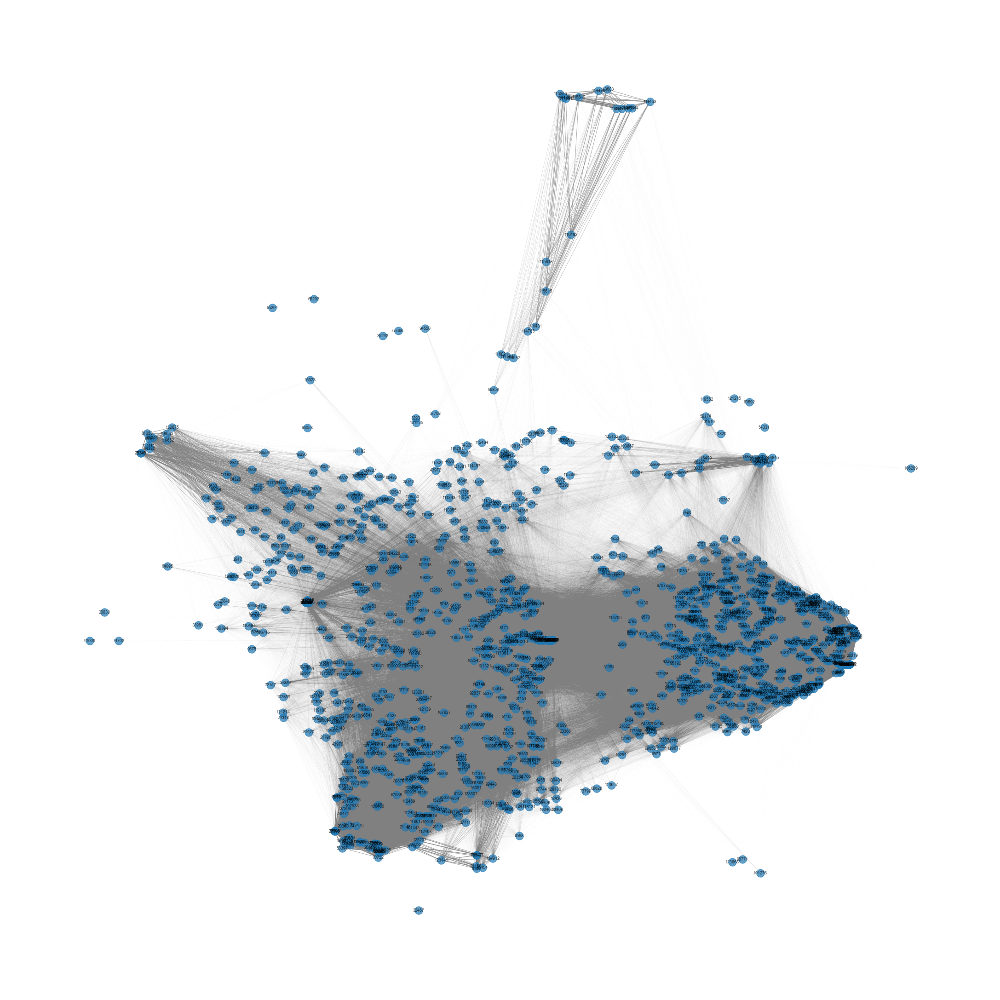

In [312]:
# 3
# Standard Network graph with nodes in proportion to Graph degrees
plt.figure(figsize=(30,30))
edgewidth = [ d['weight'] for (u,v,d) in G_bert.edges(data=True)]
pos = nx.spring_layout(G_bert, scale=5)
nx.draw(G_bert, pos, with_labels=True, width=np.power(edgewidth, 2), edge_color='grey', font_color='black', cmap=plt.cm.Spectral, alpha=0.7, font_size=9)

In [ ]:
# Standard Network graph with nodes in proportion to Graph degrees
plt.figure(figsize=(30,30))
edgewidth = [ d['weight'] for (u,v,d) in G_lda.edges(data=True)]
pos = nx.spring_layout(G_lda, scale=5)
nx.draw(G_lda, pos, with_labels=True, width=np.power(edgewidth, 2), edge_color='grey', font_color='black', cmap=plt.cm.Spectral, alpha=0.7, font_size=9)